# ESP design analysis

тетрадка для анализа расчетов

In [1]:
import pandas as pd

from plotly import graph_objects as go
from plotly.offline import plot

import matplotlib
import matplotlib.pyplot as plt

import numpy as np
import tqdm

import seaborn as sns

from numba import jit

from scipy import interpolate

import shapely
from shapely.geometry import LineString, Point
import os

from matplotlib.legend_handler import HandlerBase
plt.rcParams["figure.figsize"] = (15,10)

import json

import seaborn as sns
import glob, os

VBA_VERSION = '7.28'
import well_model
import mult

#font = {#'family' : 'normal',
#        #'weight' : 'bold',
#        'size'   : 15}

#matplotlib.rc('font', **font)

## Анализ результатов расчета (в т.ч. массового)

In [2]:

import UniflocVBA.v7_25.python_api as python_api_7_25
api = python_api_7_25.API("UniflocVBA/v7_25/UniflocVBA_7.xlam")

import UniflocVBA.v7_28.python_api as python_api_7_28
api_new = python_api_7_28.API("UniflocVBA/v7_28/UniflocVBA_7_28.xlam")
api_new.encode_PVT()

'{"gamma_gas":0.6,"gamma_oil":0.86,"gamma_wat":1,"rsb_m3m3":100,"t_res_C":-1,"PVT_corr_set":0}'

In [3]:
with open('ESP_json.db', 'r') as outfile:
    file = outfile
    db = json.load(outfile)

db_df = pd.DataFrame(db)
db_df = db_df.T  

In [4]:
print(os.getcwd())

path_to_dir = '.\calc_data' + '\\'


#data_path = 'calc_22_7_28'  # тестовый расчет
data_path =  'calc_27_7_28'  # месторождение X - высокая неопределенность
#data_path = 'calc_new_28_7_28_narrow'  # месторождение Y  - малая неопределенность

os.chdir(path_to_dir + data_path)

for file in glob.glob("*.csv"):
    print(file)    
files = [x for x in glob.glob("*.csv")]


dfs = []

for file_name in files:
    this_list = []
    
    file_name_splitted = file_name.split('_')
    this_id = int(file_name_splitted[-3])
    this_head = int(file_name_splitted[-1].replace('.csv', ''))
    this_name = api.ESP_name(this_id)
    this_list += [this_id, this_head, this_name]
    
    one_file = pd.read_csv(file_name, index_col = [0])
    one_file['this_id'] = this_id
    one_file['this_head'] = this_head
    one_file['this_name'] = this_name
    dfs.append(one_file.copy())

    
big_df = pd.concat(dfs)

big_df['super_id'] = big_df['this_name'].astype(str) + ' H = ' + big_df['this_head'].astype(str) + ' м'


os.chdir('..')
os.chdir('..')

big_df

C:\Git\esp_design
res_pump_thread_0_id_1185_head_2600.csv
res_pump_thread_0_id_1185_head_2800.csv
res_pump_thread_0_id_1185_head_3000.csv
res_pump_thread_0_id_226_head_2600.csv
res_pump_thread_0_id_226_head_2800.csv
res_pump_thread_0_id_226_head_3000.csv
res_pump_thread_2_id_1093_head_2600.csv
res_pump_thread_2_id_1093_head_2800.csv
res_pump_thread_2_id_1093_head_3000.csv
res_pump_thread_2_id_412_head_2600.csv
res_pump_thread_2_id_412_head_2800.csv
res_pump_thread_2_id_412_head_3000.csv
res_pump_thread_4_id_649_head_2600.csv
res_pump_thread_4_id_649_head_2800.csv
res_pump_thread_4_id_649_head_3000.csv
res_pump_thread_4_id_684_head_2600.csv
res_pump_thread_4_id_684_head_2800.csv
res_pump_thread_4_id_684_head_3000.csv
res_pump_thread_6_id_1111_head_2600.csv
res_pump_thread_6_id_1111_head_2800.csv
res_pump_thread_6_id_1111_head_3000.csv
res_pump_thread_6_id_1162_head_2600.csv
res_pump_thread_6_id_1162_head_2800.csv
res_pump_thread_6_id_1162_head_3000.csv
res_pump_thread_7_id_1258_head_260

,lh_mes,lhead_esp,leff,lpower_esp,lqliq,lstatus,lgas_fraction_intake,lp_bhp_atm,lp_esp_dis,lparams,simnumber,lp_esp_dis_by_tube,lq_mix_pump_mean,lesp_df,lcasing_pipe,ltube_pipe,this_id,this_head,this_name,super_id
195,2661,2485.394727,25.289681,63.606289,63.010629,1,22.136654,46.756237,226.177779,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",195,225.877404,74.522799,"{""0"":{""0"":226.17777864,""1"":""p_dis_atma"",""2"":""n...","[[38.72531525332741, 38.72531525332741, 85.715...","[[225.8774041196007, 15.0, 20.0, 225.877404119...",1185,2600,ЭЦН5-80,ЭЦН5-80 H = 2600 м
921,2661,2487.164919,25.551449,63.665839,63.673618,1,22.052392,46.879298,226.514421,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",921,225.842408,75.285166,"{""0"":{""0"":226.5144213676,""1"":""p_dis_atma"",""2"":...","[[38.853549231968195, 38.853549231968195, 85.7...","[[225.84240817244398, 15.0, 20.0, 225.84240817...",1185,2600,ЭЦН5-80,ЭЦН5-80 H = 2600 м
688,2661,2481.142849,26.919043,63.967069,67.542005,1,21.588860,47.565539,227.119444,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",688,225.633765,79.761529,"{""0"":{""0"":227.1194439293,""1"":""p_dis_atma"",""2"":...","[[39.569209886355125, 39.569209886355125, 85.7...","[[225.6337651335227, 15.0, 20.0, 225.633765133...",1185,2600,ЭЦН5-80,ЭЦН5-80 H = 2600 м
196,2661,2447.970847,28.101284,64.189337,71.685781,1,21.046456,48.401280,225.733770,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",196,225.411637,84.618121,"{""0"":{""0"":225.7337702941,""1"":""p_dis_atma"",""2"":...","[[40.42870139670554, 40.42870139670554, 85.764...","[[225.41163700923593, 15.0, 20.0, 225.41163700...",1185,2600,ЭЦН5-80,ЭЦН5-80 H = 2600 м
641,2661,1366.896518,28.219576,64.476922,125.938280,1,2.842696,108.639863,208.801905,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",641,208.741572,142.197775,"{""0"":{""0"":208.8019047517,""1"":""p_dis_atma"",""2"":...","[[99.60893902811796, 99.60893902811796, 85.816...","[[208.74157230449418, 15.0, 20.0, 208.74157230...",1185,2600,ЭЦН5-80,ЭЦН5-80 H = 2600 м
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
895,2661,2417.703678,32.399185,69.695273,90.144798,1,12.430094,66.848235,246.604672,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",895,222.261670,103.581083,"{""0"":{""0"":246.6046723881,""1"":""p_dis_atma"",""2"":...","[[58.456369107819704, 58.456369107819704, 85.8...","[[222.26166983863848, 15.0, 20.0, 222.26166983...",685,3000,AN550,AN550 H = 3000 м
631,2661,2439.261393,32.443165,69.794572,89.615254,1,12.594990,66.390909,247.781887,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",631,222.359083,102.997150,"{""0"":{""0"":247.7818867654,""1"":""p_dis_atma"",""2"":...","[[58.00737219739621, 58.00737219739621, 85.810...","[[222.35908333236918, 15.0, 20.0, 222.35908333...",685,3000,AN550,AN550 H = 3000 м
295,2661,2497.714463,32.468265,70.085239,88.003854,1,13.096018,65.034218,250.818997,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",295,222.652324,101.237642,"{""0"":{""0"":250.8189973036,""1"":""p_dis_atma"",""2"":...","[[56.67533519030902, 56.67533519030902, 85.807...","[[222.65232350264804, 15.0, 20.0, 222.65232350...",685,3000,AN550,AN550 H = 3000 м
852,2661,2448.496808,32.641836,69.819953,89.840007,1,12.445369,66.807397,249.032403,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",852,222.280737,103.175238,"{""0"":{""0"":249.0324034415,""1"":""p_dis_atma"",""2"":...","[[58.414377911637395, 58.414377911637395, 85.8...","[[222.28073729092927, 15.0, 20.0, 222.28073729...",685,3000,AN550,AN550 H = 3000 м


In [5]:
big_df.iloc[0]

lh_mes                                                               2661
lhead_esp                                                         2485.39
leff                                                              25.2897
lpower_esp                                                        63.6063
lqliq                                                             63.0106
lstatus                                                                 1
lgas_fraction_intake                                              22.1367
lp_bhp_atm                                                        46.7562
lp_esp_dis                                                        226.178
lparams                 {"gamma_gas": 0.7, "gamma_oil": 0.844, "gamma_...
simnumber                                                             195
lp_esp_dis_by_tube                                                225.877
lq_mix_pump_mean                                                  74.5228
lesp_df                 {"0":{"0":226.

In [6]:
big_df['nodal_error_p_dis'] = abs(big_df['lp_esp_dis'] - big_df['lp_esp_dis_by_tube'])

In [7]:
pumps_in_big_df = db_df[db_df['ID'].isin(big_df['this_id'].astype(int).unique())].copy()
pumps_in_big_df.loc[:, 'max_eff'] = pumps_in_big_df['eff_points'].apply(lambda x: max(x))
pumps_in_big_df

,ID,source,manufacturer,name,stages_max,rate_nom_sm3day,rate_opt_min_sm3day,rate_opt_max_sm3day,rate_max_sm3day,slip_nom_rpm,...,power_limit_shaft_kW,power_limit_shaft_high_kW,power_limit_shaft_max_kW,pressure_limit_housing_atma,d_motor_od_mm,rate_points,head_points,power_points,eff_points,max_eff
1185,1185,legacy,Алмаз,ЭЦН5-80,784,80,60,115,140,2910,...,72,120,150,390,95,"[0.0, 10.0, 20.0, 30.0, 40.0, 50.0, 60.0, 70.0...","[5.0, 5.08, 5.14, 5.17, 5.2, 5.2, 5.16, 4.94, ...","[0.07, 0.0745, 0.078, 0.0806, 0.0826, 0.084, 0...","[0.0, 0.09, 0.168, 0.233, 0.294, 0.356, 0.412,...",0.487000
226,226,legacy,Centrilift,338G5,34,66,53,93,143.94,2917,...,72,120,150,390,95,"[0.0, 4.55, 9.7, 14.55, 19.7, 29.7, 39.7, 50.0...","[4.26, 4.31, 4.38, 4.47, 4.56, 4.72, 4.8, 4.8,...","[0.0475867206, 0.0477338202, 0.0483222186, 0.0...","[0.0, 0.045, 0.096, 0.143, 0.19, 0.272, 0.339,...",0.435000
1093,1093,legacy,Weatherford,420,232,72,50.8759,95.3924,111.032,3500,...,72,120,150,390,95,"[4.0, 7.0, 11.0, 15.0, 19.0, 22.0, 26.0, 30.0,...","[9.327, 9.281, 9.2417, 9.2048, 9.1667, 9.1235,...","[0.0949739688, 0.0954520721, 0.0964641332, 0.0...","[0.0413647989, 0.081909546, 0.1210598477, 0.15...",0.497676
649,649,legacy,ODI,R-7,483,95,66.2447,119.24,160.551,3500,...,72,120,150,390,95,"[5.0, 10.8333333333, 15.8333333333, 20.8333333...","[7.1245138889, 7.108125, 7.0874305556, 7.06291...","[0.0729113275, 0.0749517802, 0.0769383464, 0.0...","[0.0583073714, 0.1131783134, 0.1649027463, 0.2...",0.617420
1162,1162,legacy,Алмаз,0П0ЭЦНДН5-80-эталон,600,80,60,105,129.15,2910,...,72,120,150,390,95,"[0.0, 10.0, 20.0, 30.0, 40.0, 50.0, 60.0, 65.0...","[5.42, 5.43, 5.41, 5.38, 5.33, 5.26, 5.14, 5.0...","[0.0596, 0.0612, 0.0662, 0.0726, 0.0786, 0.083...","[0.0, 0.1007, 0.1857, 0.2523, 0.308, 0.3582, 0...",0.489200
684,684,legacy,Reda,AN550,604,74.1667,52.9958,92.7426,118.444,3500,...,72,120,150,390,95,"[4.1666666667, 8.3333333333, 11.6666666667, 15...","[4.7048611111, 4.6921527778, 4.6629861111, 4.6...","[0.0438298915, 0.0442117836, 0.0444548903, 0.0...","[0.0484432926, 0.0957898352, 0.1420105051, 0.1...",0.480181
1258,1258,legacy,Алнас,0215ЭЦНАКИ5А-125И,459,125,75,125,234.684,2917,...,72,120,150,390,95,"[0.0, 15.0, 30.0, 45.0, 60.0, 75.0, 90.0, 105....","[8.2, 8.28, 8.28, 8.3, 8.3, 8.28, 8.25, 8.19, ...","[0.1231, 0.1303, 0.1325, 0.1314, 0.1353, 0.146...","[0.0, 0.105, 0.214, 0.312, 0.399, 0.475, 0.526...",0.572000
685,685,legacy,Reda,AN550,604,89,63.5949,111.291,142.133,3500,...,72,120,150,390,95,"[5.0, 10.0, 14.0, 19.0, 24.0, 29.0, 33.0, 38.0...","[6.775, 6.7567, 6.7147, 6.6525, 6.5734, 6.4803...","[0.0757380524, 0.0763979621, 0.0768180505, 0.0...","[0.0484432926, 0.0957898352, 0.1420105051, 0.1...",0.480181
1111,1111,legacy,Weatherford,660,230,103,71.5443,127.19,185.574,3500,...,72,120,150,390,95,"[6.0, 12.0, 18.0, 24.0, 30.0, 37.0, 43.0, 49.0...","[10.1126, 10.0987, 10.1076, 10.1281, 10.1499, ...","[0.0996977827, 0.103029485, 0.1069979843, 0.11...","[0.0701891114, 0.1356526998, 0.1961054373, 0.2...",0.588025
412,412,legacy,Centrilift,FC650,305,83.3333,59.6202,105.992,127.709,3500,...,72,120,150,390,95,"[4.1666666667, 8.3333333333, 13.3333333333, 17...","[7.0052083333, 6.9961805556, 6.9904861111, 6.9...","[0.0663661269, 0.0664180765, 0.0669840895, 0.0...","[0.0518698182, 0.1035249169, 0.1538503923, 0.2...",0.568911


In [8]:
pumps_in_big_df.T

,1185,226,1093,649,1162,684,1258,685,1111,412
ID,1185,226,1093,649,1162,684,1258,685,1111,412
source,legacy,legacy,legacy,legacy,legacy,legacy,legacy,legacy,legacy,legacy
manufacturer,Алмаз,Centrilift,Weatherford,ODI,Алмаз,Reda,Алнас,Reda,Weatherford,Centrilift
name,ЭЦН5-80,338G5,420,R-7,0П0ЭЦНДН5-80-эталон,AN550,0215ЭЦНАКИ5А-125И,AN550,660,FC650
stages_max,784,34,232,483,600,604,459,604,230,305
rate_nom_sm3day,80,66,72,95,80,74.1667,125,89,103,83.3333
rate_opt_min_sm3day,60,53,50.8759,66.2447,60,52.9958,75,63.5949,71.5443,59.6202
rate_opt_max_sm3day,115,93,95.3924,119.24,105,92.7426,125,111.291,127.19,105.992
rate_max_sm3day,140,143.94,111.032,160.551,129.15,118.444,234.684,142.133,185.574,127.709
slip_nom_rpm,2910,2917,3500,3500,2910,3500,2917,3500,3500,3500


In [9]:
sweet_table = pumps_in_big_df[['manufacturer', 'name', 'rate_nom_sm3day', 'freq_Hz']].copy()
#sweet_table = sweet_table.reset_index(drop=True)
sweet_table.columns = ['Производитель', 'Имя ЭЦН', 'Номинальная подача, м3/сут', 'Частота, Гц']
sweet_table

,Производитель,Имя ЭЦН,"Номинальная подача, м3/сут","Частота, Гц"
1185,Алмаз,ЭЦН5-80,80,50
226,Centrilift,338G5,66,50
1093,Weatherford,420,72,60
649,ODI,R-7,95,50
1162,Алмаз,0П0ЭЦНДН5-80-эталон,80,50
684,Reda,AN550,74.1667,50
1258,Алнас,0215ЭЦНАКИ5А-125И,125,50
685,Reda,AN550,89,60
1111,Weatherford,660,103,60
412,Centrilift,FC650,83.3333,50


In [10]:
for i in ['pi_sm3dayatm', 'p_bhp_atm', 'pres_atma']:
    big_df[i] = big_df['lparams'].apply(lambda x: json.loads(x)[i])
    

In [11]:
big_df = big_df[big_df['nodal_error_p_dis']<5]
big_df

,lh_mes,lhead_esp,leff,lpower_esp,lqliq,lstatus,lgas_fraction_intake,lp_bhp_atm,lp_esp_dis,lparams,...,lcasing_pipe,ltube_pipe,this_id,this_head,this_name,super_id,nodal_error_p_dis,pi_sm3dayatm,p_bhp_atm,pres_atma
195,2661,2485.394727,25.289681,63.606289,63.010629,1,22.136654,46.756237,226.177779,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,"[[38.72531525332741, 38.72531525332741, 85.715...","[[225.8774041196007, 15.0, 20.0, 225.877404119...",1185,2600,ЭЦН5-80,ЭЦН5-80 H = 2600 м,0.300375,0.557526,46.756237,178.507963
921,2661,2487.164919,25.551449,63.665839,63.673618,1,22.052392,46.879298,226.514421,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,"[[38.853549231968195, 38.853549231968195, 85.7...","[[225.84240817244398, 15.0, 20.0, 225.84240817...",1185,2600,ЭЦН5-80,ЭЦН5-80 H = 2600 м,0.672013,0.573691,46.879298,176.537172
688,2661,2481.142849,26.919043,63.967069,67.542005,1,21.588860,47.565539,227.119444,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,"[[39.569209886355125, 39.569209886355125, 85.7...","[[225.6337651335227, 15.0, 20.0, 225.633765133...",1185,2600,ЭЦН5-80,ЭЦН5-80 H = 2600 м,1.485679,0.643213,47.565539,170.881555
196,2661,2447.970847,28.101284,64.189337,71.685781,1,21.046456,48.401280,225.733770,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,"[[40.42870139670554, 40.42870139670554, 85.764...","[[225.41163700923593, 15.0, 20.0, 225.41163700...",1185,2600,ЭЦН5-80,ЭЦН5-80 H = 2600 м,0.322133,0.574698,48.401280,191.013956
641,2661,1366.896518,28.219576,64.476922,125.938280,1,2.842696,108.639863,208.801905,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,"[[99.60893902811796, 99.60893902811796, 85.816...","[[208.74157230449418, 15.0, 20.0, 208.74157230...",1185,2600,ЭЦН5-80,ЭЦН5-80 H = 2600 м,0.060332,1.143090,108.639863,219.408271
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
862,2661,2089.700275,30.279600,68.534716,95.643825,1,10.844536,71.541559,225.834105,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,"[[63.067014508572214, 63.067014508572214, 85.8...","[[221.12471874453954, 15.0, 20.0, 221.12471874...",685,3000,AN550,AN550 H = 3000 м,4.709386,0.986761,71.541559,176.612857
848,2661,2078.133377,30.283439,68.516209,96.131417,1,10.621496,72.250280,225.736523,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,"[[63.76151986989456, 63.76151986989456, 85.821...","[[220.9650499343879, 15.0, 20.0, 220.965049934...",685,3000,AN550,AN550 H = 3000 м,4.771473,0.849980,72.250280,193.260099
863,2661,2059.603707,30.287433,68.493452,96.925355,1,10.263222,73.414946,225.609874,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,"[[64.9031833167714, 64.9031833167714, 85.82119...","[[220.68459332739224, 15.0, 20.0, 220.68459332...",685,3000,AN550,AN550 H = 3000 м,4.925281,0.862952,73.414946,193.269767
482,2661,2089.483757,30.314368,68.538103,95.759915,1,10.783334,71.734911,226.044088,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,"[[63.25636402995598, 63.25636402995598, 85.820...","[[221.08201970293837, 15.0, 20.0, 221.08201970...",685,3000,AN550,AN550 H = 3000 м,4.962068,0.887538,71.734911,187.709100


In [12]:
big_df['this_id'].unique()

array([1185,  226, 1093,  412,  649,  684, 1111, 1162, 1258,  685],
      dtype=int64)

### Сводные таблицы

In [13]:
pt_count = big_df[big_df['nodal_error_p_dis']<5].pivot_table(index = ['this_name', 'this_head'], values = ['leff', 'lqliq'], aggfunc  = 'count')
pt_count

leff  lqliq
this_name           this_head             
0215ЭЦНАКИ5А-125И   2600       1000   1000
                    2800        933    933
                    3000        630    630
0П0ЭЦНДН5-80-эталон 2600        992    992
                    2800        729    729
                    3000        458    458
338G5               2600       1000   1000
                    2800       1000   1000
                    3000       1000   1000
420                 2600        946    946
                    2800        932    932
                    3000        853    853
660                 2600       1000   1000
                    2800        909    909
                    3000        733    733
AN550               2600       1988   1988
                    2800       1690   1690
                    3000       1107   1107
FC650               2600        804    804
                    2800        414    414
                    3000        261    261
R-7                 2600        999    999
                    2800        553    553
                    3000        249    249
ЭЦН5-80             2600       1000   1000
                    2800        955    955
                    3000        813    813

In [14]:
def calc_emv(x):
    return sum(x / len(x))
def calc_std(x):
    return np.std(x)

In [15]:
pt = big_df.pivot_table(index = ['this_name', 'this_head'], values = ['leff', 'lqliq'], aggfunc  = calc_emv)
pt

leff       lqliq
this_name           this_head                       
0215ЭЦНАКИ5А-125И   2600       33.832873  107.303664
                    2800       32.936988  108.321202
                    3000       31.313167  104.437475
0П0ЭЦНДН5-80-эталон 2600       32.289012   97.828869
                    2800       31.043914  101.373772
                    3000       29.600229  104.086311
338G5               2600       29.428562   97.890316
                    2800       28.088253  100.237264
                    3000       26.938762  100.079632
420                 2600       28.841508   81.886449
                    2800       27.257471   82.689186
                    3000       25.801200   83.698086
660                 2600       38.417827  102.053966
                    2800       36.941169  104.899640
                    3000       35.567252  107.767155
AN550               2600       32.169115   94.410317
                    2800       30.800633   96.965006
                    3000       29.082789  100.214700
FC650               2600       37.024618   99.899258
                    2800       35.386743  103.659014
                    3000       33.476784  104.793653
R-7                 2600       39.458101  103.581728
                    2800       38.359844  109.777275
                    3000       36.575963  112.580881
ЭЦН5-80             2600       32.711443   99.092270
                    2800       31.513730  101.164057
                    3000       30.383413  103.094907

#### КПД

In [16]:
#import matplotlib.style
#import matplotlib as mpl
#mpl.style.use('ggplot')

In [17]:
font = {#'family' : 'normal',
        #'weight' : 'bold',
        'size'   : 15}

matplotlib.rc('font', **font)

leff                      
this_head                 2600       2800       3000
this_name                                           
0215ЭЦНАКИ5А-125И    33.832873  32.936988  31.313167
0П0ЭЦНДН5-80-эталон  32.289012  31.043914  29.600229
338G5                29.428562  28.088253  26.938762
420                  28.841508  27.257471  25.801200
660                  38.417827  36.941169  35.567252
AN550                32.169115  30.800633  29.082789
FC650                37.024618  35.386743  33.476784
R-7                  39.458101  38.359844  36.575963
ЭЦН5-80              32.711443  31.513730  30.383413

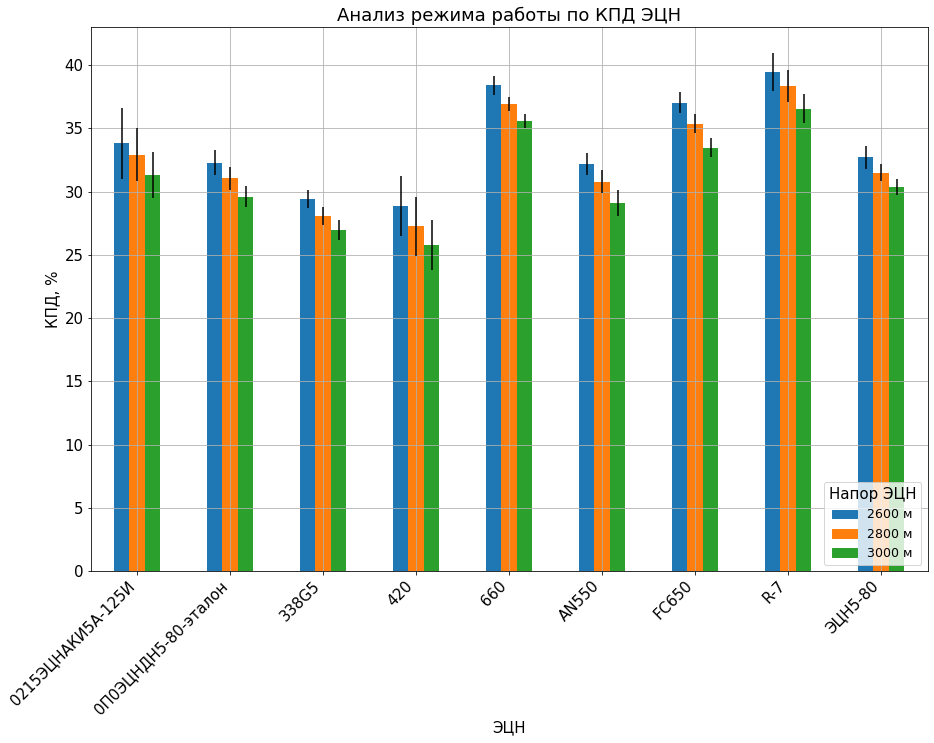

In [18]:
fig = plt.Figure()

pt_eff = big_df.pivot_table(index = ['this_name'],columns=['this_head'], values = ['leff'], aggfunc  = calc_emv)

pt_eff_std = big_df.pivot_table(index = ['this_name'],columns=['this_head'], values = ['leff'], aggfunc  = calc_std)

pt_eff.plot(kind='bar', yerr = pt_eff_std)
plt.xlabel('ЭЦН')
plt.ylabel('КПД, %')
plt.title('Анализ режима работы по КПД ЭЦН')

cc = ['tab:blue', 'tab:orange', 'tab:green']
heads = [x[1] for x in pt_eff.columns]

colors = {f"{heads[x]} м": cc[x] for x in range(len(pt_eff.columns))}
labels = list(colors.keys())
handles = [plt.Rectangle((0,0),1,1, color=colors[label]) for label in labels]
plt.legend(handles, labels, title="Напор ЭЦН", loc=4, 
                     fontsize='small', fancybox=True)
plt.xticks(rotation = 45, ha ="right")


plt.grid()
pt_eff

#### Дебит жидкости

lqliq                        
this_head                  2600        2800        3000
this_name                                              
0215ЭЦНАКИ5А-125И    107.303664  108.321202  104.437475
0П0ЭЦНДН5-80-эталон   97.828869  101.373772  104.086311
338G5                 97.890316  100.237264  100.079632
420                   81.886449   82.689186   83.698086
660                  102.053966  104.899640  107.767155
AN550                 94.410317   96.965006  100.214700
FC650                 99.899258  103.659014  104.793653
R-7                  103.581728  109.777275  112.580881
ЭЦН5-80               99.092270  101.164057  103.094907

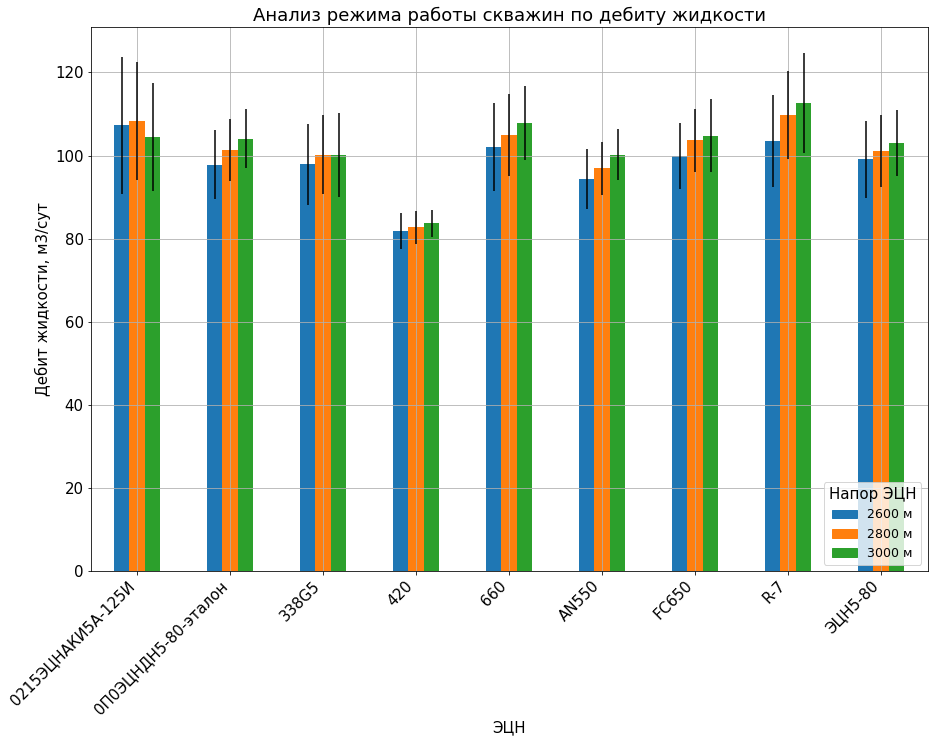

In [19]:
pt_qliq = big_df.pivot_table(index = ['this_name'],columns=['this_head'], values = ['lqliq'], aggfunc  = calc_emv)
pt_qliq_std = big_df.pivot_table(index = ['this_name'],columns=['this_head'], values = ['lqliq'], aggfunc  = np.std)

hand = pt_qliq.plot(kind='bar', yerr = pt_qliq_std)
plt.xlabel('ЭЦН')
plt.ylabel('Дебит жидкости, м3/сут')
plt.title('Анализ режима работы скважин по дебиту жидкости')


cc = ['tab:blue', 'tab:orange', 'tab:green']
heads = [x[1] for x in pt_qliq.columns]

colors = {f"{heads[x]} м": cc[x] for x in range(len(pt_qliq.columns))}
labels = list(colors.keys())
handles = [plt.Rectangle((0,0),1,1, color=colors[label]) for label in labels]
plt.legend(handles, labels, title="Напор ЭЦН", loc=4, 
                     fontsize='small', fancybox=True)
plt.xticks(rotation = 45, ha ="right")


plt.grid()
pt_qliq

#### Деградация КПД - Наработка на отказ (ННО)

In [20]:
with open('ESP_json.db', 'r') as outfile:
    file = outfile
    db = json.load(outfile)

db_df = pd.DataFrame(db)
db_df = db_df.T  

number_of_point_in_curves = []
for i in db_df.index:
    this_pump = db_df.loc[i]
    number_of_point_in_curves.append(len(this_pump['rate_points']))
    
db_df['number_of_point_in_curves'] = number_of_point_in_curves



this_pump = db_df[db_df['ID'] == 1185]
this_pump.T

,1185
ID,1185
source,legacy
manufacturer,Алмаз
name,ЭЦН5-80
stages_max,784
rate_nom_sm3day,80
rate_opt_min_sm3day,60
rate_opt_max_sm3day,115
rate_max_sm3day,140
slip_nom_rpm,2910


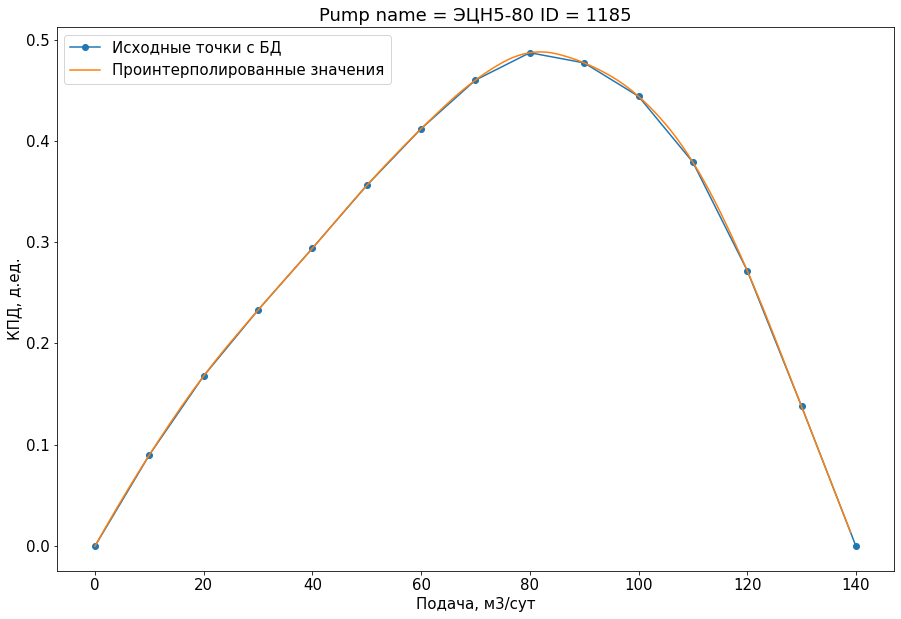

max init = 0.487 max interpolated = 0.48781939483623216
eff diff = 0.0008193948362321679


(0.487, 0.48781939483623216)

In [21]:
def find_max_eff_by_pump_id(ID: int):
    this_pump = db_df[db_df['ID'] == ID]
    f = interpolate.interp1d(this_pump['rate_points'].values[0], this_pump['eff_points'].values[0], kind = 'quadratic')

    q_liq_range = np.arange(min(this_pump['rate_points'].values[0]), max(this_pump['rate_points'].values[0]), 1)
    #q_liq_range = this_pump['rate_points'].values[0]
    eff_interpolated = f(q_liq_range)
    fig  = plt.Figure()

    plt.plot(this_pump['rate_points'].values[0], this_pump['eff_points'].values[0], 'o-', label = 'Исходные точки с БД')
    plt.plot(q_liq_range, eff_interpolated, label = 'Проинтерполированные значения')
    plt.legend()
    plt.xlabel('Подача, м3/сут')
    plt.ylabel('КПД, д.ед.')
    plt.title(f"Pump name = {this_pump['name'].values[0]} ID = {this_pump['ID'].values[0]}")
    plt.show()
    max_init = max(this_pump['eff_points'].values[0])
    max_interpolated = max(eff_interpolated)
    print(f"max init = {max_init} max interpolated = {max_interpolated}")
    print(f"eff diff = {abs(max_init - max_interpolated)}")
    return max_init, max_interpolated

find_max_eff_by_pump_id(1185)

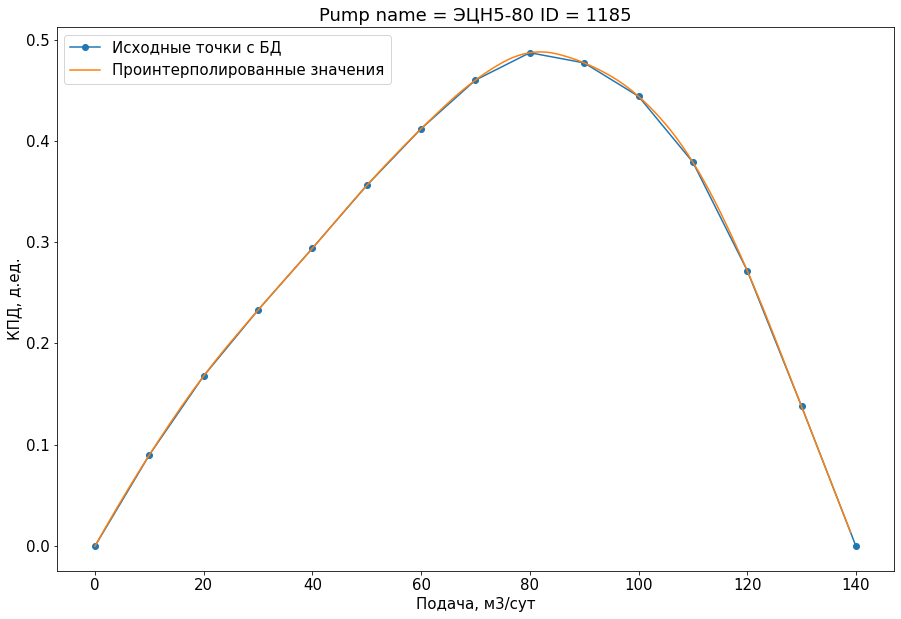

max init = 0.487 max interpolated = 0.48781939483623216
eff diff = 0.0008193948362321679


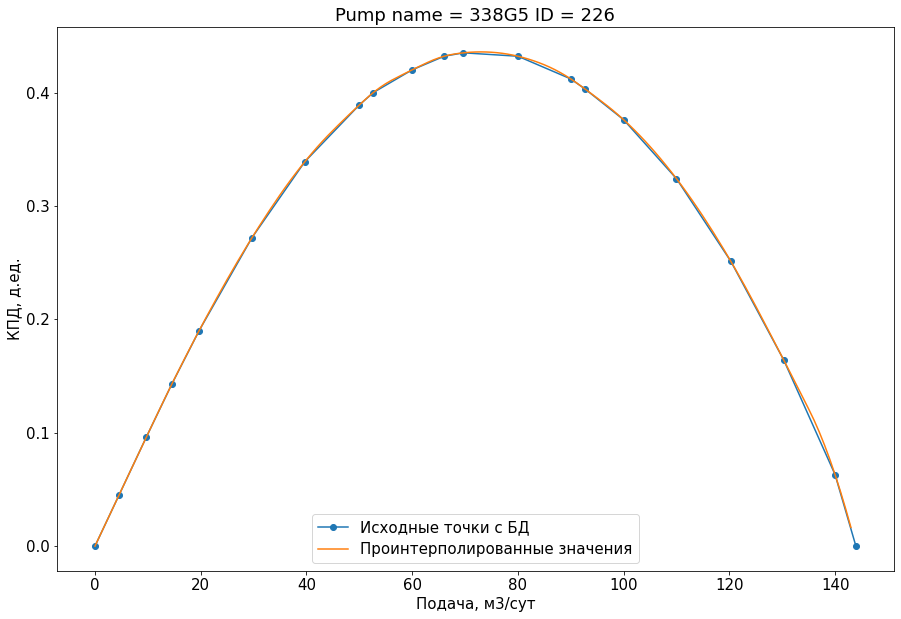

max init = 0.435 max interpolated = 0.43580945857198383
eff diff = 0.0008094585719838343


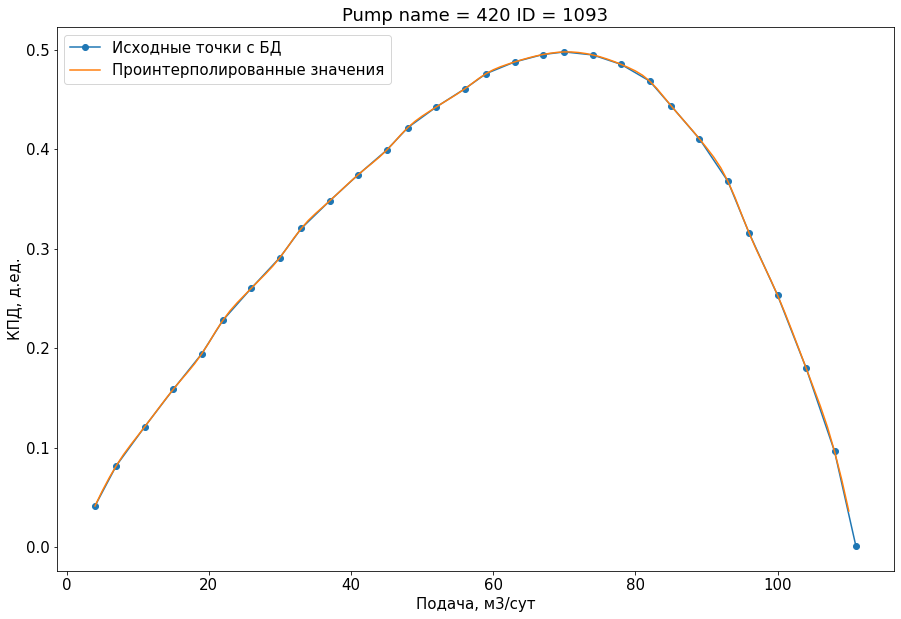

max init = 0.4976764366 max interpolated = 0.4976764366
eff diff = 0.0


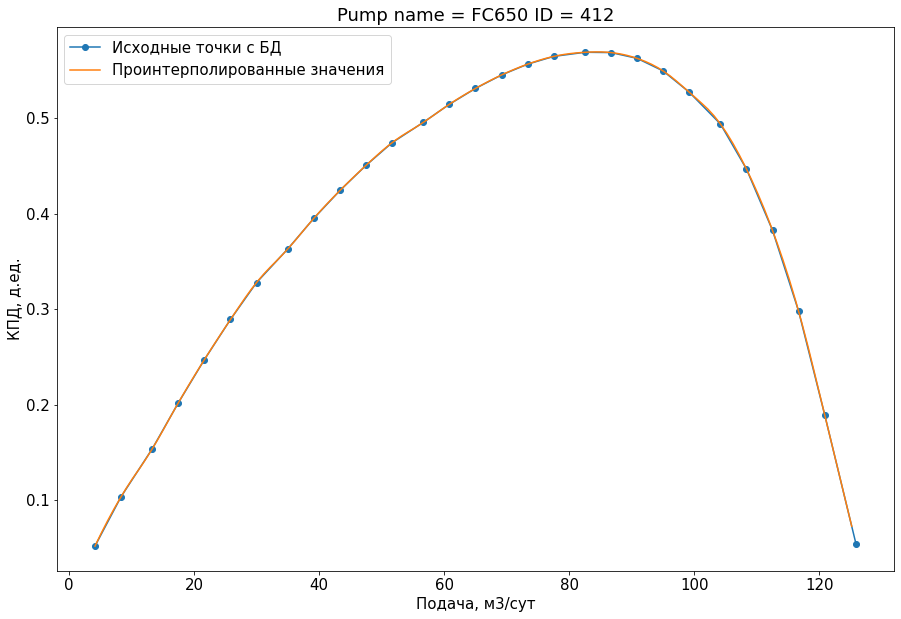

max init = 0.5689114964 max interpolated = 0.5693048015811248
eff diff = 0.0003933051811247923


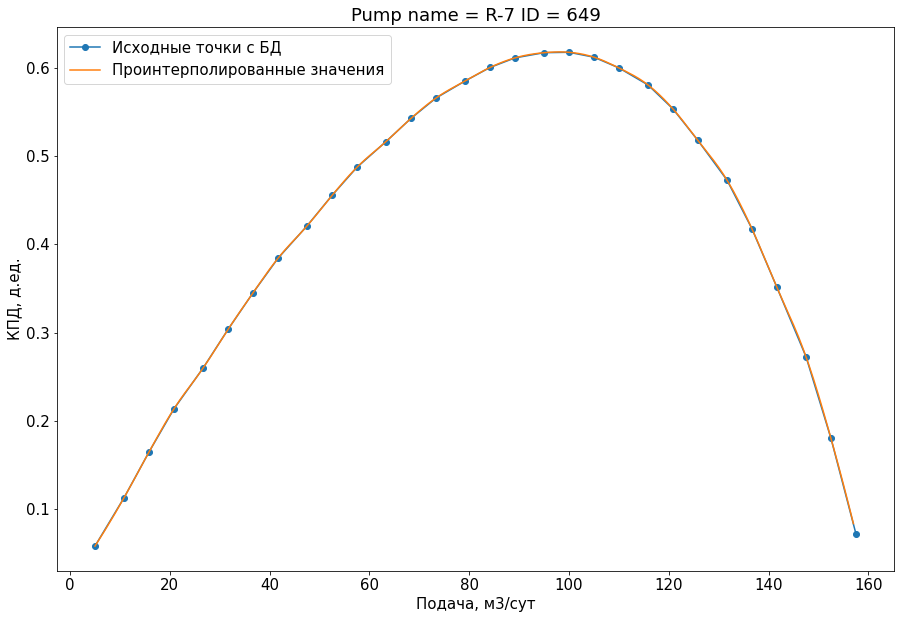

max init = 0.6174201894 max interpolated = 0.6178578485999796
eff diff = 0.0004376591999796231


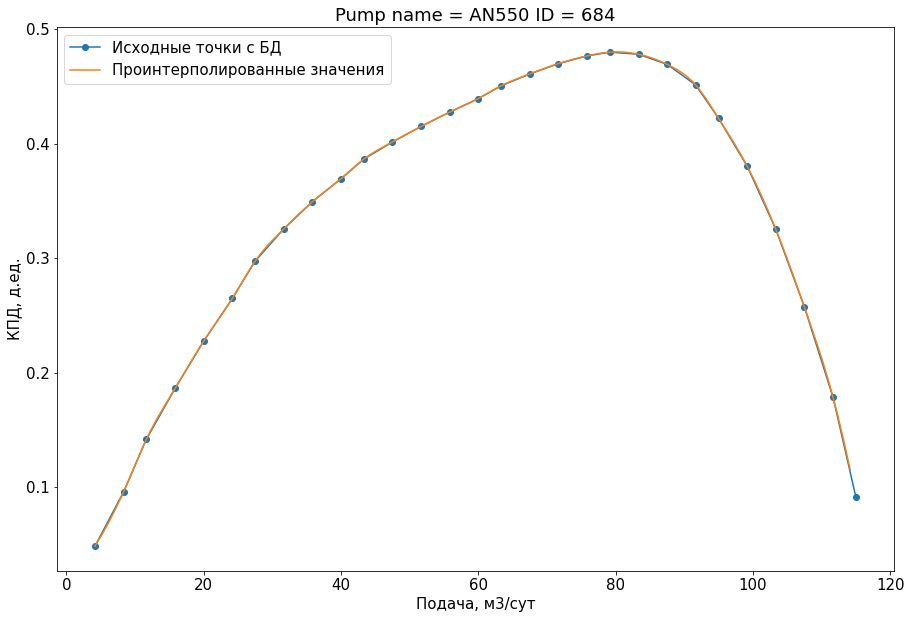

max init = 0.4801807452 max interpolated = 0.48039189927786785
eff diff = 0.00021115407786787


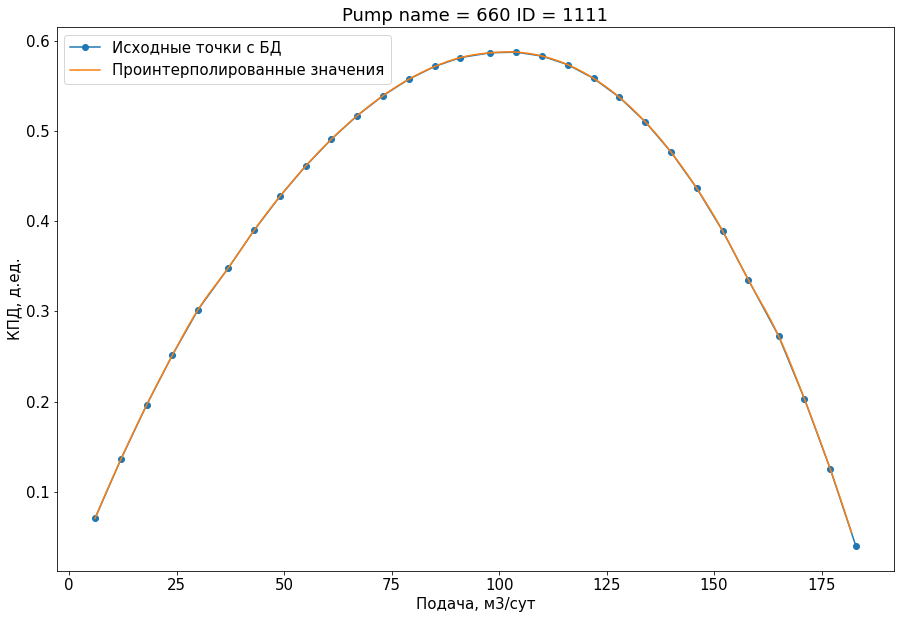

max init = 0.5880253428 max interpolated = 0.5883058810835218
eff diff = 0.000280538283521814


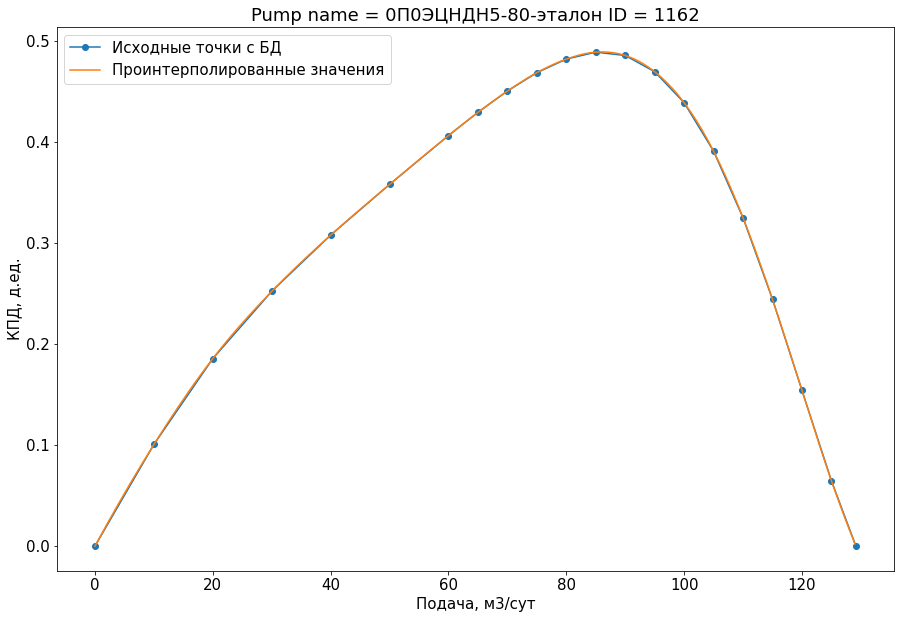

max init = 0.4892 max interpolated = 0.48943675371086903
eff diff = 0.00023675371086900876


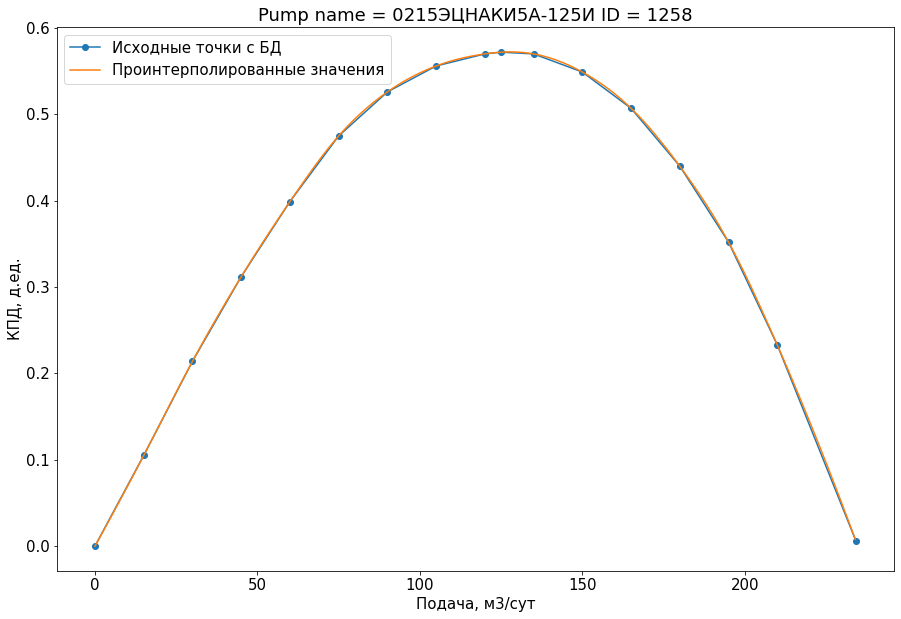

max init = 0.572 max interpolated = 0.572309838481431
eff diff = 0.0003098384814310684


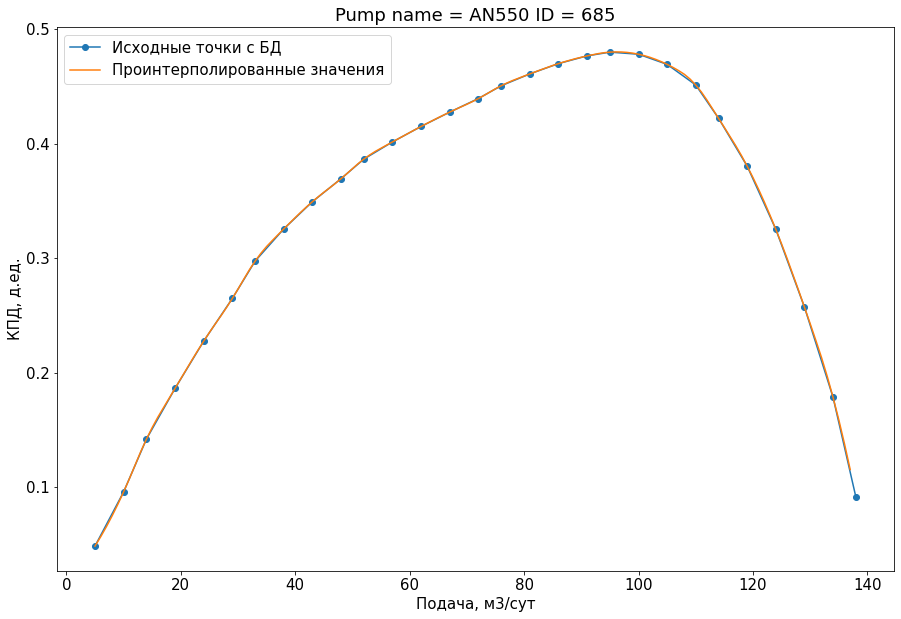

max init = 0.4801807452 max interpolated = 0.48038508489999415
eff diff = 0.00020433969999417156


{1185: 0.48781939483623216,
 226: 0.43580945857198383,
 1093: 0.4976764366,
 412: 0.5693048015811248,
 649: 0.6178578485999796,
 684: 0.48039189927786785,
 1111: 0.5883058810835218,
 1162: 0.48943675371086903,
 1258: 0.572309838481431,
 685: 0.48038508489999415}

In [22]:
id_max_eff_mask = {}
for i in big_df['this_id'].unique():
    _, id_max_eff_mask[i]  = find_max_eff_by_pump_id(i)
id_max_eff_mask

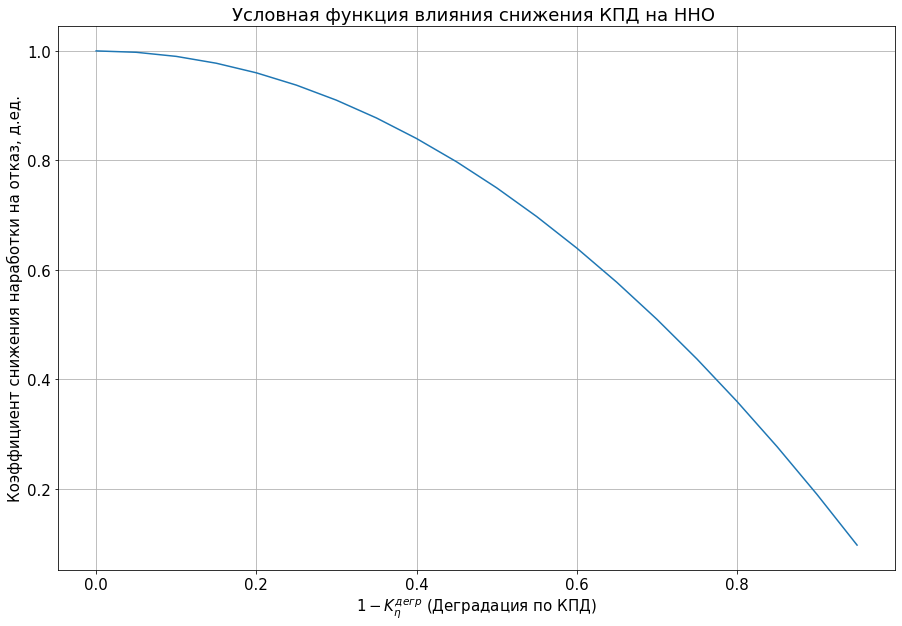

In [23]:
k_degr_eff_range = np.arange(0, 1, 0.05)
def nno(x):
    return 1 - x**2

#fig = plt.Figure()
plt.plot(k_degr_eff_range, nno(k_degr_eff_range))
plt.xlabel('$1 - K_{\eta}^{дегр}$ (Деградация по КПД)')
plt.ylabel('Коэффициент снижения наработки на отказ, д.ед.')
plt.title('Условная функция влияния снижения КПД на ННО ')
plt.grid()
plt.show()


<ipython-input-24-a9be33686df8>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-24-a9be33686df8>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-24-a9be33686df8>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-24-a9be336

Text(0.5, 0, 'k_degr_eff')

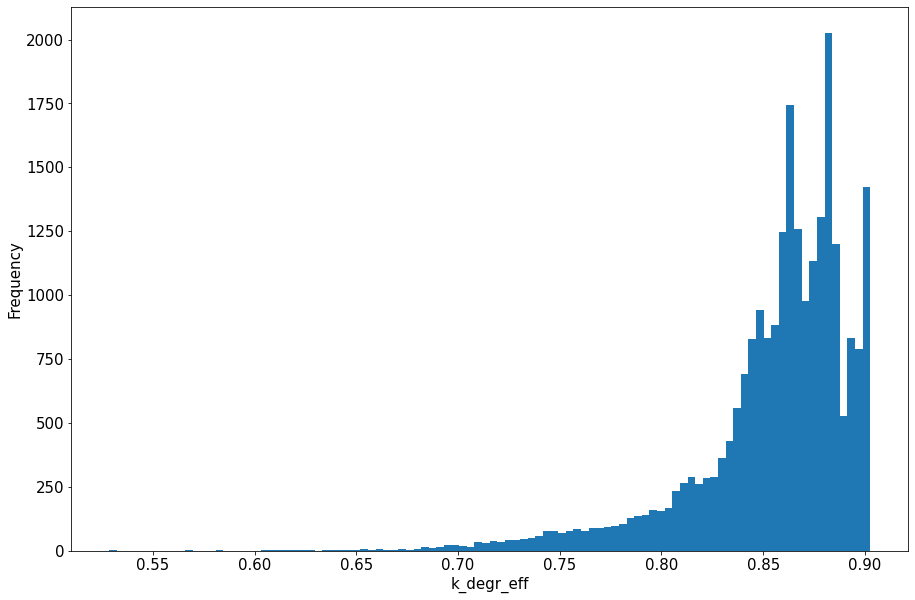

In [24]:
big_df['this_max_eff'] = big_df['this_id'].apply(lambda x: id_max_eff_mask[x])
big_df['k_degr_eff'] = (big_df['leff']/100) / big_df['this_max_eff']
big_df['eff_div_max_eff'] = (big_df['leff']/100) / big_df['this_max_eff']

big_df['k_degr_eff'] = nno(1 - big_df['k_degr_eff'])
big_df['k_degr_eff'].plot.hist(bins=100)
plt.xlabel('k_degr_eff')

k_degr_eff                    
this_head                 2600      2800      3000
this_name                                         
0215ЭЦНАКИ5А-125И     0.830420  0.818479  0.793873
0П0ЭЦНДН5-80-эталон   0.883802  0.865915  0.843528
338G5                 0.894279  0.873345  0.853843
420                   0.820925  0.793236  0.766536
660                   0.879442  0.861475  0.843542
AN550                 0.890535  0.870871  0.843819
FC650                 0.877530  0.856625  0.830099
R-7                   0.868834  0.855804  0.833171
ЭЦН5-80               0.891140  0.874512  0.857584

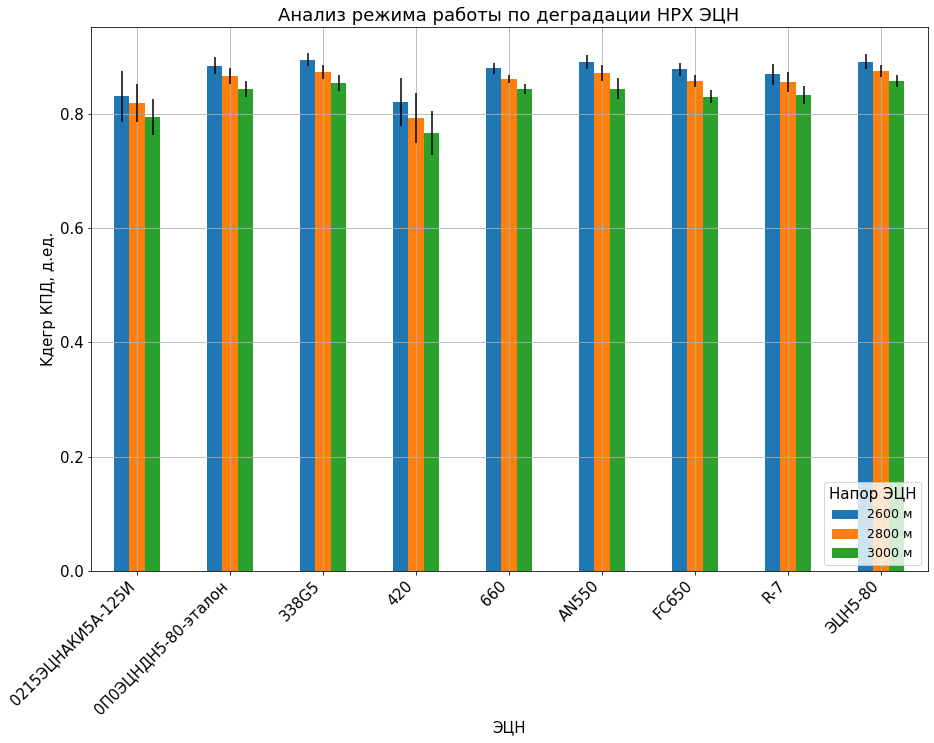

In [25]:
pt_k_degr_eff = big_df.pivot_table(index = ['this_name'],columns=['this_head'], values = ['k_degr_eff'], aggfunc  = calc_emv)
pt_k_degr_eff_std = big_df.pivot_table(index = ['this_name'],columns=['this_head'], values = ['k_degr_eff'], aggfunc  = np.std)


pt_k_degr_eff.plot(kind='bar', yerr=pt_k_degr_eff_std)
plt.legend(loc=3)
plt.xlabel('ЭЦН')
plt.ylabel('Kдегр КПД, д.ед.')



cc = ['tab:blue', 'tab:orange', 'tab:green']
heads = [x[1] for x in pt_qliq.columns]

colors = {f"{heads[x]} м": cc[x] for x in range(len(pt_qliq.columns))}
labels = list(colors.keys())
handles = [plt.Rectangle((0,0),1,1, color=colors[label]) for label in labels]
plt.legend(handles, labels, title="Напор ЭЦН", loc=4, 
                     fontsize='small', fancybox=True)
plt.xticks(rotation = 45, ha ="right")

plt.title('Анализ режима работы по деградации НРХ ЭЦН')
plt.grid()

pt_k_degr_eff

#### Финальная оценка

In [26]:
pt_eff

leff                      
this_head                 2600       2800       3000
this_name                                           
0215ЭЦНАКИ5А-125И    33.832873  32.936988  31.313167
0П0ЭЦНДН5-80-эталон  32.289012  31.043914  29.600229
338G5                29.428562  28.088253  26.938762
420                  28.841508  27.257471  25.801200
660                  38.417827  36.941169  35.567252
AN550                32.169115  30.800633  29.082789
FC650                37.024618  35.386743  33.476784
R-7                  39.458101  38.359844  36.575963
ЭЦН5-80              32.711443  31.513730  30.383413

In [27]:
pt_eff_std

leff                    
this_head                2600      2800      3000
this_name                                        
0215ЭЦНАКИ5А-125И    2.822963  2.086429  1.846996
0П0ЭЦНДН5-80-эталон  0.986111  0.892991  0.810272
338G5                0.710904  0.729592  0.795986
420                  2.373583  2.325843  1.964281
660                  0.757546  0.542000  0.569666
AN550                0.876034  0.915930  1.044933
FC650                0.831877  0.747427  0.765043
R-7                  1.483248  1.299941  1.153887
ЭЦН5-80              0.889541  0.655756  0.630984

In [28]:
def find_max_val_for_norm(pivot_table_df):
    pt_values_eff = pivot_table_df.values.flatten()
    pt_values_eff = pt_values_eff[~np.isnan(pt_values_eff)]
    pt_values_eff_max = pt_values_eff.max()
    return pt_values_eff_max

pt_values_eff_max 39.4581011755417 pt_values_qliq_max 112.58088140288456 pt_values_k_degr_eff_max 0.8942792238101267


,2600,2800,3000
this_name,,,
0215ЭЦНАКИ5А-125И,0.758887,0.735074,0.653523
0П0ЭЦНДН5-80-эталон,0.702753,0.685967,0.654206
338G5,0.648497,0.618965,0.579465
420,0.488044,0.450052,0.416691
660,0.867953,0.840337,0.813897
AN550,0.680825,0.654718,0.619074
FC650,0.817035,0.790978,0.733052
R-7,0.893886,0.907172,0.863616
ЭЦН5-80,0.727129,0.701807,0.676202


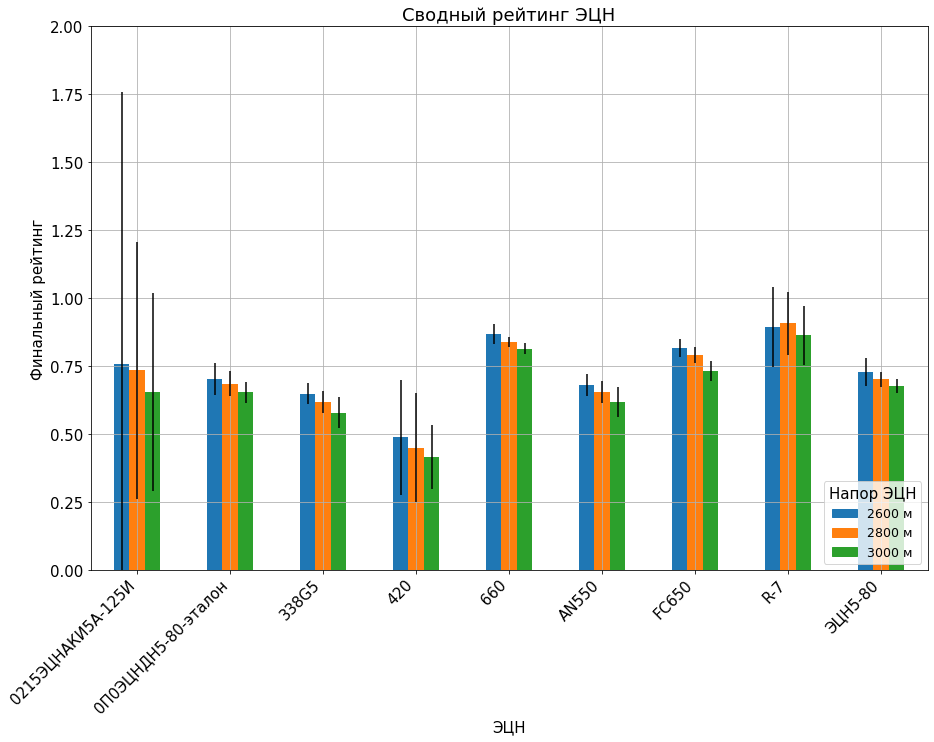

In [29]:

pt_values_eff_max = find_max_val_for_norm(pt_eff)
pt_values_qliq_max = find_max_val_for_norm(pt_qliq)
pt_values_k_degr_eff_max = find_max_val_for_norm(pt_k_degr_eff)

pt_values_eff_std_max = find_max_val_for_norm(pt_eff_std)
pt_values_qliq_std_max = find_max_val_for_norm(pt_qliq_std)
pt_values_k_degr_eff_std_max = find_max_val_for_norm(pt_k_degr_eff_std)



print('pt_values_eff_max', pt_values_eff_max,
      'pt_values_qliq_max', pt_values_qliq_max,
      'pt_values_k_degr_eff_max', pt_values_k_degr_eff_max)

pt_result = pt_eff.copy()
pt_result = pt_eff.values/pt_values_eff_max  * pt_qliq.values/pt_values_qliq_max * pt_k_degr_eff.values/pt_values_k_degr_eff_max
pt_result_std = pt_eff_std.values/pt_values_eff_std_max  * pt_qliq_std.values / pt_values_qliq_std_max * pt_k_degr_eff_std.values / pt_values_k_degr_eff_std_max

pt_result = pd.DataFrame(pt_result, index = pt_eff.index, columns = [x[1] for x in pt_eff.columns])
pt_result_std = pd.DataFrame(pt_result_std, index = pt_eff.index, columns = [x[1] for x in pt_eff.columns])




pt_result.plot(kind='bar', yerr=pt_result_std, ylim=[0, 2])


cc = ['tab:blue', 'tab:orange', 'tab:green']
heads = [x[1] for x in pt_qliq.columns]

colors = {f"{heads[x]} м": cc[x] for x in range(len(pt_qliq.columns))}
labels = list(colors.keys())
handles = [plt.Rectangle((0,0),1,1, color=colors[label]) for label in labels]
plt.legend(handles, labels, title="Напор ЭЦН", loc=4, 
                     fontsize='small', fancybox=True)

plt.xticks(rotation = 45, ha ="right")


plt.ylabel('Финальный рейтинг')
plt.xlabel('ЭЦН')
plt.title('Сводный рейтинг ЭЦН')
plt.grid()
pt_result

In [30]:
r = []
for i in pt_result.index:
    this_s = pt_result.loc[i]
    this_s.index = i + ' ' + this_s.index.astype(str)
    r.append(this_s)
pd.concat(r).sort_values()

420 3000                    0.416691
420 2800                    0.450052
420 2600                    0.488044
338G5 3000                  0.579465
338G5 2800                  0.618965
AN550 3000                  0.619074
338G5 2600                  0.648497
0215ЭЦНАКИ5А-125И 3000      0.653523
0П0ЭЦНДН5-80-эталон 3000    0.654206
AN550 2800                  0.654718
ЭЦН5-80 3000                0.676202
AN550 2600                  0.680825
0П0ЭЦНДН5-80-эталон 2800    0.685967
ЭЦН5-80 2800                0.701807
0П0ЭЦНДН5-80-эталон 2600    0.702753
ЭЦН5-80 2600                0.727129
FC650 3000                  0.733052
0215ЭЦНАКИ5А-125И 2800      0.735074
0215ЭЦНАКИ5А-125И 2600      0.758887
FC650 2800                  0.790978
660 3000                    0.813897
FC650 2600                  0.817035
660 2800                    0.840337
R-7 3000                    0.863616
660 2600                    0.867953
R-7 2600                    0.893886
R-7 2800                    0.907172
d

Text(0, 0.5, 'Финальный рейтинг')

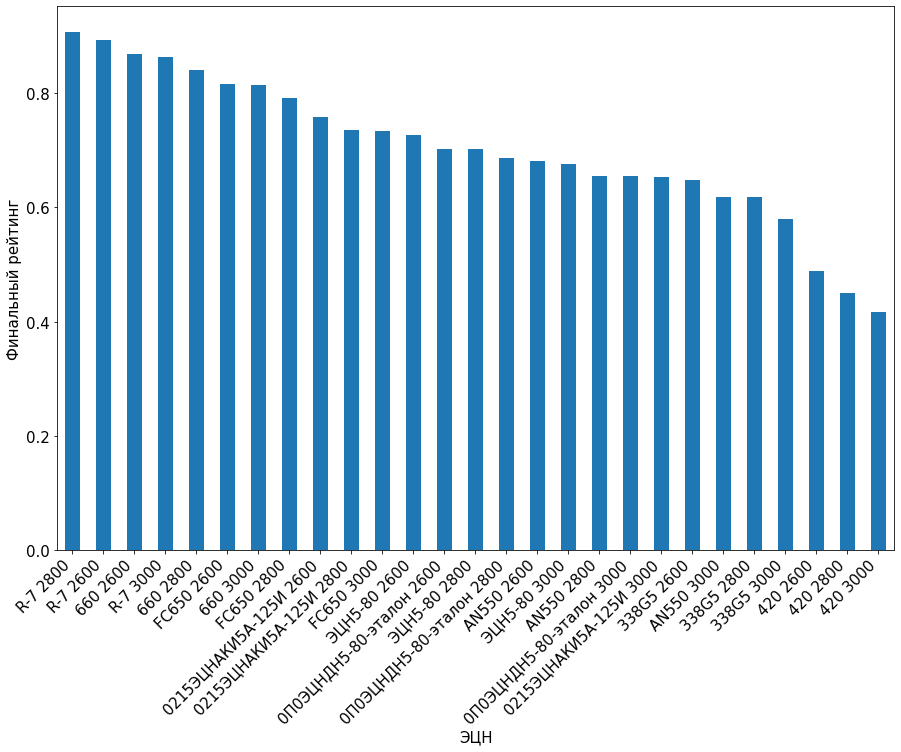

In [31]:
r = []
for i in pt_result.index:
    this_s = pt_result.loc[i]
    this_s.index = i + ' ' + this_s.index.astype(str)
    r.append(this_s)
pd.concat(r).sort_values(ascending=False).plot.bar()
plt.xlabel('ЭЦН')
plt.xticks(rotation = 45, ha ="right")

plt.ylabel('Финальный рейтинг')

In [32]:
pt_result_normed = pt_result / pt_result_std
pt_result_normed

,2600,2800,3000
this_name,,,
0215ЭЦНАКИ5А-125И,0.758887,1.554521,1.794399
0П0ЭЦНДН5-80-эталон,12.111261,14.609614,17.165805
338G5,17.125562,14.935615,10.305566
420,2.316253,2.252308,3.530537
660,24.022285,45.693900,41.008494
AN550,17.542880,16.127452,11.143238
FC650,23.588665,28.270577,19.823844
R-7,6.032991,7.776646,7.974875
ЭЦН5-80,14.014010,25.526569,26.165568


Text(0.5, 1.0, 'Финальный рейтинг подбора ЭЦН (комбинированный)')

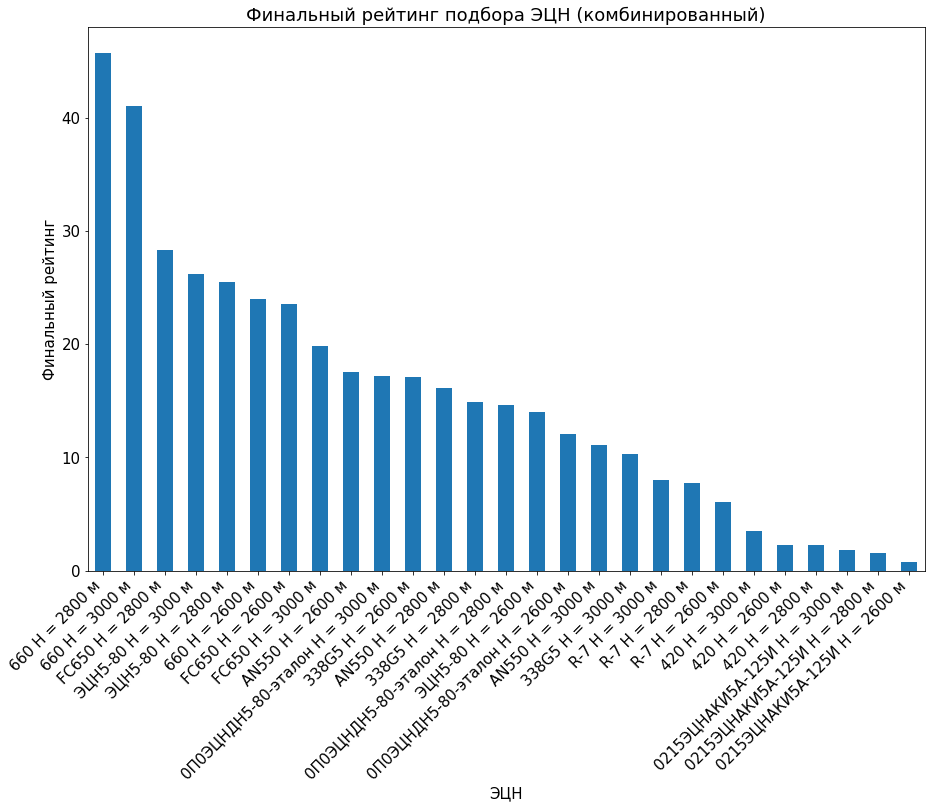

In [33]:
r = []
for i in pt_result_normed.index:
    this_s = pt_result_normed.loc[i]
    this_s.index = i + ' H = ' + this_s.index.astype(str) + ' м'
    r.append(this_s)
pd.concat(r).sort_values(ascending=False).plot.bar()
plt.xlabel('ЭЦН')
plt.xticks(rotation = 45, ha ="right")

plt.ylabel('Финальный рейтинг')
plt.title('Финальный рейтинг подбора ЭЦН (комбинированный)')

## Распределения 

### КПД

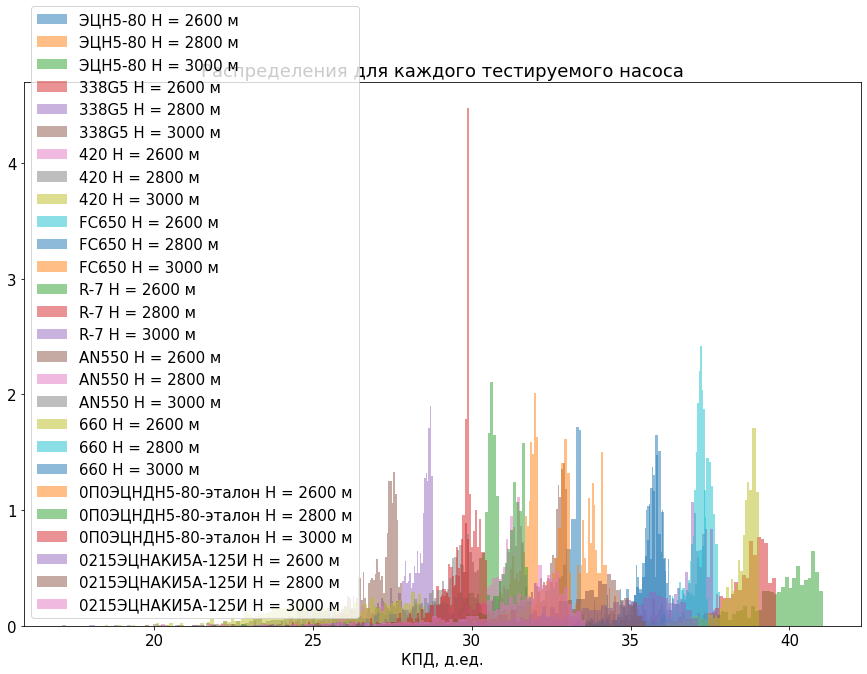

In [34]:
fig = plt.Figure()

for i in big_df['this_name'].unique():
    for j in big_df['this_head'].unique():
        this_df = big_df[(big_df['this_name'] == i)  &  (big_df['this_head'] == j)]

        plt.hist(this_df['leff'], bins = 100, density = True ,alpha=0.5, label = f"{i} H = {j} м")


plt.legend()
plt.title('Распределения для каждого тестируемого насоса')
plt.xlabel('КПД, д.ед.')
plt.show()

### Дебита жидкости

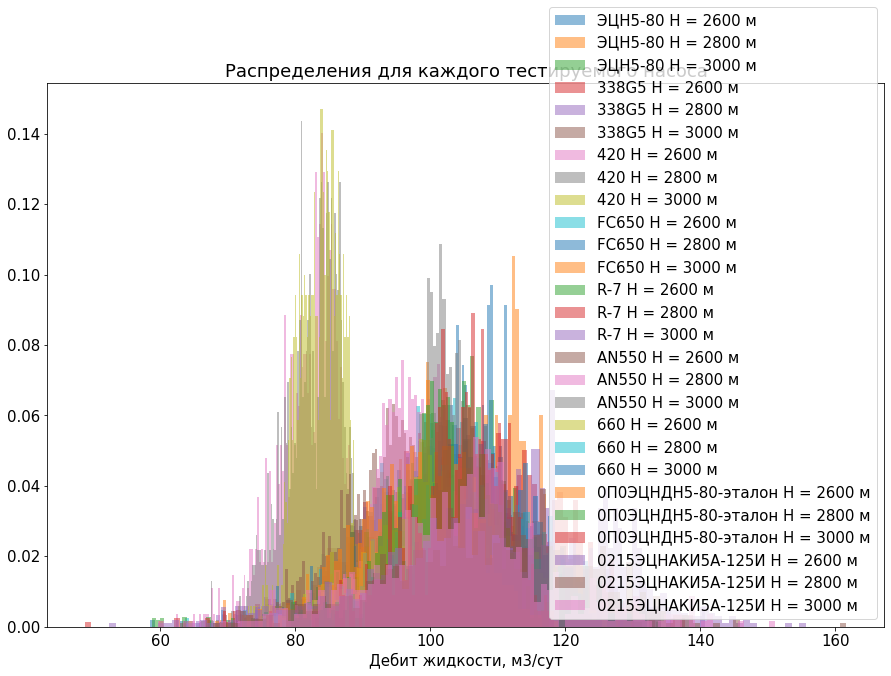

In [35]:
fig = plt.Figure()

for i in big_df['this_name'].unique():
    for j in big_df['this_head'].unique():
        this_df = big_df[(big_df['this_name'] == i)  &  (big_df['this_head'] == j)].copy()

        plt.hist(this_df['lqliq'], bins = 100, density = True ,alpha=0.5, label = f"{i} H = {j} м")


plt.legend()
plt.title('Распределения для каждого тестируемого насоса')
plt.xlabel('Дебит жидкости, м3/сут')
plt.show()

### Доли газа на приеме

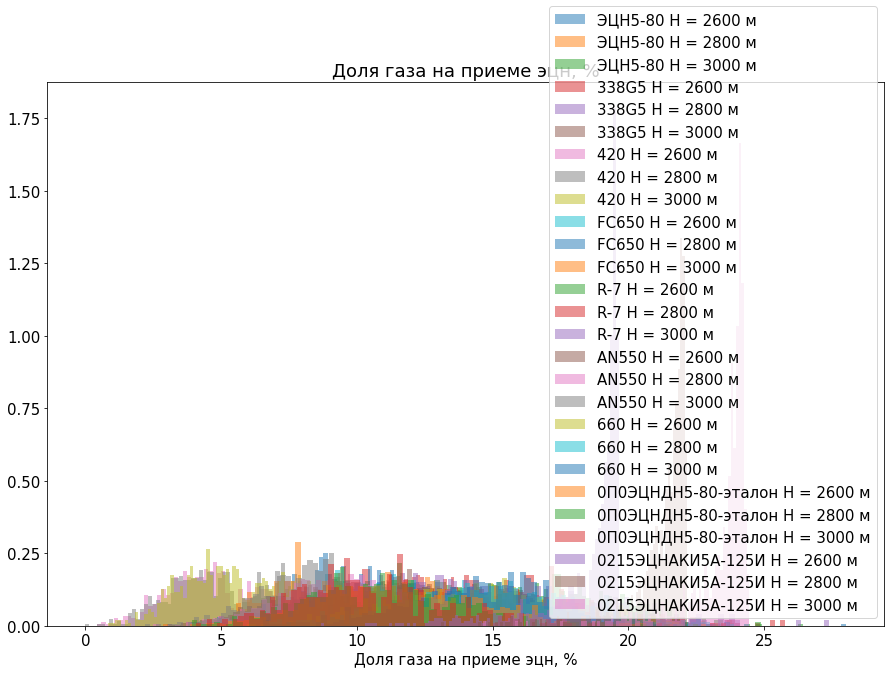

In [36]:
fig = plt.Figure()

for i in big_df['this_name'].unique():
    for j in big_df['this_head'].unique():
        this_df = big_df[(big_df['this_name'] == i)  &  (big_df['this_head'] == j)]

        plt.hist(this_df['lgas_fraction_intake'], bins = 100, density = True ,alpha=0.5, label = f"{i} H = {j} м")


plt.legend()
plt.title('Доля газа на приеме эцн, %')
plt.xlabel('Доля газа на приеме эцн, %')
plt.show()

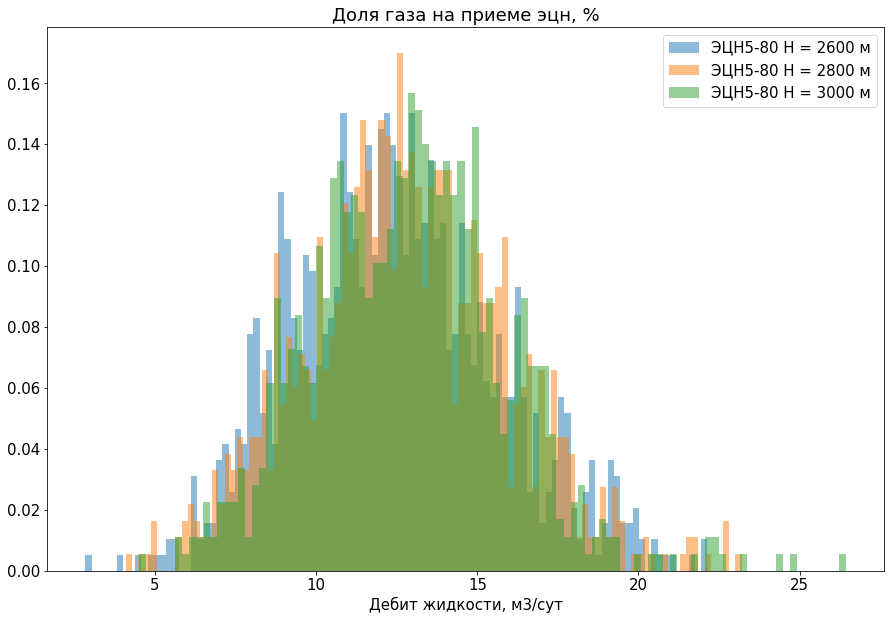

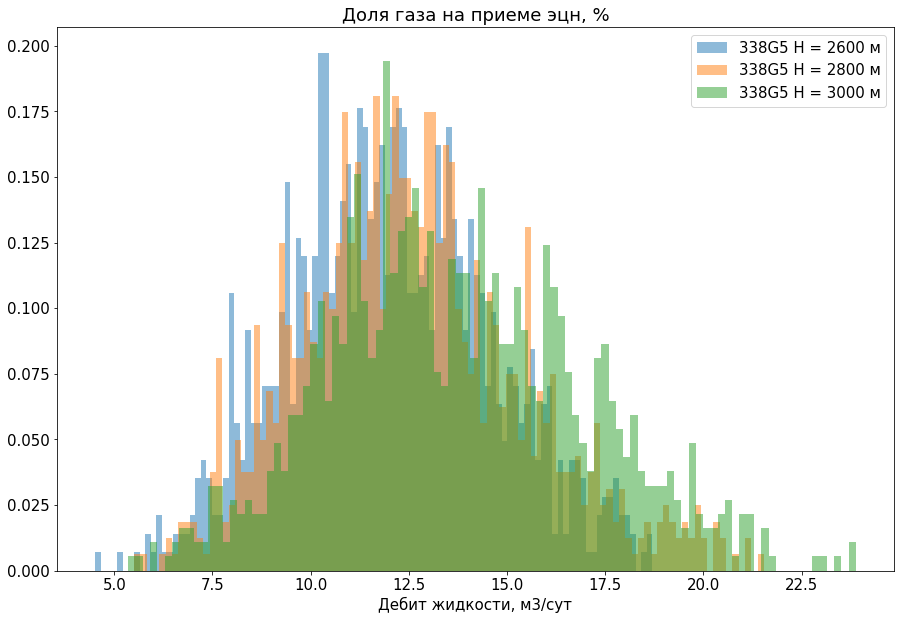

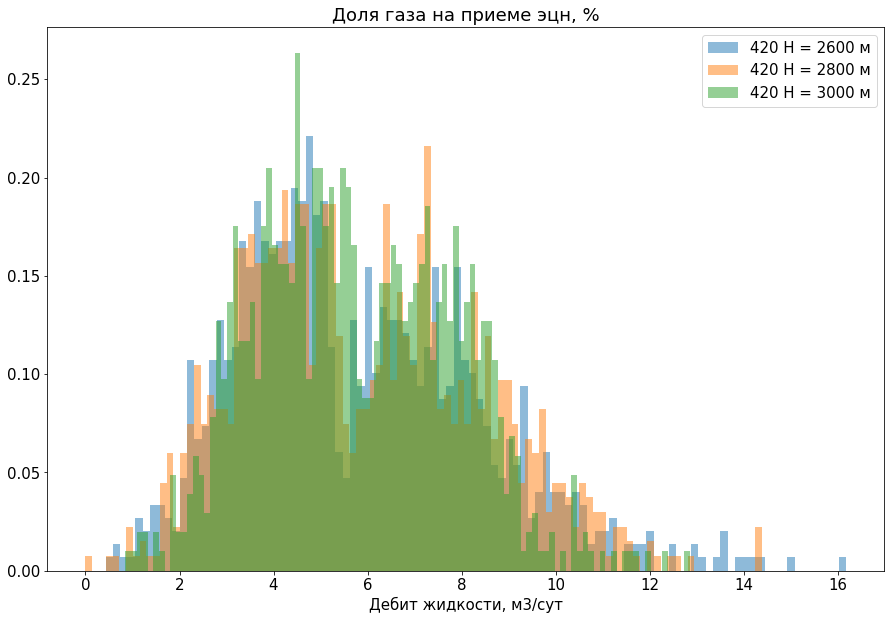

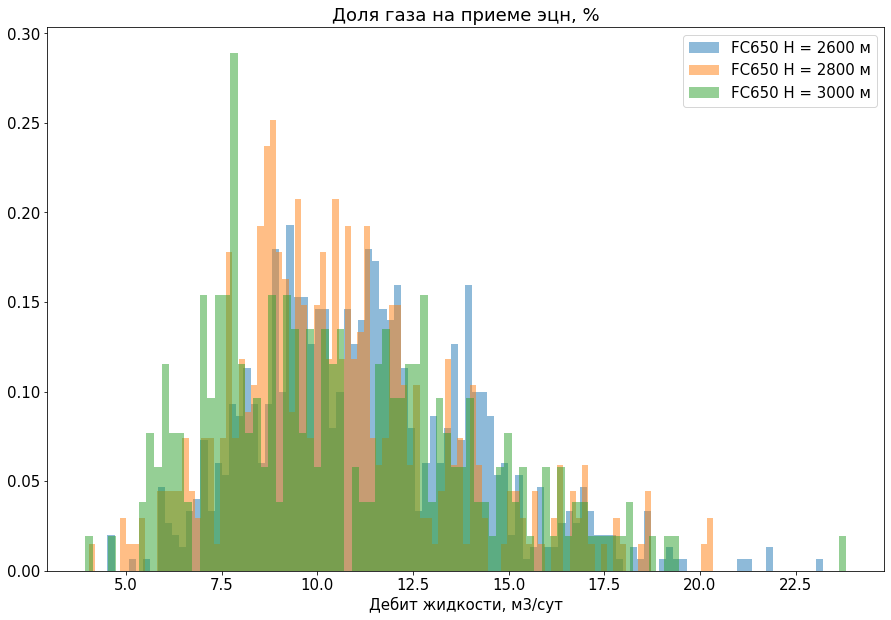

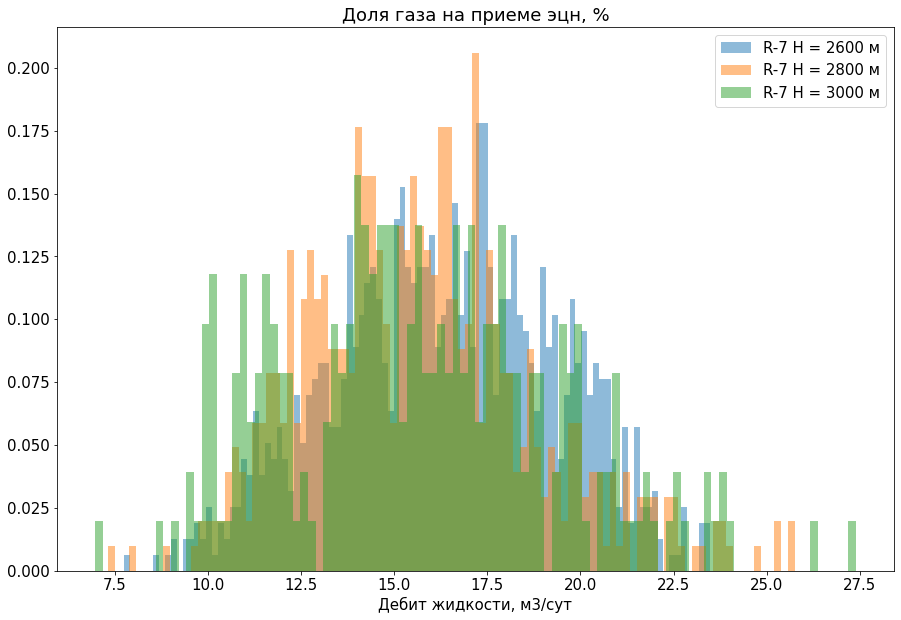

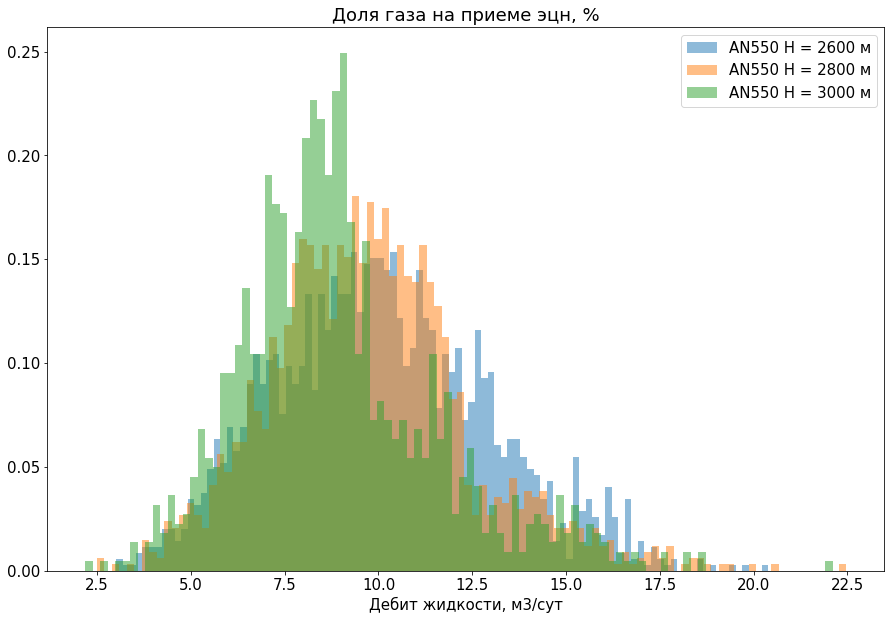

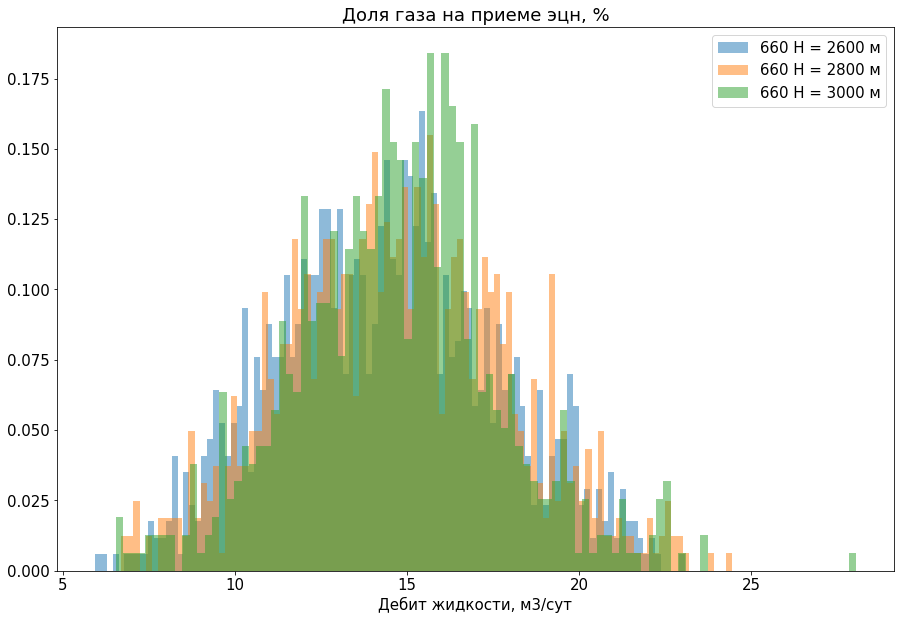

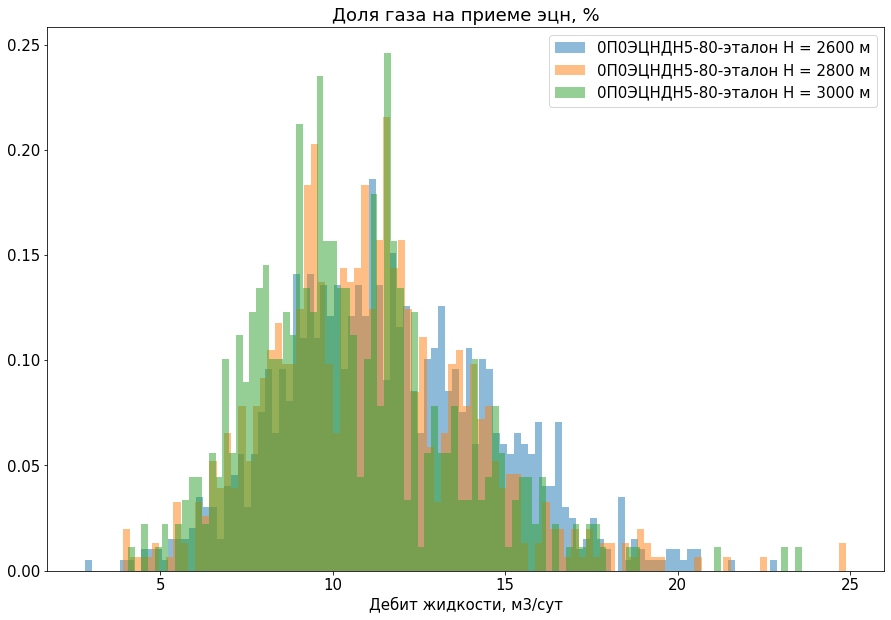

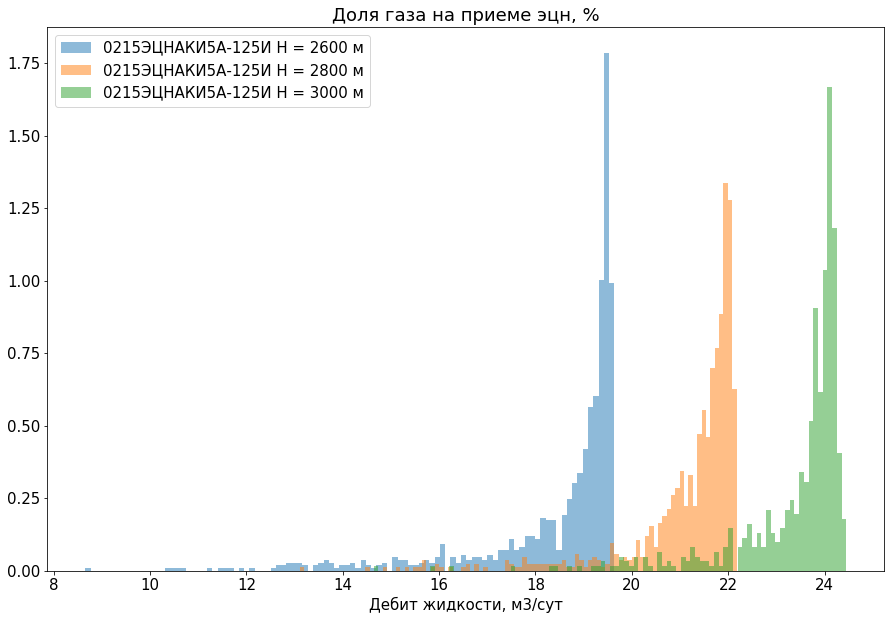

In [37]:
fig = plt.Figure()

for i in big_df['this_name'].unique():
    for j in big_df['this_head'].unique():
        this_df = big_df[(big_df['this_name'] == i)  &  (big_df['this_head'] == j)]

        plt.hist(this_df['lgas_fraction_intake'], bins = 100, density = True ,alpha=0.5, label = f"{i} H = {j} м")


    plt.legend()
    plt.title('Доля газа на приеме эцн, %')
    plt.xlabel('Дебит жидкости, м3/сут')
    plt.show()

### Дебита ГЖС через насос

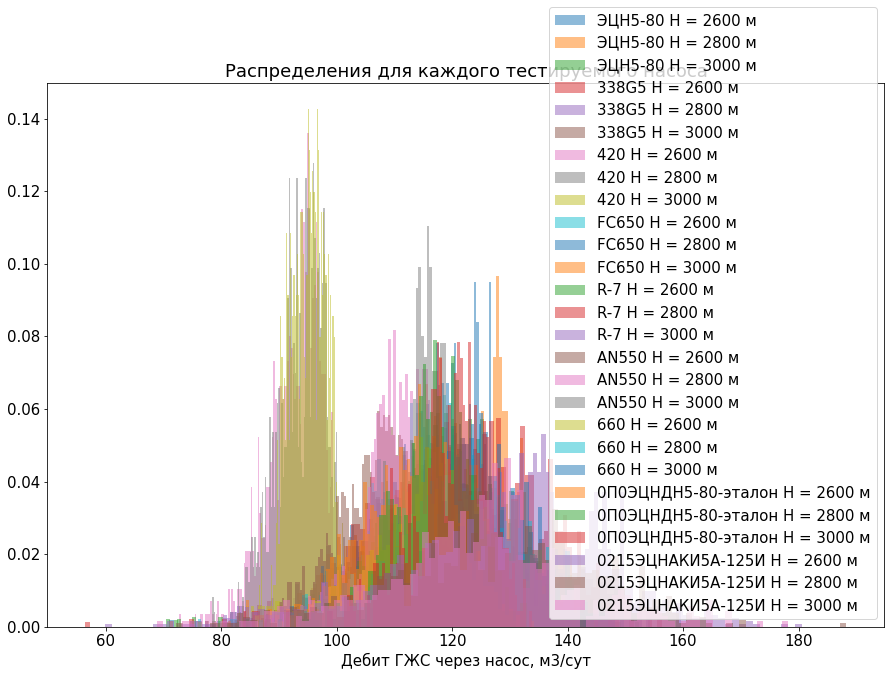

In [38]:
fig = plt.Figure()

for i in big_df['this_name'].unique():
    for j in big_df['this_head'].unique():
        this_df = big_df[(big_df['this_name'] == i)  &  (big_df['this_head'] == j)]

        plt.hist(this_df['lq_mix_pump_mean'], bins = 100, density = True ,alpha=0.5, label = f"{i} H = {j} м")


plt.legend()
plt.title('Распределения для каждого тестируемого насоса')
plt.xlabel('Дебит ГЖС через насос, м3/сут')
plt.show()

### Распределения через KDE

In [39]:
big_df

,lh_mes,lhead_esp,leff,lpower_esp,lqliq,lstatus,lgas_fraction_intake,lp_bhp_atm,lp_esp_dis,lparams,...,this_head,this_name,super_id,nodal_error_p_dis,pi_sm3dayatm,p_bhp_atm,pres_atma,this_max_eff,k_degr_eff,eff_div_max_eff
195,2661,2485.394727,25.289681,63.606289,63.010629,1,22.136654,46.756237,226.177779,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2600,ЭЦН5-80,ЭЦН5-80 H = 2600 м,0.300375,0.557526,46.756237,178.507963,0.487819,0.768084,0.518423
921,2661,2487.164919,25.551449,63.665839,63.673618,1,22.052392,46.879298,226.514421,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2600,ЭЦН5-80,ЭЦН5-80 H = 2600 м,0.672013,0.573691,46.879298,176.537172,0.487819,0.773223,0.523789
688,2661,2481.142849,26.919043,63.967069,67.542005,1,21.588860,47.565539,227.119444,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2600,ЭЦН5-80,ЭЦН5-80 H = 2600 м,1.485679,0.643213,47.565539,170.881555,0.487819,0.799138,0.551824
196,2661,2447.970847,28.101284,64.189337,71.685781,1,21.046456,48.401280,225.733770,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2600,ЭЦН5-80,ЭЦН5-80 H = 2600 м,0.322133,0.574698,48.401280,191.013956,0.487819,0.820274,0.576059
641,2661,1366.896518,28.219576,64.476922,125.938280,1,2.842696,108.639863,208.801905,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2600,ЭЦН5-80,ЭЦН5-80 H = 2600 м,0.060332,1.143090,108.639863,219.408271,0.487819,0.822324,0.578484
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
862,2661,2089.700275,30.279600,68.534716,95.643825,1,10.844536,71.541559,225.834105,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,3000,AN550,AN550 H = 3000 м,4.709386,0.986761,71.541559,176.612857,0.480385,0.863336,0.630319
848,2661,2078.133377,30.283439,68.516209,96.131417,1,10.621496,72.250280,225.736523,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,3000,AN550,AN550 H = 3000 м,4.771473,0.849980,72.250280,193.260099,0.480385,0.863395,0.630399
863,2661,2059.603707,30.287433,68.493452,96.925355,1,10.263222,73.414946,225.609874,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,3000,AN550,AN550 H = 3000 м,4.925281,0.862952,73.414946,193.269767,0.480385,0.863457,0.630482
482,2661,2089.483757,30.314368,68.538103,95.759915,1,10.783334,71.734911,226.044088,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,3000,AN550,AN550 H = 3000 м,4.962068,0.887538,71.734911,187.709100,0.480385,0.863871,0.631043


Text(0, 0.5, 'Плоность вероятности')

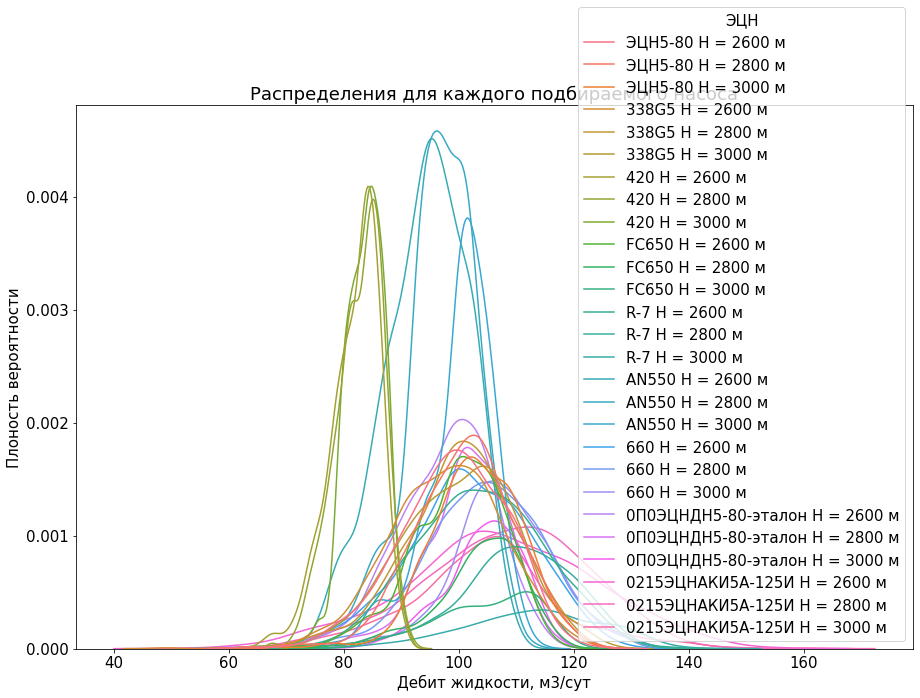

In [40]:
fig, ax = plt.subplots()
big_df_t = big_df.copy()
big_df_t = big_df_t.rename(columns = {'super_id': 'ЭЦН'})
g = sns.kdeplot(data=big_df_t, x="lqliq", hue="ЭЦН", ax = ax)
plt.title('Распределения для каждого подбираемого насоса')
plt.xlabel('Дебит жидкости, м3/сут')
plt.ylabel('Плоность вероятности')
#ax.legend(title='2')


Text(0, 0.5, 'Плоность вероятности')

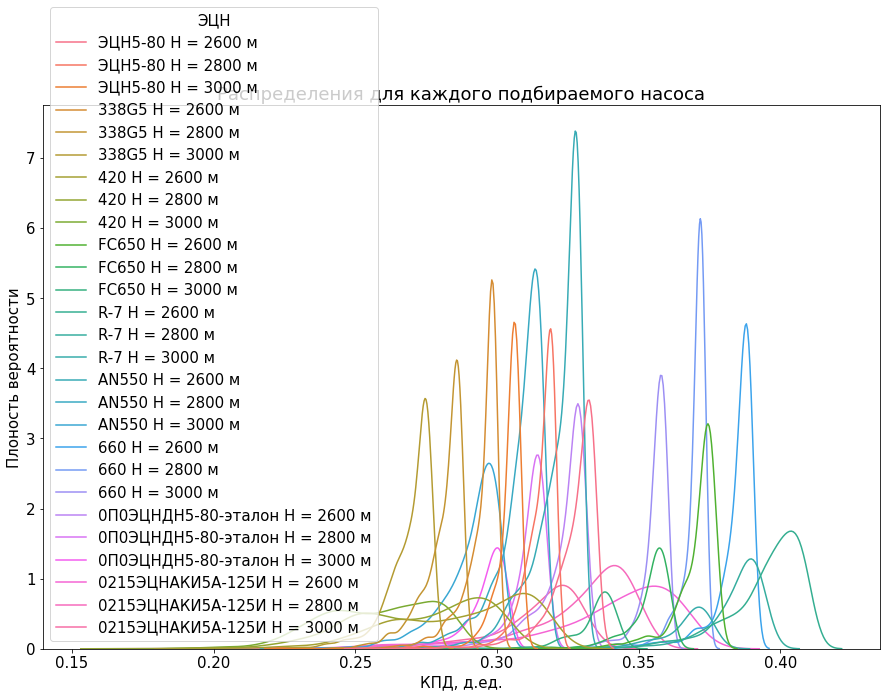

In [41]:
fig, ax = plt.subplots()
big_df_t = big_df.copy()
big_df_t = big_df_t.rename(columns = {'super_id': 'ЭЦН'})
big_df_t['leff'] = big_df_t['leff'] /100
g = sns.kdeplot(data=big_df_t, x="leff", hue="ЭЦН", ax = ax)
plt.title('Распределения для каждого подбираемого насоса')
plt.xlabel('КПД, д.ед.')
plt.ylabel('Плоность вероятности')
#ax.legend(title='2')


Text(0.5, 0, 'К прод., м3/сут/атм')

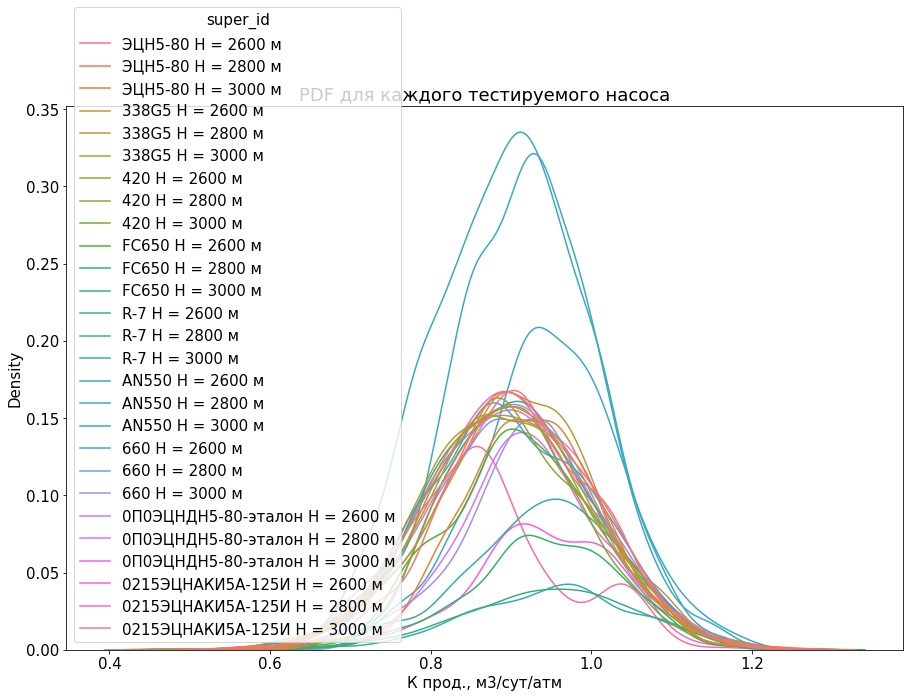

In [42]:
sns.kdeplot(data=big_df, x="pi_sm3dayatm", hue="super_id")
plt.title('PDF для каждого тестируемого насоса')
plt.xlabel('К прод., м3/сут/атм')

Text(0.5, 0, 'Пластовое давление, атм')

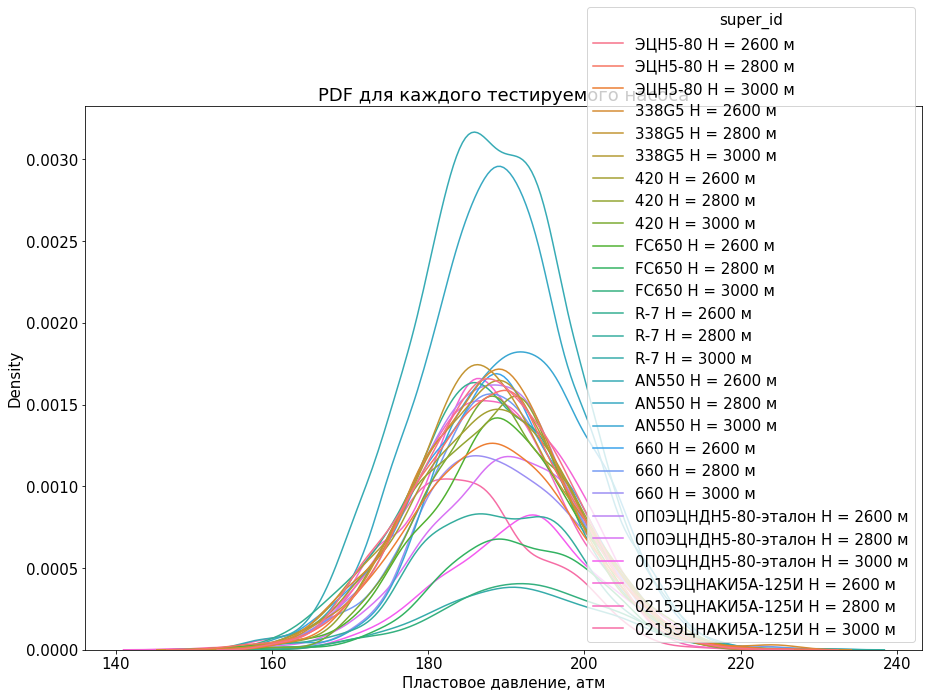

In [43]:
sns.kdeplot(data=big_df, x="pres_atma", hue="super_id")
plt.title('PDF для каждого тестируемого насоса')
plt.xlabel('Пластовое давление, атм')

Text(0.5, 0, 'Забойное давление, атм')

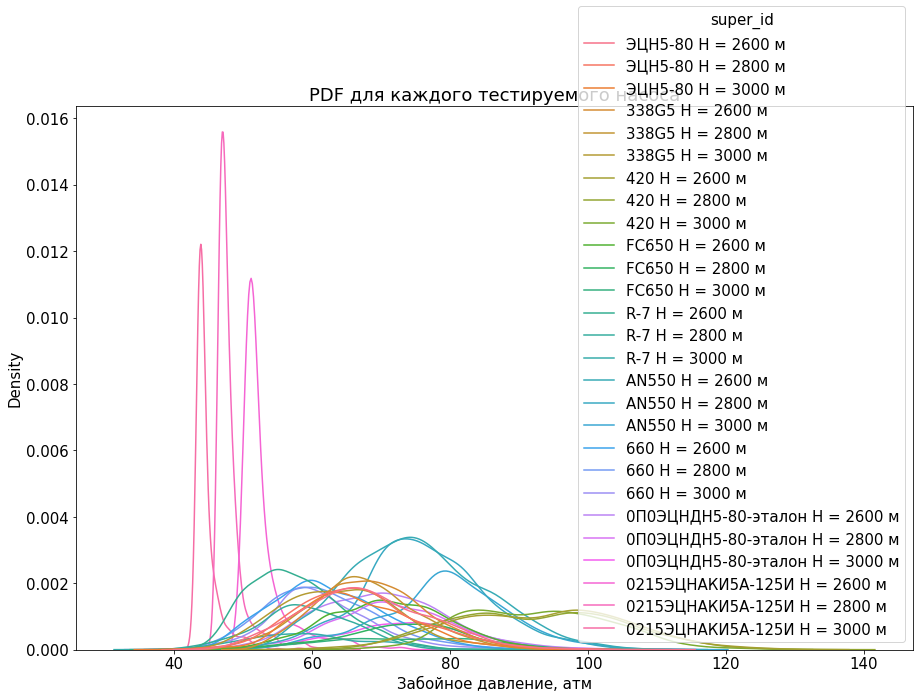

In [44]:
sns.kdeplot(data=big_df, x="p_bhp_atm", hue="super_id")
plt.title('PDF для каждого тестируемого насоса')
plt.xlabel('Забойное давление, атм')


Text(0.5, 0, 'Пластовое давление, атм')

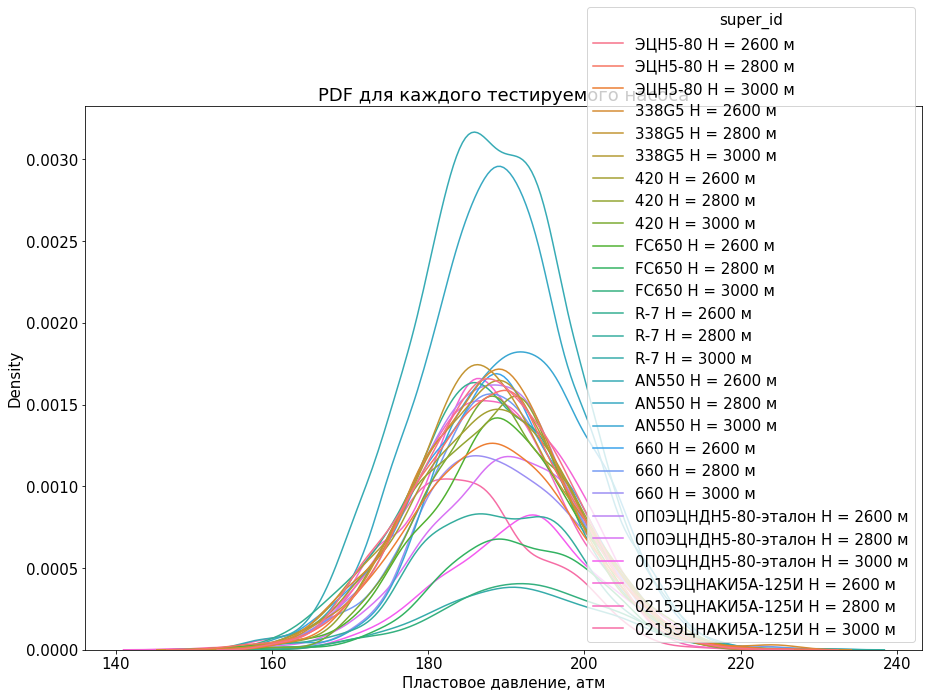

In [45]:
sns.kdeplot(data=big_df, x="pres_atma", hue="super_id")
plt.title('PDF для каждого тестируемого насоса')
plt.xlabel('Пластовое давление, атм')

Text(0.5, 0, 'Доля газа на приеме ЭЦН (1-ая ступень)')

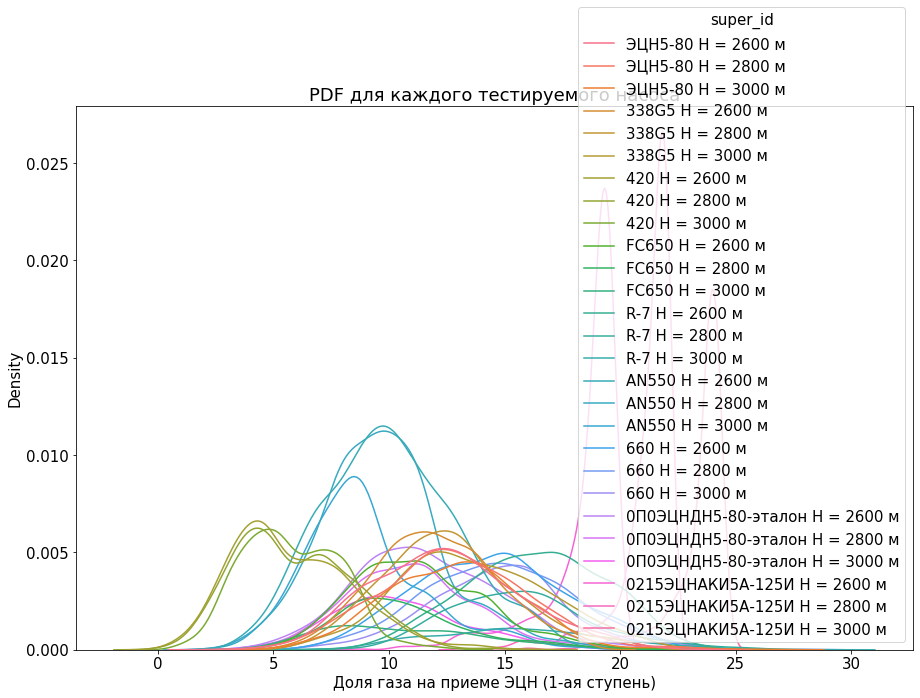

In [46]:
sns.kdeplot(data=big_df, x="lgas_fraction_intake", hue="super_id")
plt.title('PDF для каждого тестируемого насоса')
plt.xlabel("Доля газа на приеме ЭЦН (1-ая ступень)")

Text(0.5, 0, 'КПД, д.ед.')

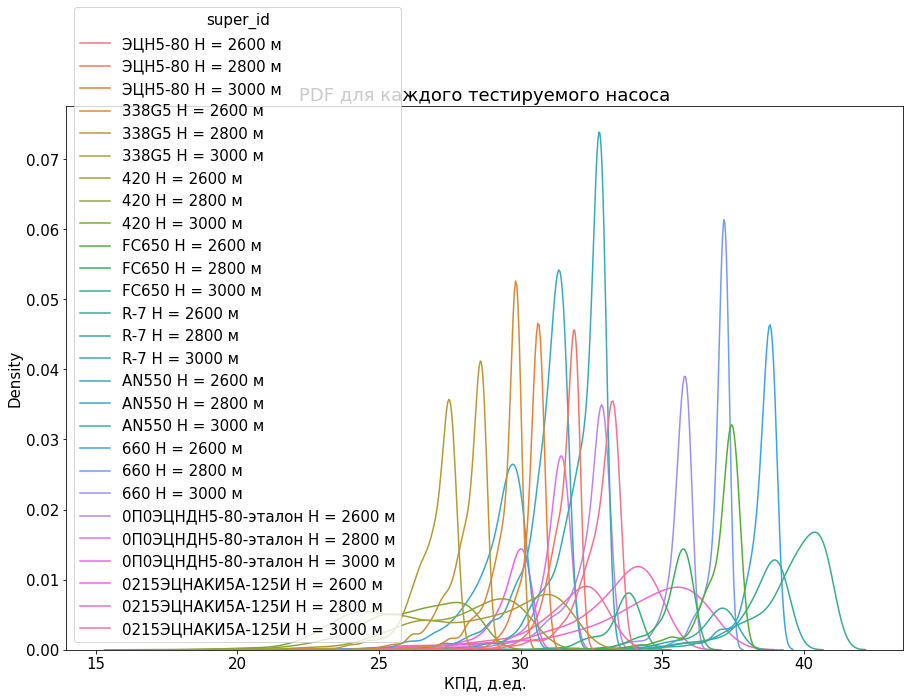

In [47]:
sns.kdeplot(data=big_df, x="leff", hue="super_id")
plt.title('PDF для каждого тестируемого насоса')
plt.xlabel('КПД, д.ед.')

Text(0.5, 0, 'К продуктивности, м3/сут/атм')

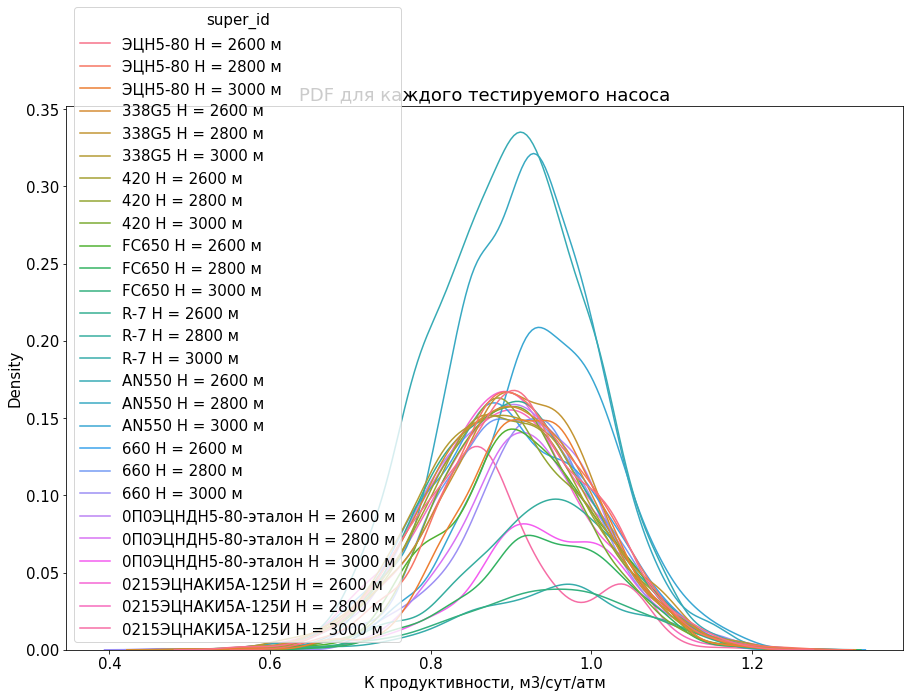

In [48]:
sns.kdeplot(data=big_df, x="pi_sm3dayatm", hue="super_id")
plt.title('PDF для каждого тестируемого насоса')
plt.xlabel('К продуктивности, м3/сут/атм')

### КПД от дебита жидкости

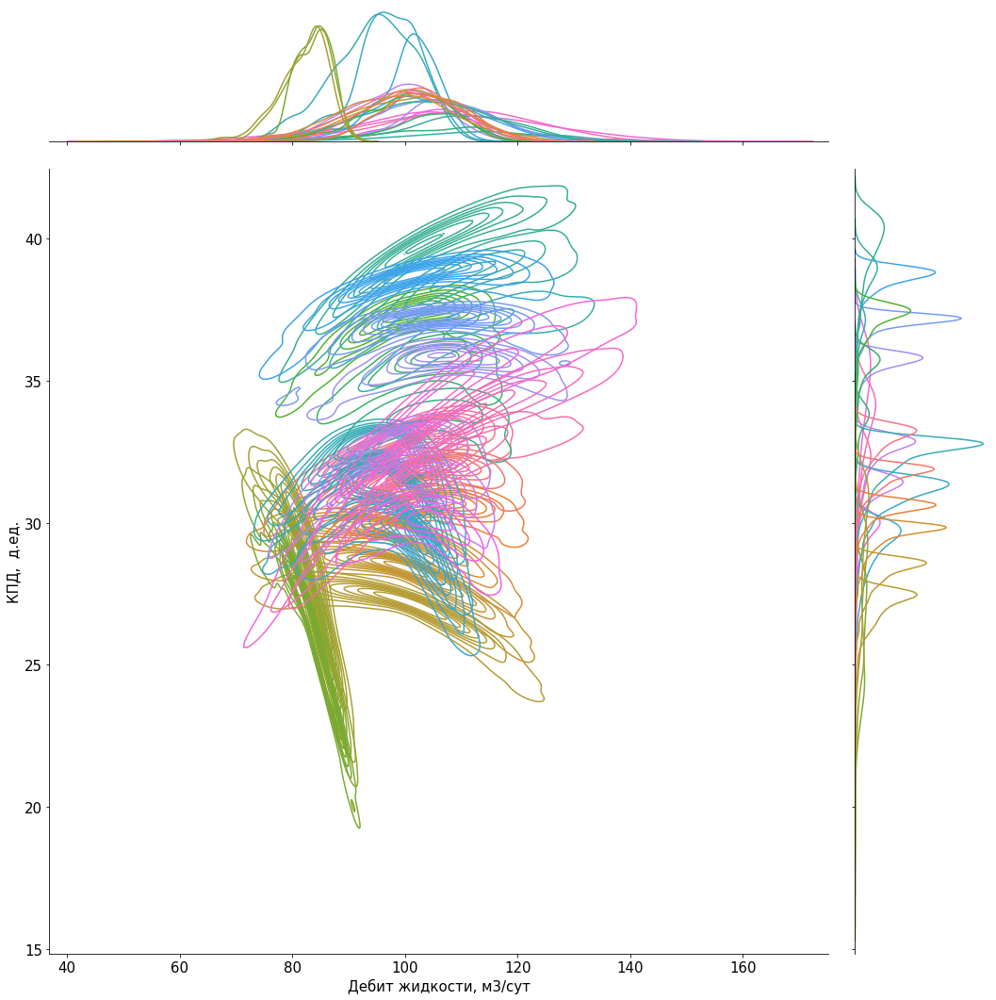

In [49]:
#sns.set(font_scale=1.5) 
big_df_to_plot = big_df.copy()
big_df_to_plot = big_df_to_plot.rename(columns = {'lqliq': 'Дебит жидкости, м3/сут',
                                                 'leff': 'КПД,  д.ед.',
                                                 'super_id': 'ЭЦН',
                                                 })

r = sns.jointplot(
    data=big_df_to_plot,
    x="Дебит жидкости, м3/сут", y= 'КПД,  д.ед.', hue="ЭЦН",
    kind="kde",
    legend = False,
    height=15,
)



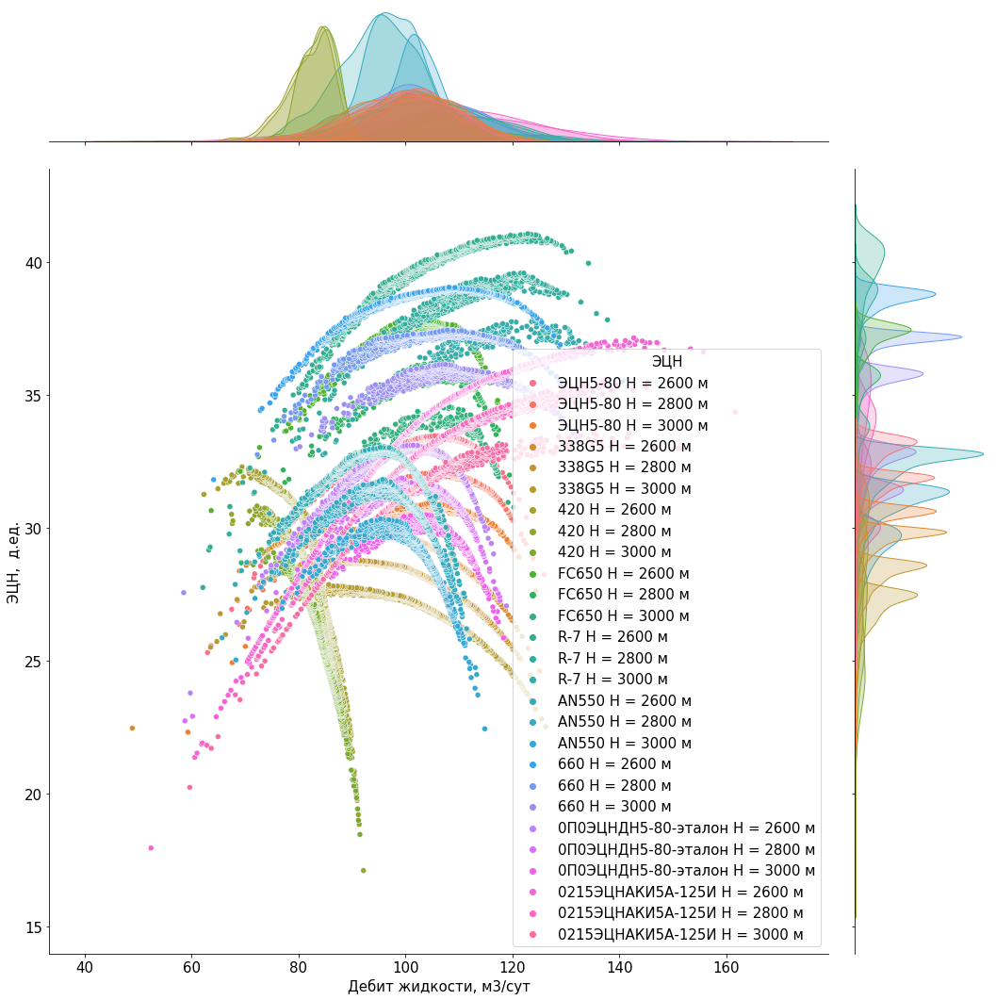

In [50]:
#sns.set(font_scale=1.5) 
big_df_to_plot = big_df.copy()
big_df_to_plot = big_df_to_plot.rename(columns = {'lqliq': 'Дебит жидкости, м3/сут',
                                                 'leff': 'ЭЦН,  д.ед.',
                                                 'super_id': 'ЭЦН',
                                                 })
sns.jointplot(
    data=big_df_to_plot,
    x="Дебит жидкости, м3/сут", y= 'ЭЦН,  д.ед.', hue="ЭЦН",
    #kind="kde",
    legend = True,
    height=15
)


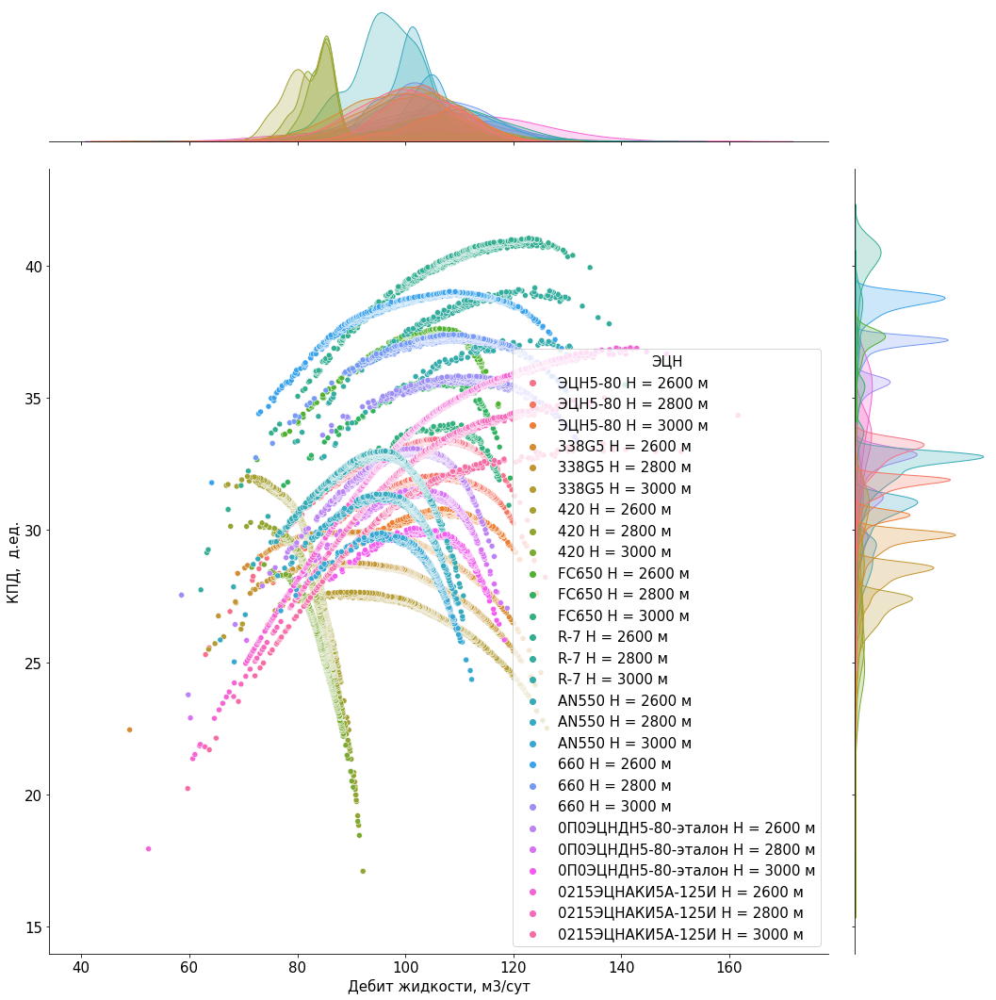

In [51]:
#sns.set(font_scale=1.5) 
big_df_to_plot = big_df[big_df['nodal_error_p_dis'] <2].copy()
big_df_to_plot = big_df_to_plot.rename(columns = {'lqliq': 'Дебит жидкости, м3/сут',
                                                 'leff': 'КПД,  д.ед.',
                                                 'super_id': 'ЭЦН',
                                                 })
sns.jointplot(
    data=big_df_to_plot,
    x="Дебит жидкости, м3/сут", y= 'КПД,  д.ед.', hue="ЭЦН",
    #kind="kde",
    legend = True,
    height=15
)

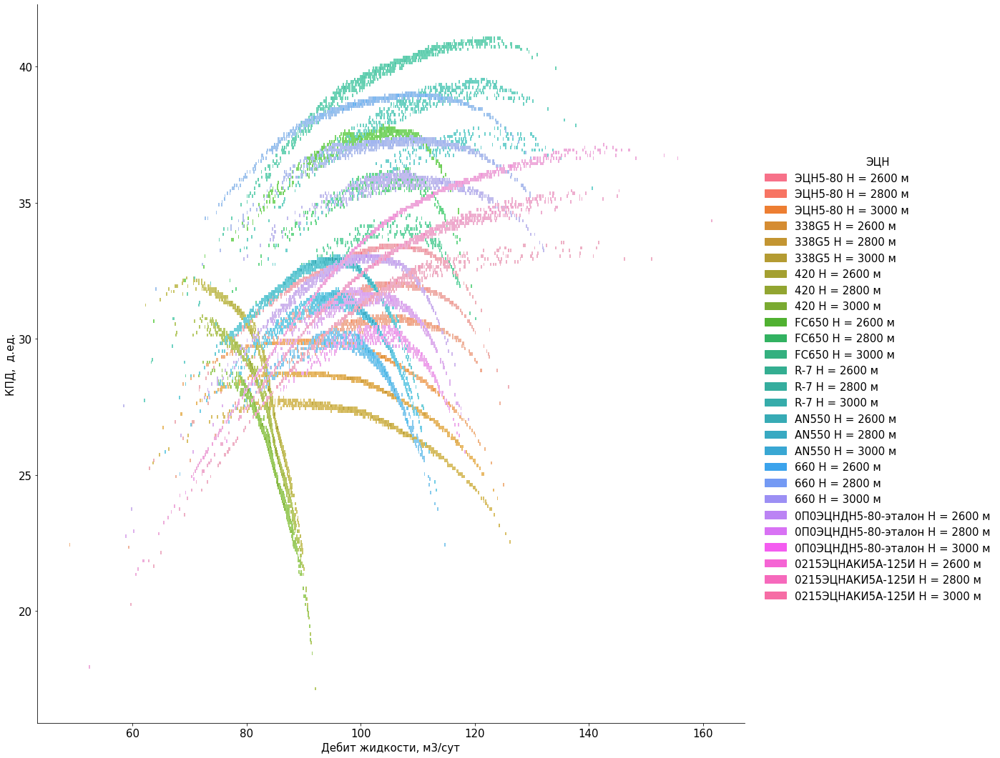

In [52]:
#sns.set(font_scale=1.5) 
big_df_to_plot = big_df.copy()
big_df_to_plot = big_df_to_plot.rename(columns = {'lqliq': 'Дебит жидкости, м3/сут',
                                                 'leff': 'КПД,  д.ед.',
                                                 'super_id': 'ЭЦН',
                                                 })
sns.displot(
    data=big_df_to_plot,
    x="Дебит жидкости, м3/сут", y= 'КПД,  д.ед.', hue="ЭЦН",
    #kind="kde",
    binwidth=(0.1, 0.1),
    legend = True,
    height=15
)


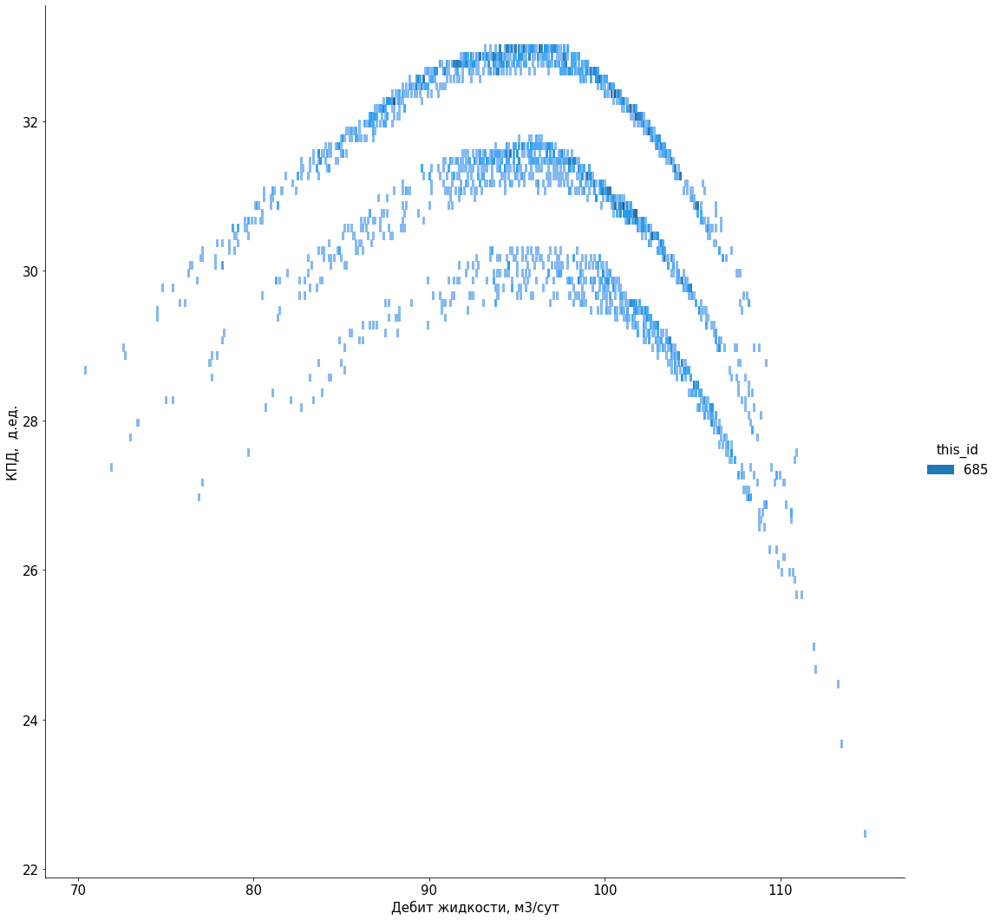

In [53]:
#sns.set(font_scale=1.5) 
big_df_to_plot = big_df.copy()
big_df_to_plot['this_id'] = big_df_to_plot['this_id'].astype(str)
big_df_to_plot = big_df_to_plot[big_df_to_plot['this_id'].isin(['685'])]
big_df_to_plot = big_df_to_plot.rename(columns = {'lqliq': 'Дебит жидкости, м3/сут',
                                                 'leff': 'КПД,  д.ед.',
                                                 'super_id': 'ЭЦН',
                                                 })
sns.displot(
    data=big_df_to_plot,
    x="Дебит жидкости, м3/сут", y= 'КПД,  д.ед.', hue="this_id",
    #kind="kde",
    binwidth=(0.1, 0.1),
    legend = True,
    height=15
)


(15.0, 43.0)

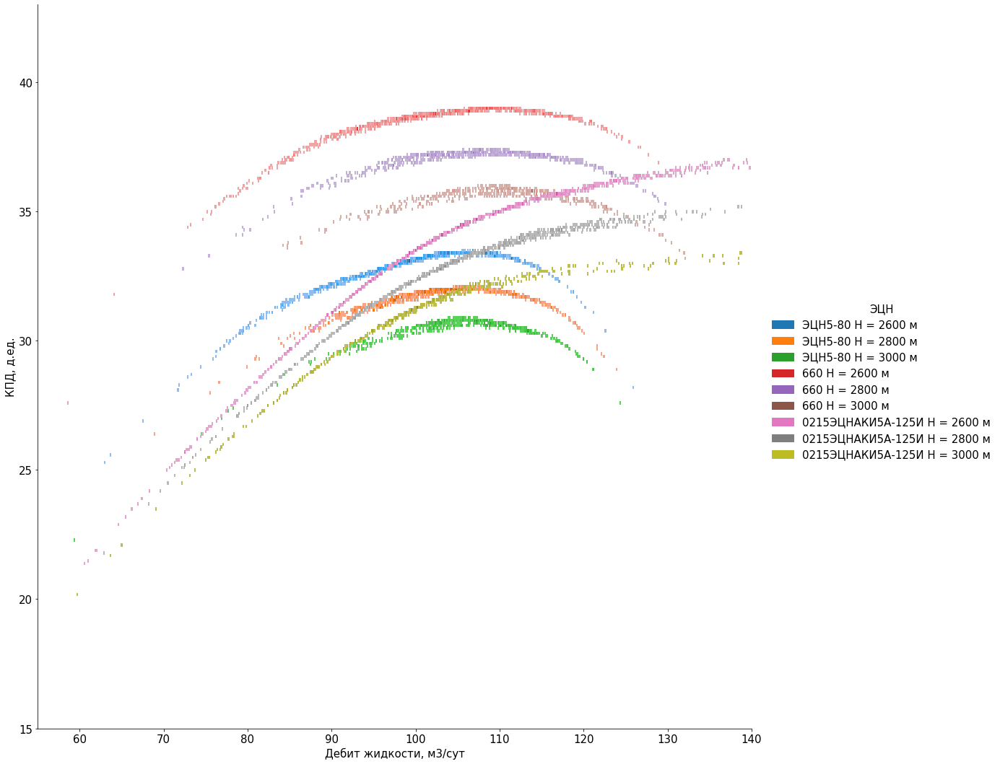

In [54]:
#sns.set(font_scale=1.5) 
big_df_to_plot = big_df[big_df['nodal_error_p_dis']<3].copy()
big_df_to_plot = big_df_to_plot[big_df_to_plot['super_id'].isin([
    
    '0215ЭЦНАКИ5А-125И H = 2600 м',
       '0215ЭЦНАКИ5А-125И H = 2800 м', '0215ЭЦНАКИ5А-125И H = 3000 м',
    
    '660 H = 2600 м', '660 H = 2800 м', '660 H = 3000 м',
'ЭЦН5-80 H = 2600 м', 'ЭЦН5-80 H = 2800 м', 'ЭЦН5-80 H = 3000 м'
])]
big_df_to_plot = big_df_to_plot[big_df_to_plot['this_id'] != 685]
big_df_to_plot = big_df_to_plot.rename(columns = {'lqliq': 'Дебит жидкости, м3/сут',
                                                 'leff': 'КПД, д.ед.',
                                                 'super_id': 'ЭЦН',
                                                 })
distplot = sns.displot(
    data=big_df_to_plot,
    x="Дебит жидкости, м3/сут", y= 'КПД, д.ед.', hue="ЭЦН",
    #kind="kde",
    binwidth=(0.1, 0.1),
    legend = True,
    height=15,
)

plt.xlim((55, 140))
plt.ylim((15, 43))

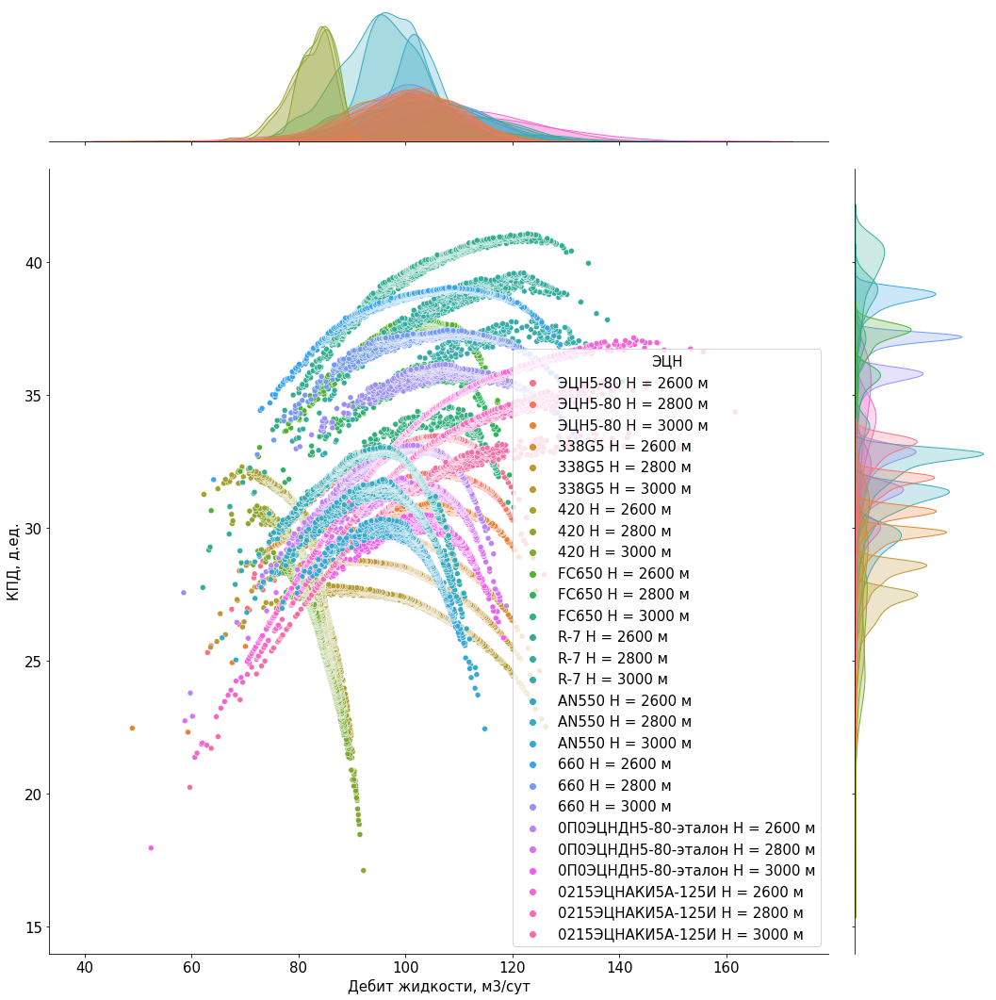

In [55]:
#sns.set(font_scale=1.5) 
big_df_to_plot = big_df.copy()
big_df_to_plot = big_df_to_plot.rename(columns = {'lqliq': 'Дебит жидкости, м3/сут',
                                                 'leff': 'КПД, д.ед.',
                                                 'super_id': 'ЭЦН',
                                                 })
sns.jointplot(
    data=big_df_to_plot,
    x="Дебит жидкости, м3/сут", y= 'КПД, д.ед.', hue="ЭЦН",
    #kind="kde",
    #binwidth=(0.1, 0.1),
    legend = True,
    height=15
)

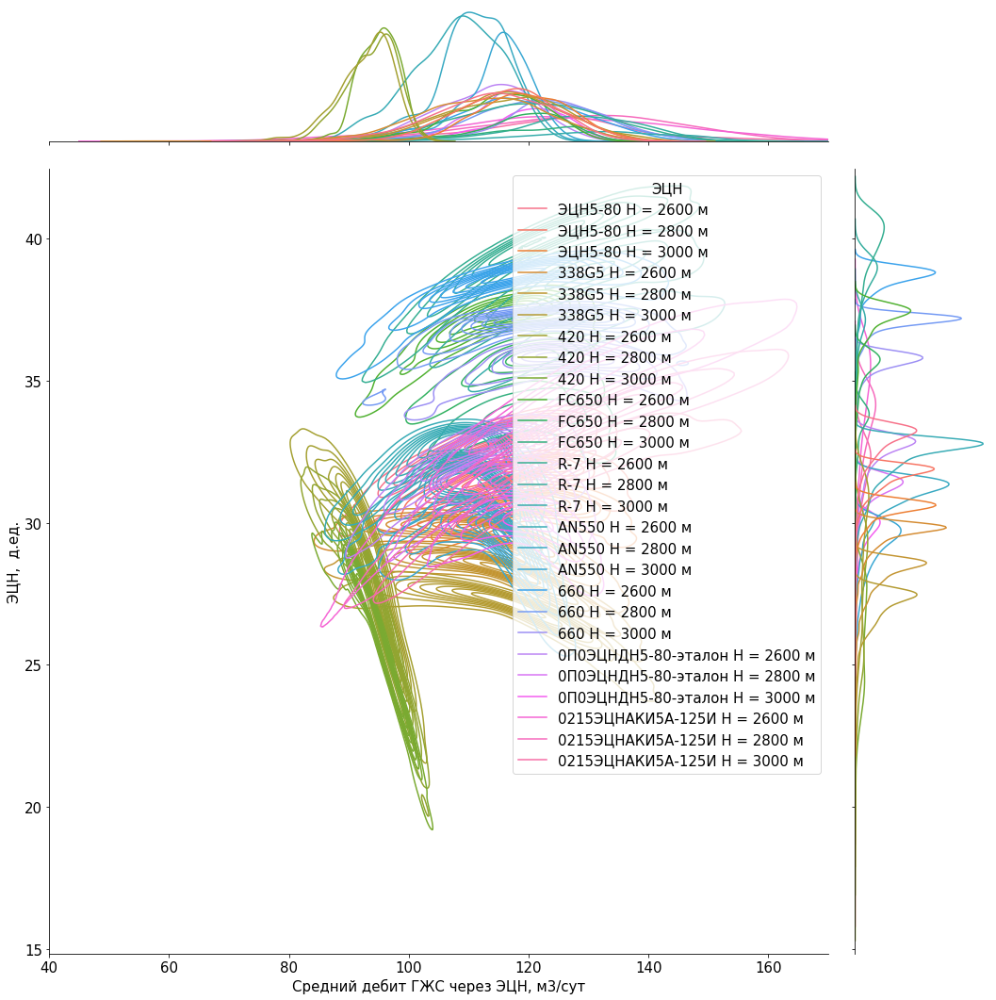

In [56]:
#sns.set(font_scale=1.5) 
big_df_to_plot = big_df.copy()
big_df_to_plot = big_df_to_plot.rename(columns = {'lqliq': 'Дебит жидкости, м3/сут',
                                                 'leff': 'ЭЦН,  д.ед.',
                                                 'super_id': 'ЭЦН',
                                                  'lq_mix_pump_mean': 'Средний дебит ГЖС через ЭЦН, м3/сут'
                                                 })


sns.jointplot(
    data=big_df_to_plot,
    x='Средний дебит ГЖС через ЭЦН, м3/сут', y= 'ЭЦН,  д.ед.', hue="ЭЦН",
    kind="kde",
    legend = True,
    height=15,
    xlim = (40, 170)
)



No handles with labels found to put in legend.


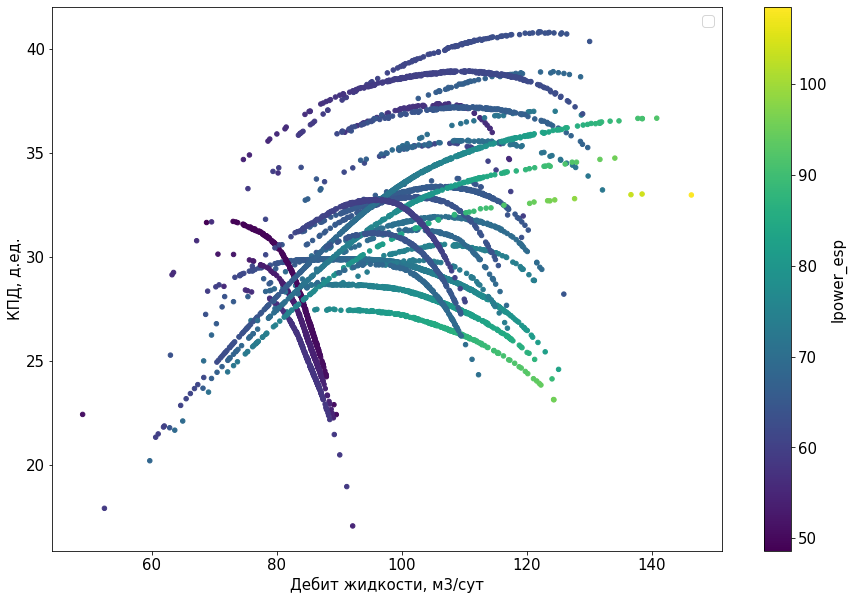

In [57]:
fig, ax = plt.subplots()
big_df[big_df['nodal_error_p_dis']<0.5].plot.scatter(x="lqliq", y="leff", c="lpower_esp", legend=True, colormap='viridis', ax=ax)
plt.legend()
plt.xlabel('Дебит жидкости, м3/сут')
plt.ylabel('КПД, д.ед.')

plt.show()

### Боксплоты

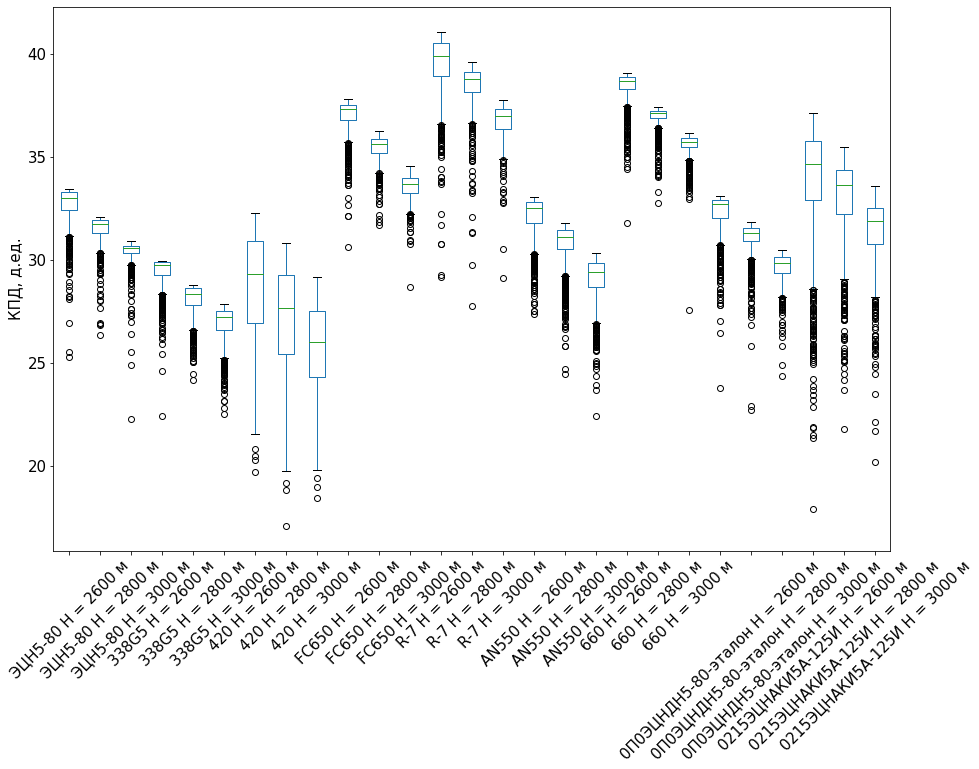

In [58]:
df_for_box = pd.DataFrame({x: big_df[big_df['super_id'] == x]['leff'].reset_index(drop=True)  for x in big_df['super_id'].unique()},
                          
                          
                          index=range(10000))
df_for_box.plot.box()
plt.xticks(rotation = 45)
plt.ylabel('КПД, д.ед.')
plt.show()

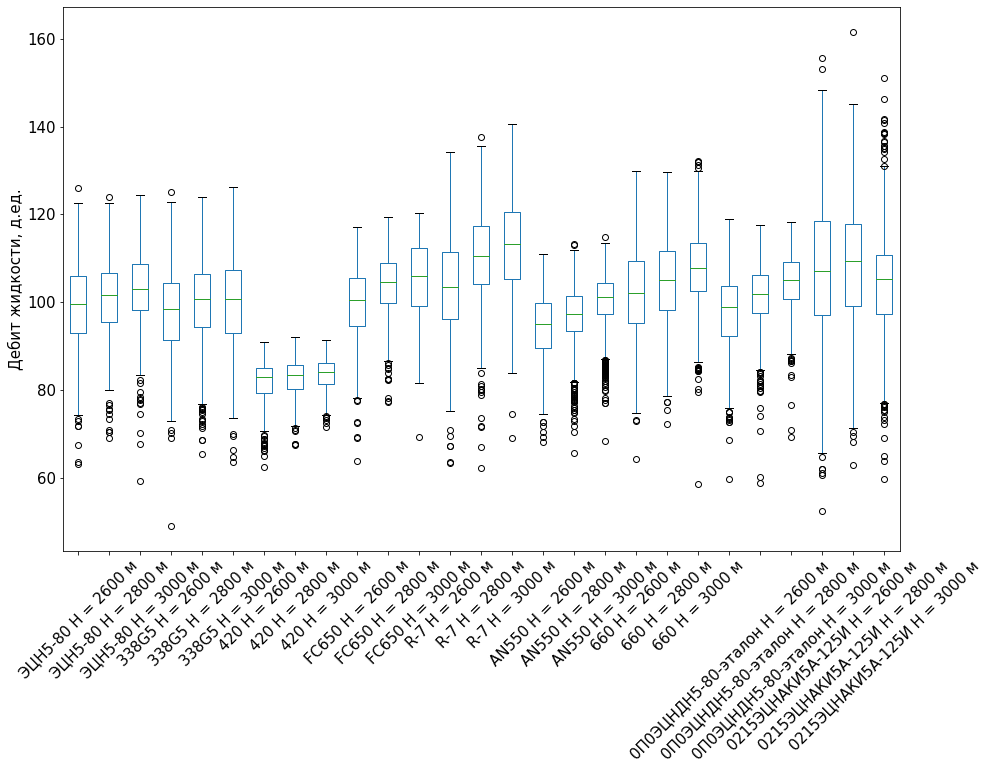

In [59]:
df_for_box = pd.DataFrame({x: big_df[big_df['super_id'] == x]['lqliq'].reset_index(drop=True)  for x in big_df['super_id'].unique()},
                          
                          index=range(3000))
df_for_box.plot.box()
plt.xticks(rotation = 45)
plt.ylabel('Дебит жидкости, д.ед.')
plt.show()

### Violin plot

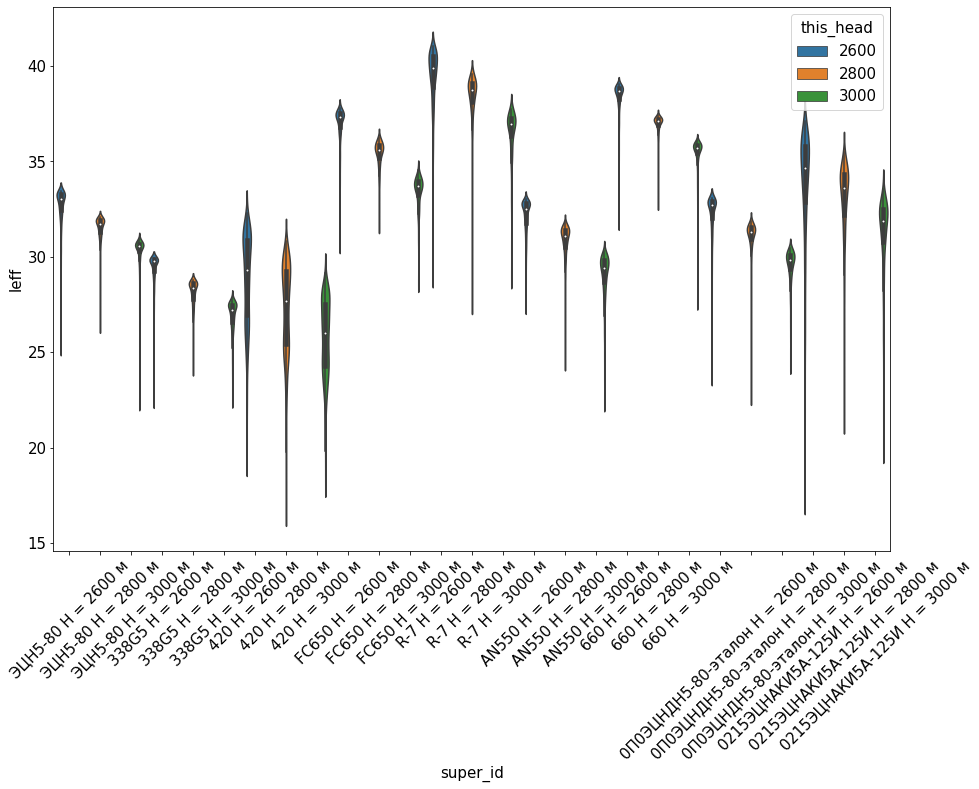

In [60]:
sns.violinplot(x="super_id", y="leff", hue="this_head",
                    data=big_df,
               #palette="muted",
               #split=True
               #scale="lqliq"
              )
plt.xticks(rotation = 45)
plt.show()

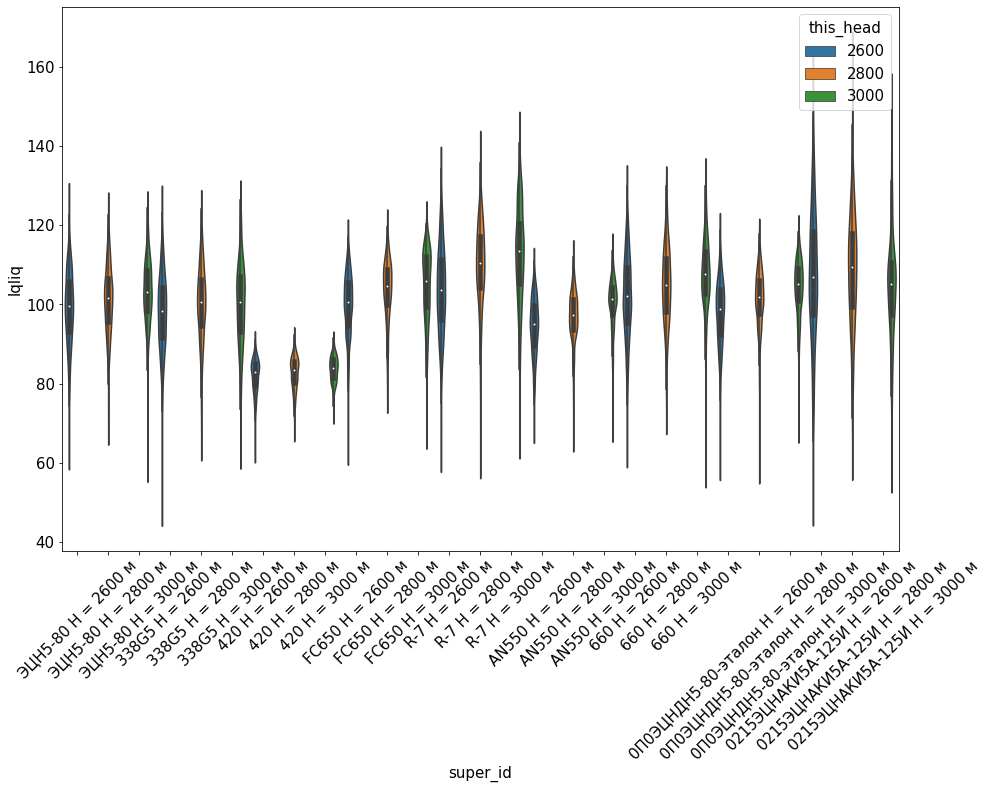

In [61]:
sns.violinplot(x="super_id", y="lqliq", hue="this_head",
                    data=big_df,
               #width = 0.8,
               #palette="muted",
               #split=True
               #scale="lqliq"
               #scale='width'
              )
plt.xticks(rotation = 45)
plt.show()

## Один насос

In [62]:
pumps_in_big_df

,ID,source,manufacturer,name,stages_max,rate_nom_sm3day,rate_opt_min_sm3day,rate_opt_max_sm3day,rate_max_sm3day,slip_nom_rpm,...,power_limit_shaft_kW,power_limit_shaft_high_kW,power_limit_shaft_max_kW,pressure_limit_housing_atma,d_motor_od_mm,rate_points,head_points,power_points,eff_points,max_eff
1185,1185,legacy,Алмаз,ЭЦН5-80,784,80,60,115,140,2910,...,72,120,150,390,95,"[0.0, 10.0, 20.0, 30.0, 40.0, 50.0, 60.0, 70.0...","[5.0, 5.08, 5.14, 5.17, 5.2, 5.2, 5.16, 4.94, ...","[0.07, 0.0745, 0.078, 0.0806, 0.0826, 0.084, 0...","[0.0, 0.09, 0.168, 0.233, 0.294, 0.356, 0.412,...",0.487000
226,226,legacy,Centrilift,338G5,34,66,53,93,143.94,2917,...,72,120,150,390,95,"[0.0, 4.55, 9.7, 14.55, 19.7, 29.7, 39.7, 50.0...","[4.26, 4.31, 4.38, 4.47, 4.56, 4.72, 4.8, 4.8,...","[0.0475867206, 0.0477338202, 0.0483222186, 0.0...","[0.0, 0.045, 0.096, 0.143, 0.19, 0.272, 0.339,...",0.435000
1093,1093,legacy,Weatherford,420,232,72,50.8759,95.3924,111.032,3500,...,72,120,150,390,95,"[4.0, 7.0, 11.0, 15.0, 19.0, 22.0, 26.0, 30.0,...","[9.327, 9.281, 9.2417, 9.2048, 9.1667, 9.1235,...","[0.0949739688, 0.0954520721, 0.0964641332, 0.0...","[0.0413647989, 0.081909546, 0.1210598477, 0.15...",0.497676
649,649,legacy,ODI,R-7,483,95,66.2447,119.24,160.551,3500,...,72,120,150,390,95,"[5.0, 10.8333333333, 15.8333333333, 20.8333333...","[7.1245138889, 7.108125, 7.0874305556, 7.06291...","[0.0729113275, 0.0749517802, 0.0769383464, 0.0...","[0.0583073714, 0.1131783134, 0.1649027463, 0.2...",0.617420
1162,1162,legacy,Алмаз,0П0ЭЦНДН5-80-эталон,600,80,60,105,129.15,2910,...,72,120,150,390,95,"[0.0, 10.0, 20.0, 30.0, 40.0, 50.0, 60.0, 65.0...","[5.42, 5.43, 5.41, 5.38, 5.33, 5.26, 5.14, 5.0...","[0.0596, 0.0612, 0.0662, 0.0726, 0.0786, 0.083...","[0.0, 0.1007, 0.1857, 0.2523, 0.308, 0.3582, 0...",0.489200
684,684,legacy,Reda,AN550,604,74.1667,52.9958,92.7426,118.444,3500,...,72,120,150,390,95,"[4.1666666667, 8.3333333333, 11.6666666667, 15...","[4.7048611111, 4.6921527778, 4.6629861111, 4.6...","[0.0438298915, 0.0442117836, 0.0444548903, 0.0...","[0.0484432926, 0.0957898352, 0.1420105051, 0.1...",0.480181
1258,1258,legacy,Алнас,0215ЭЦНАКИ5А-125И,459,125,75,125,234.684,2917,...,72,120,150,390,95,"[0.0, 15.0, 30.0, 45.0, 60.0, 75.0, 90.0, 105....","[8.2, 8.28, 8.28, 8.3, 8.3, 8.28, 8.25, 8.19, ...","[0.1231, 0.1303, 0.1325, 0.1314, 0.1353, 0.146...","[0.0, 0.105, 0.214, 0.312, 0.399, 0.475, 0.526...",0.572000
685,685,legacy,Reda,AN550,604,89,63.5949,111.291,142.133,3500,...,72,120,150,390,95,"[5.0, 10.0, 14.0, 19.0, 24.0, 29.0, 33.0, 38.0...","[6.775, 6.7567, 6.7147, 6.6525, 6.5734, 6.4803...","[0.0757380524, 0.0763979621, 0.0768180505, 0.0...","[0.0484432926, 0.0957898352, 0.1420105051, 0.1...",0.480181
1111,1111,legacy,Weatherford,660,230,103,71.5443,127.19,185.574,3500,...,72,120,150,390,95,"[6.0, 12.0, 18.0, 24.0, 30.0, 37.0, 43.0, 49.0...","[10.1126, 10.0987, 10.1076, 10.1281, 10.1499, ...","[0.0996977827, 0.103029485, 0.1069979843, 0.11...","[0.0701891114, 0.1356526998, 0.1961054373, 0.2...",0.588025
412,412,legacy,Centrilift,FC650,305,83.3333,59.6202,105.992,127.709,3500,...,72,120,150,390,95,"[4.1666666667, 8.3333333333, 13.3333333333, 17...","[7.0052083333, 6.9961805556, 6.9904861111, 6.9...","[0.0663661269, 0.0664180765, 0.0669840895, 0.0...","[0.0518698182, 0.1035249169, 0.1538503923, 0.2...",0.568911


In [63]:
this_pump

,ID,source,manufacturer,name,stages_max,rate_nom_sm3day,rate_opt_min_sm3day,rate_opt_max_sm3day,rate_max_sm3day,slip_nom_rpm,...,power_limit_shaft_kW,power_limit_shaft_high_kW,power_limit_shaft_max_kW,pressure_limit_housing_atma,d_motor_od_mm,rate_points,head_points,power_points,eff_points,number_of_point_in_curves
1185,1185,legacy,Алмаз,ЭЦН5-80,784,80,60,115,140,2910,...,72,120,150,390,95,"[0.0, 10.0, 20.0, 30.0, 40.0, 50.0, 60.0, 70.0...","[5.0, 5.08, 5.14, 5.17, 5.2, 5.2, 5.16, 4.94, ...","[0.07, 0.0745, 0.078, 0.0806, 0.0826, 0.084, 0...","[0.0, 0.09, 0.168, 0.233, 0.294, 0.356, 0.412,...",15


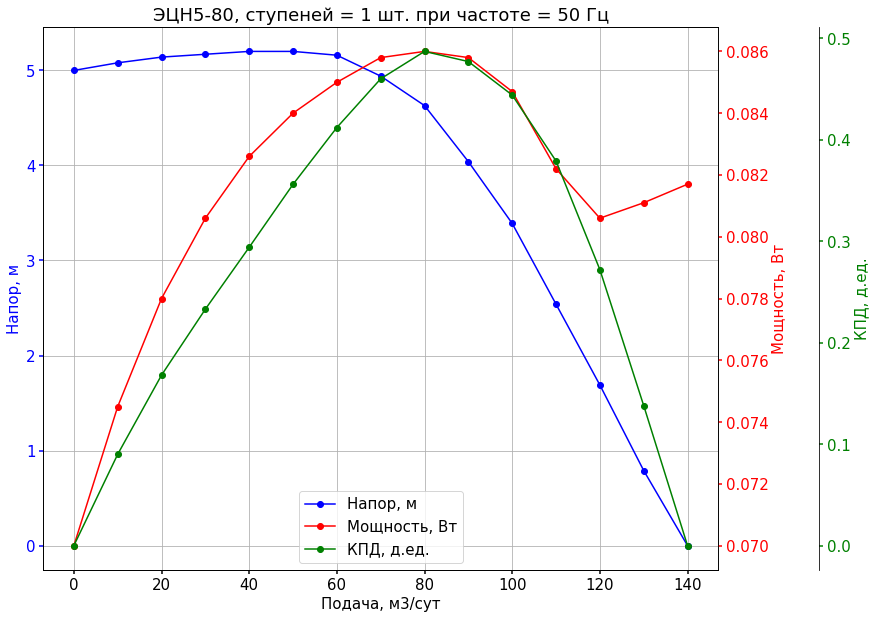

In [65]:
this_pump = db_df[db_df['ID'] == 1185].iloc[0]

q_arr = np.array(this_pump['rate_points'])
h_esp_arr = np.array(this_pump['head_points'])
power_esp_arr = np.array(this_pump['power_points']) 
efficiency_esp_arr = np.array(this_pump['eff_points'])

well_model.plot_pump_curve(q_arr,
    h_esp_arr,
    power_esp_arr,
    efficiency_esp_arr,
    1,
    this_pump['name'],
    )

In [66]:
 big_df['super_id'].unique()

array(['ЭЦН5-80 H = 2600 м', 'ЭЦН5-80 H = 2800 м', 'ЭЦН5-80 H = 3000 м',
       '338G5 H = 2600 м', '338G5 H = 2800 м', '338G5 H = 3000 м',
       '420 H = 2600 м', '420 H = 2800 м', '420 H = 3000 м',
       'FC650 H = 2600 м', 'FC650 H = 2800 м', 'FC650 H = 3000 м',
       'R-7 H = 2600 м', 'R-7 H = 2800 м', 'R-7 H = 3000 м',
       'AN550 H = 2600 м', 'AN550 H = 2800 м', 'AN550 H = 3000 м',
       '660 H = 2600 м', '660 H = 2800 м', '660 H = 3000 м',
       '0П0ЭЦНДН5-80-эталон H = 2600 м', '0П0ЭЦНДН5-80-эталон H = 2800 м',
       '0П0ЭЦНДН5-80-эталон H = 3000 м', '0215ЭЦНАКИ5А-125И H = 2600 м',
       '0215ЭЦНАКИ5А-125И H = 2800 м', '0215ЭЦНАКИ5А-125И H = 3000 м'],
      dtype=object)

In [67]:
this_super_id = 'ЭЦН5-80 H = 2800 м'

<AxesSubplot:xlabel='lqliq', ylabel='leff'>

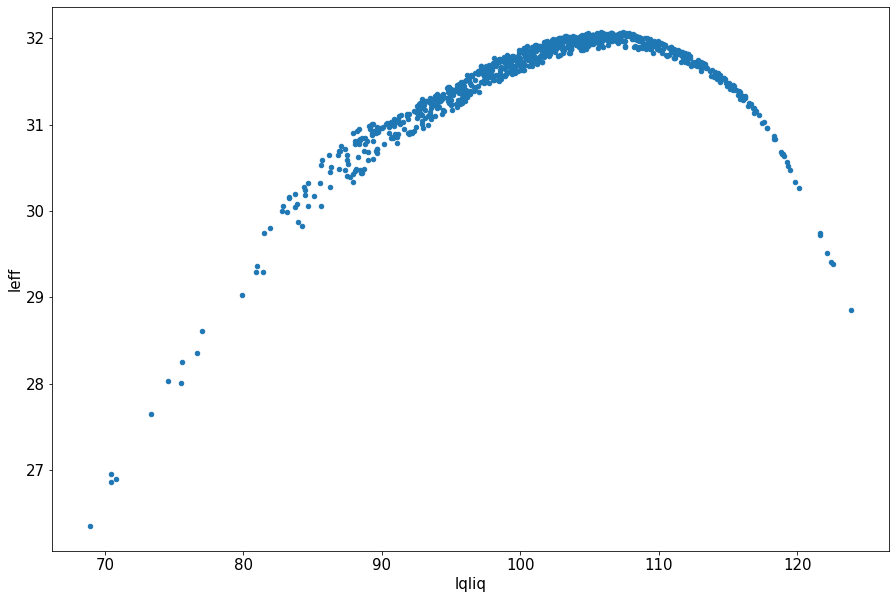

In [68]:
one_pump = big_df[big_df['super_id'] == this_super_id]
one_pump.plot.scatter(x = 'lqliq', y = 'leff')

No handles with labels found to put in legend.


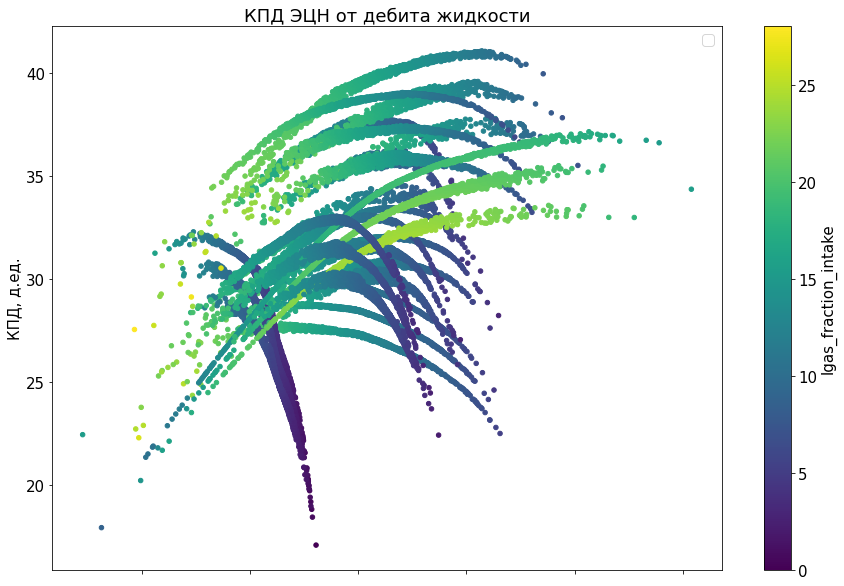

In [69]:
big_df.plot.scatter(x="lqliq", y="leff", c="lgas_fraction_intake", legend=True, colormap='viridis')
plt.legend()
plt.xlabel('Дебит жидкости, м3/сут')
plt.ylabel('КПД, д.ед.')
plt.title('КПД ЭЦН от дебита жидкости')

plt.show()

No handles with labels found to put in legend.


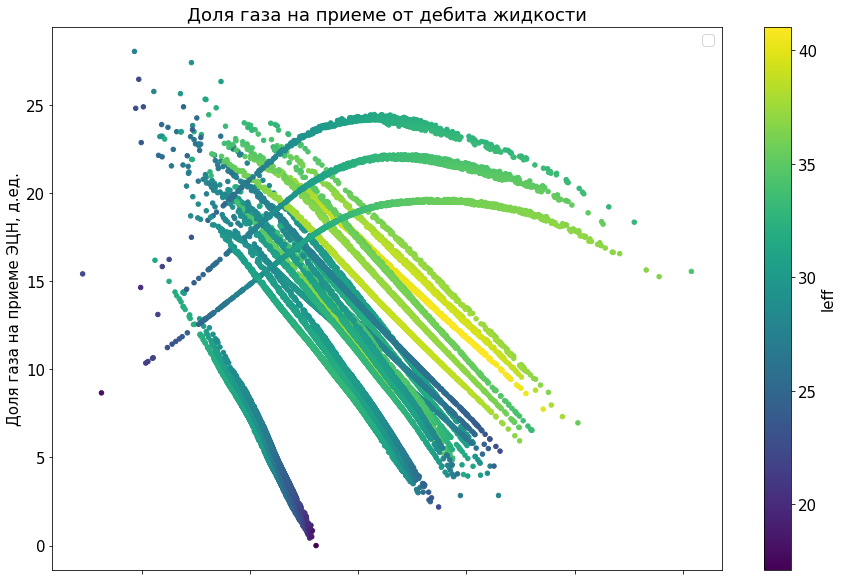

In [70]:
big_df.plot.scatter(x="lqliq", y="lgas_fraction_intake", c="leff", colormap='viridis')
plt.xlabel('Дебит жидкости, м3/сут')
plt.ylabel('Доля газа на приеме ЭЦН, д.ед.')
plt.legend()
plt.title('Доля газа на приеме от дебита жидкости')
plt.show()

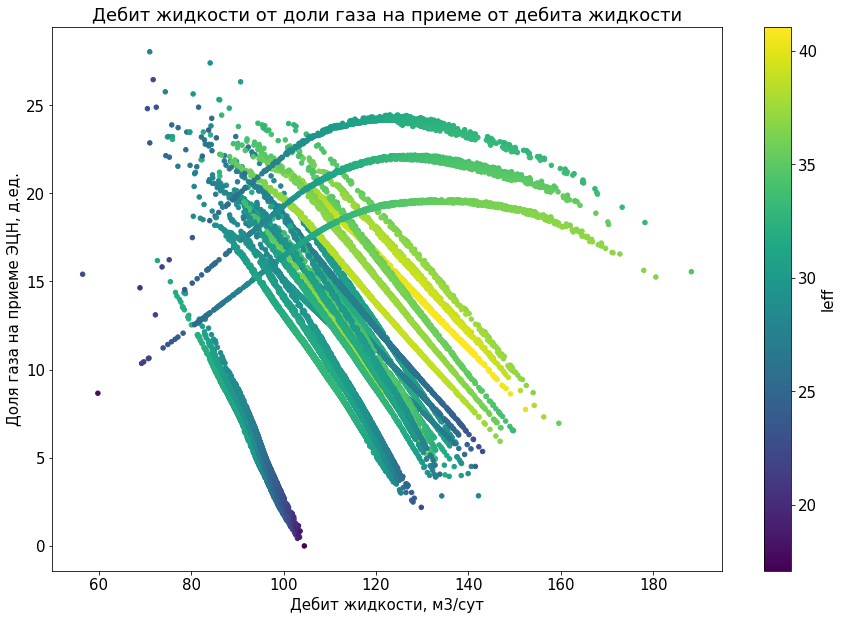

In [71]:
fig, ax = plt.subplots()

big_df.plot.scatter(ax = ax, x="lq_mix_pump_mean", y="lgas_fraction_intake", c="leff", colormap='viridis')



plt.xlabel('Дебит жидкости, м3/сут')

plt.ylabel('Доля газа на приеме ЭЦН, д.ед.')


plt.title('Дебит жидкости от доли газа на приеме от дебита жидкости')

plt.show()

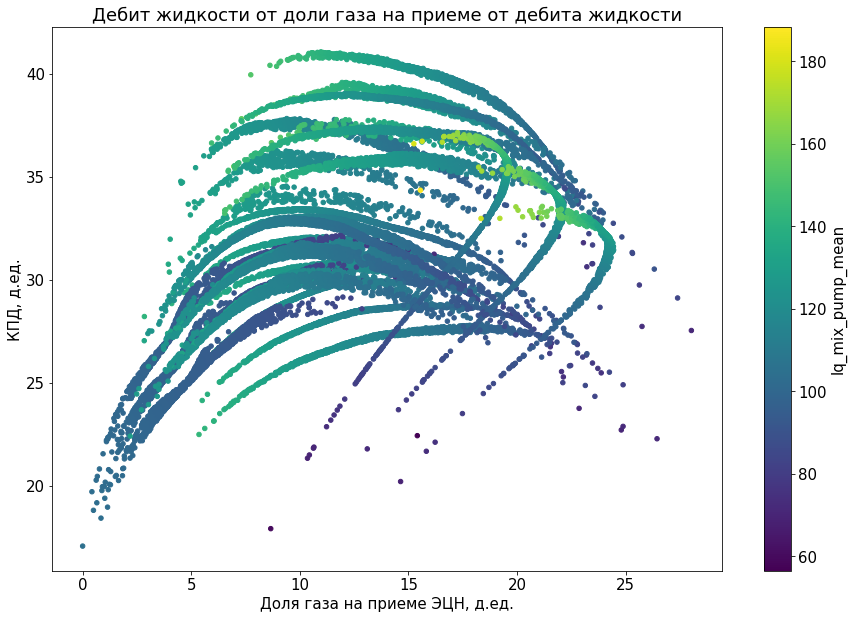

In [72]:
fig, ax = plt.subplots()

big_df.plot.scatter(ax = ax, x="lgas_fraction_intake", y="leff", 
                    c="lq_mix_pump_mean",
                    colormap='viridis')


plt.xlabel('Доля газа на приеме ЭЦН, д.ед.')

plt.ylabel('КПД, д.ед.')



plt.title('Дебит жидкости от доли газа на приеме от дебита жидкости')

plt.show()

No handles with labels found to put in legend.


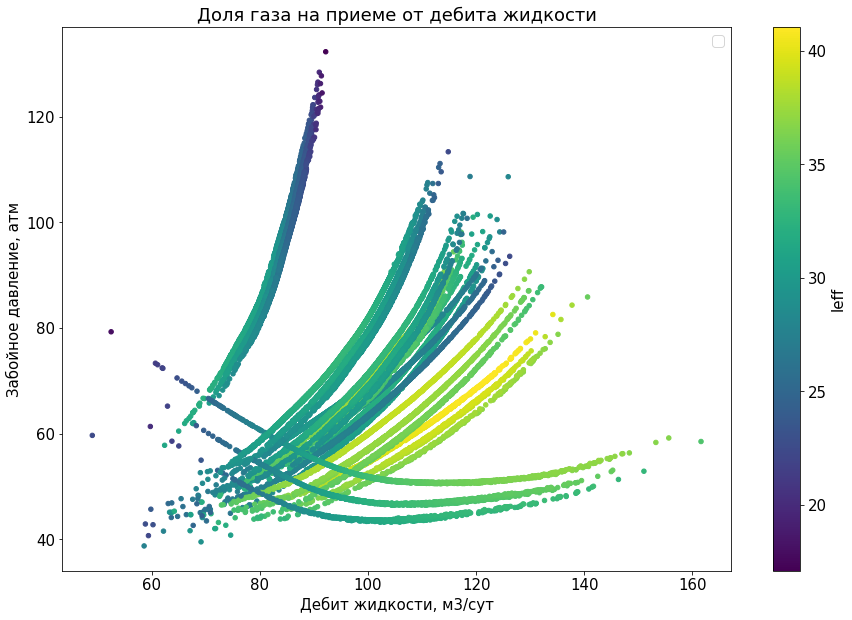

In [73]:
fig, ax = plt.subplots()

big_df.plot.scatter(ax = ax, x="lqliq", y="lp_bhp_atm", c="leff", colormap='viridis')
plt.xlabel('Дебит жидкости, м3/сут')
plt.ylabel('Забойное давление, атм')
plt.legend()
plt.title('Доля газа на приеме от дебита жидкости')
plt.show()
#pi_sm3dayatm

No handles with labels found to put in legend.


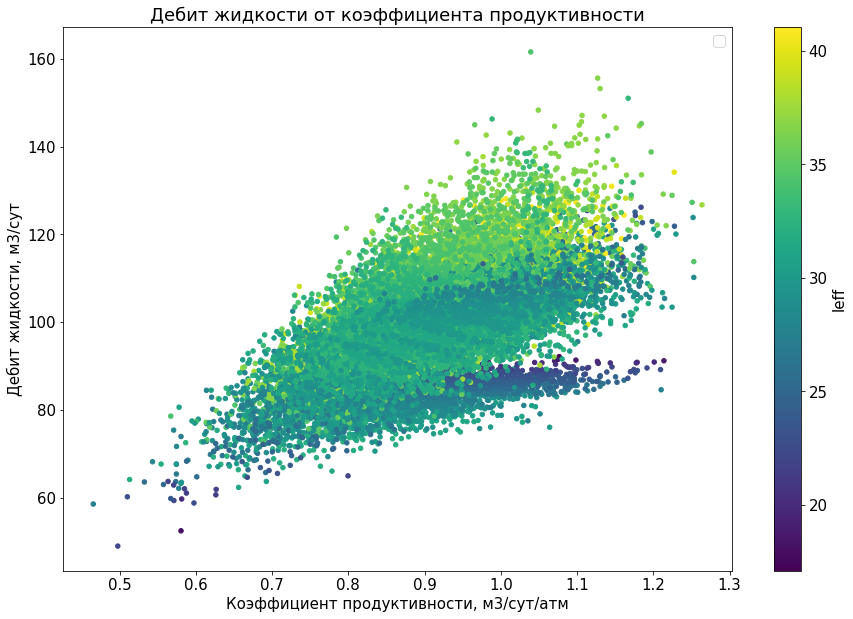

In [74]:
fig, ax = plt.subplots()

big_df.plot.scatter(ax = ax, x="pi_sm3dayatm", y="lqliq", c="leff", colormap='viridis')
plt.xlabel('Коэффициент продуктивности, м3/сут/атм')
plt.ylabel('Дебит жидкости, м3/сут')
plt.legend()
plt.title('Дебит жидкости от коэффициента продуктивности')
plt.show()
#pi_sm3dayatm

No handles with labels found to put in legend.


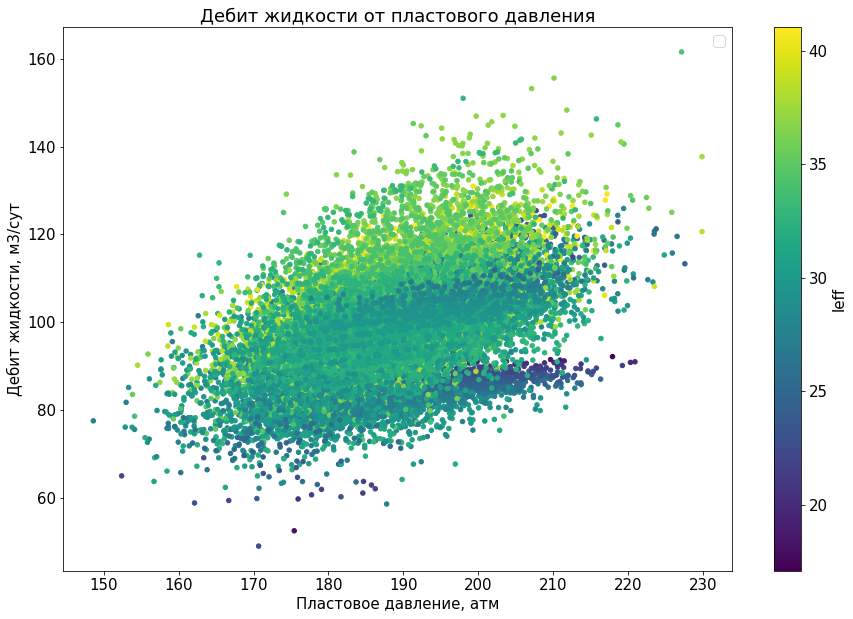

In [75]:
fig, ax = plt.subplots()

big_df.plot.scatter(ax = ax, x="pres_atma", y="lqliq", c="leff", colormap='viridis')
plt.xlabel('Пластовое давление, атм')
plt.ylabel('Дебит жидкости, м3/сут')
plt.legend()
plt.title('Дебит жидкости от пластового давления')
plt.show()

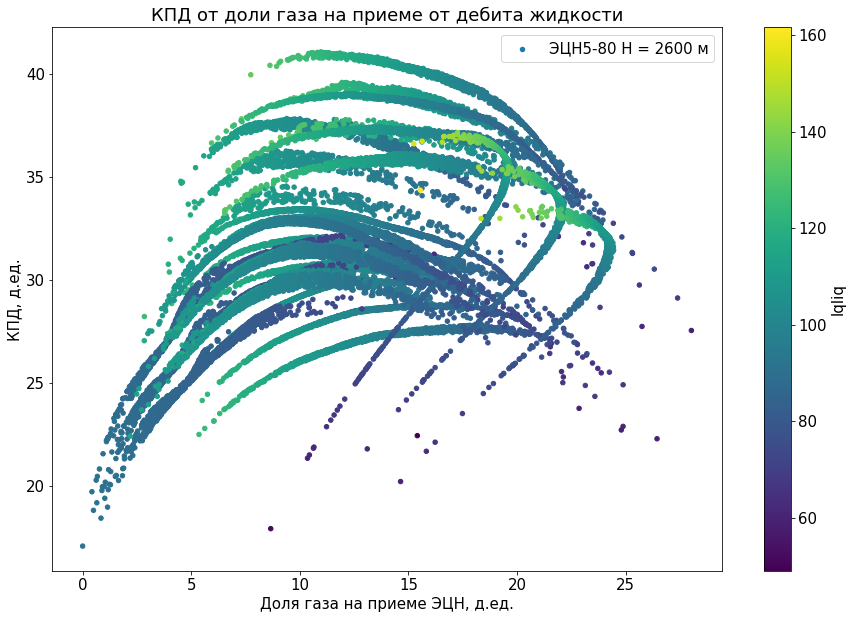

In [76]:
fig, ax = plt.subplots()

big_df.plot.scatter(ax = ax, x="lgas_fraction_intake", y="leff", c="lqliq", colormap='viridis')

ax.legend(list(big_df['super_id'].unique()))


plt.ylabel('КПД, д.ед.')

plt.xlabel('Доля газа на приеме ЭЦН, д.ед.')


plt.title('КПД от доли газа на приеме от дебита жидкости')


plt.show()

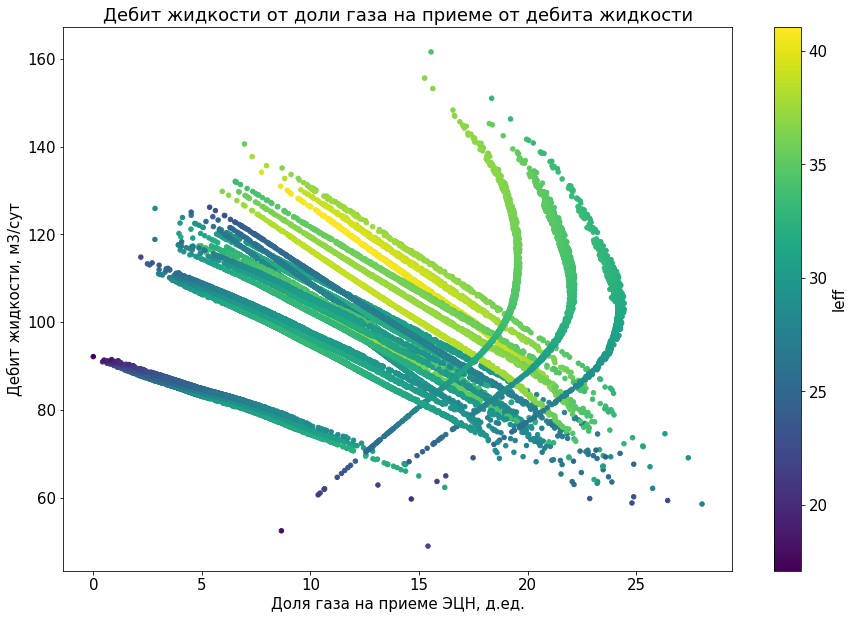

In [77]:
fig, ax = plt.subplots()

big_df.plot.scatter(ax = ax, x="lgas_fraction_intake", y="lqliq", c="leff", colormap='viridis')



plt.ylabel('Дебит жидкости, м3/сут')

plt.xlabel('Доля газа на приеме ЭЦН, д.ед.')


plt.title('Дебит жидкости от доли газа на приеме от дебита жидкости')

plt.show()

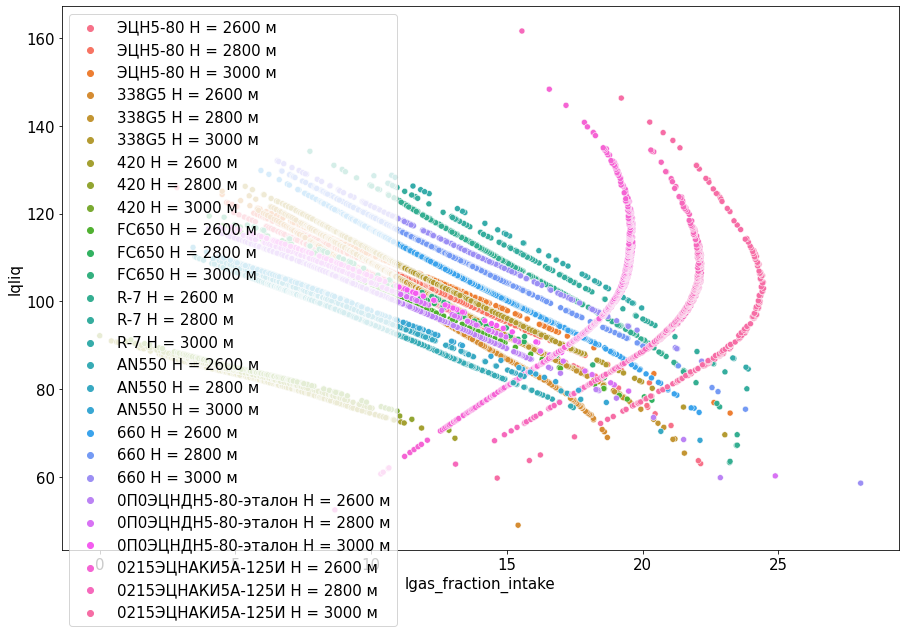

In [78]:
fig,ax = plt.subplots()
sns.scatterplot(data=big_df[big_df['nodal_error_p_dis']<1].copy(), hue='super_id', x='lgas_fraction_intake', y='lqliq')
plt.legend(loc=2)
plt.savefig('scatter.png')
plt.show()

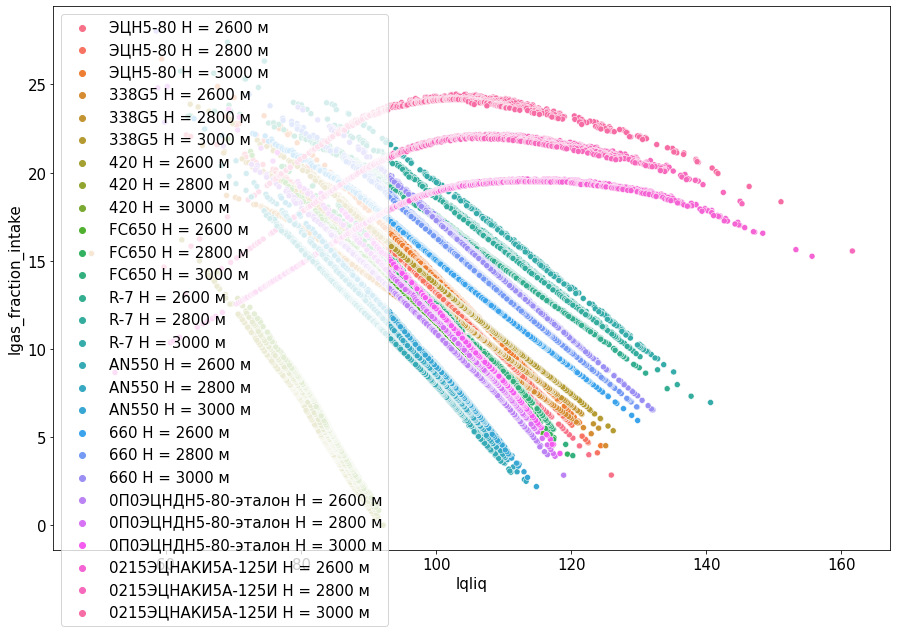

In [79]:
fig,ax = plt.subplots()
sns.scatterplot(data=big_df, hue='super_id', x='lqliq', y='lgas_fraction_intake')
plt.legend(loc=2)
plt.savefig('scatter.png')
plt.show()

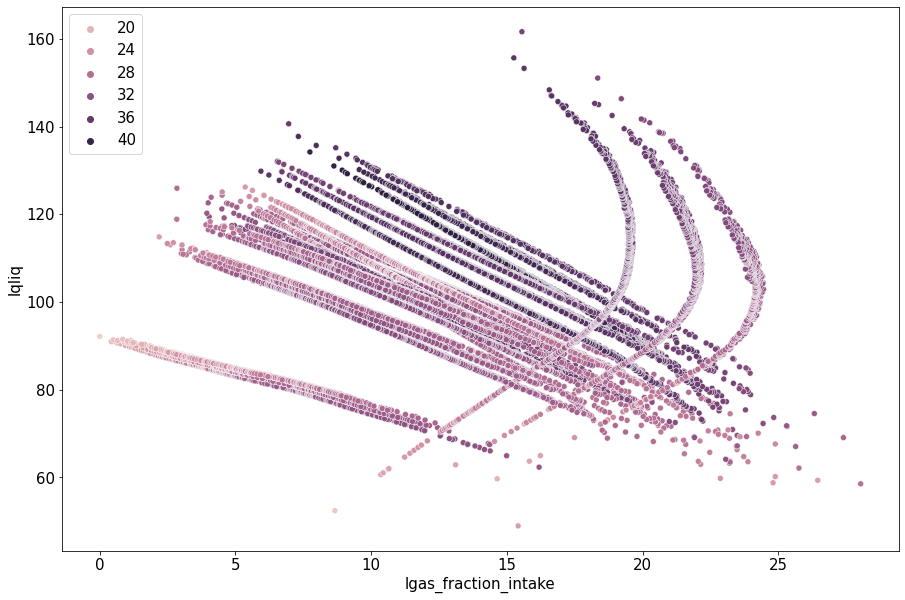

In [80]:
fig,ax = plt.subplots()
sns.scatterplot(data=big_df, hue='leff', x='lgas_fraction_intake', y='lqliq')
plt.legend(loc=2)
plt.show()

len = 23948


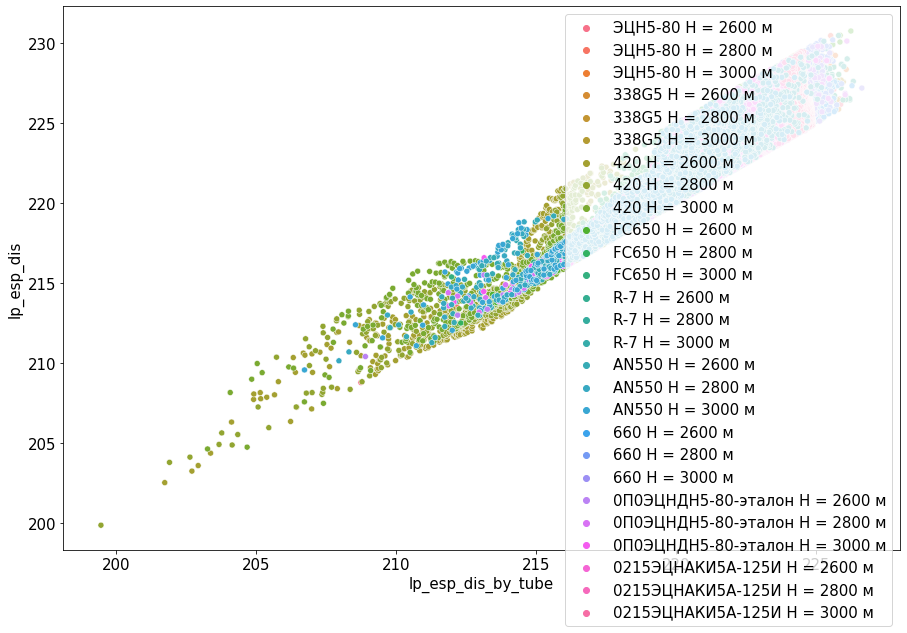

In [81]:
this_frac_from_big_df = big_df[abs(big_df['lp_esp_dis']-big_df['lp_esp_dis_by_tube']) > 0]
print(f"len = {this_frac_from_big_df.shape[0]}")
fig,ax = plt.subplots()
sns.scatterplot(data=this_frac_from_big_df,
                            
                            hue='super_id', x='lp_esp_dis_by_tube', y='lp_esp_dis')
plt.legend(loc=1)
plt.show()

len = 23948


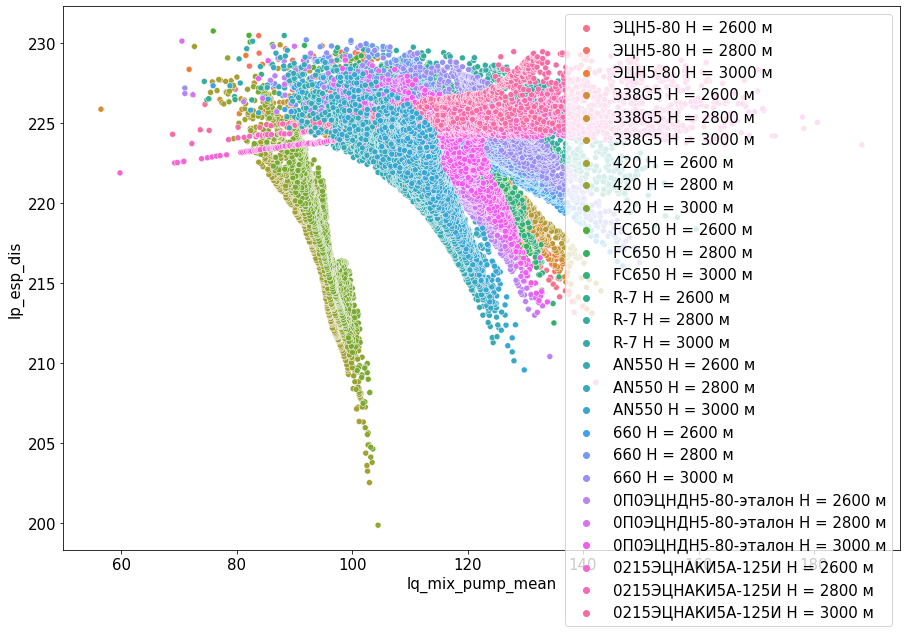

In [82]:
this_frac_from_big_df = big_df[abs(big_df['lp_esp_dis']-big_df['lp_esp_dis_by_tube']) > 0]
print(f"len = {this_frac_from_big_df.shape[0]}")
fig,ax = plt.subplots()
sns.scatterplot(data=this_frac_from_big_df,
                            
                            hue='super_id', x='lq_mix_pump_mean', y='lp_esp_dis')
plt.legend(loc=1)
plt.show()


len = 23948


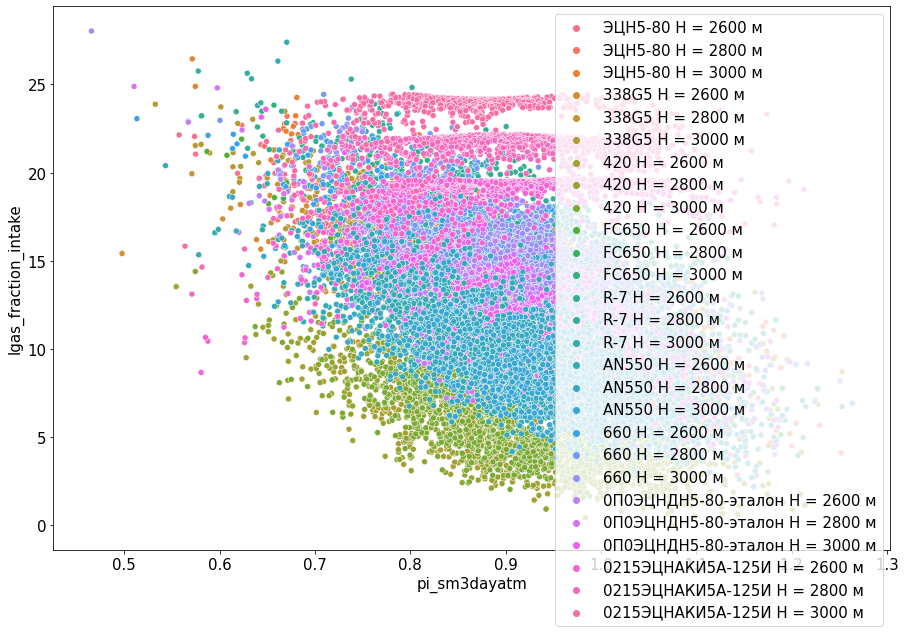

In [83]:
this_frac_from_big_df = big_df[abs(big_df['lp_esp_dis']-big_df['lp_esp_dis_by_tube']) > 0]
print(f"len = {this_frac_from_big_df.shape[0]}")
fig,ax = plt.subplots()
sns.scatterplot(data=this_frac_from_big_df,
                            
                            hue='super_id', x='pi_sm3dayatm', y='lgas_fraction_intake')
plt.legend(loc=1)
plt.show()

len = 23948


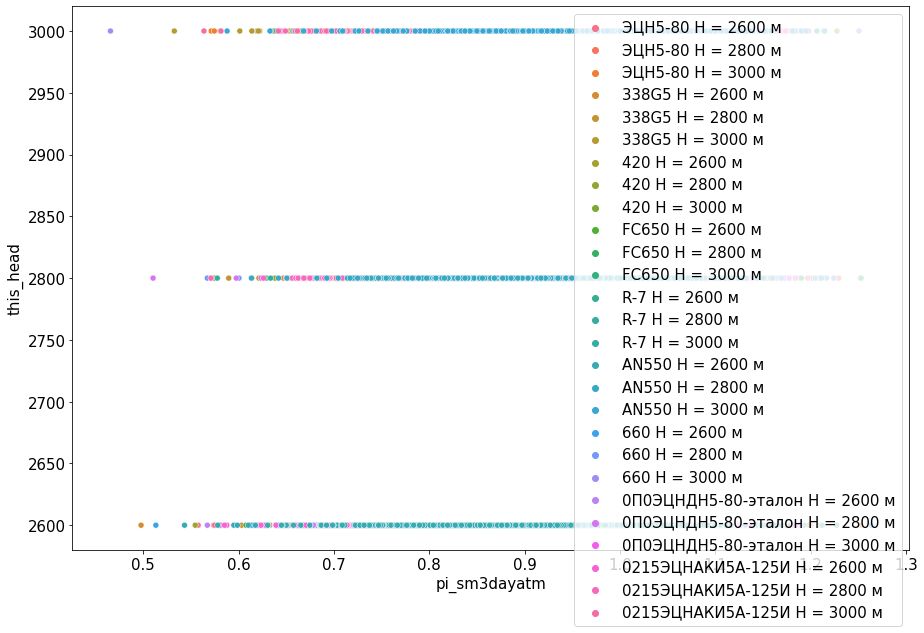

In [84]:
this_frac_from_big_df = big_df[abs(big_df['lp_esp_dis']-big_df['lp_esp_dis_by_tube']) > 0]
print(f"len = {this_frac_from_big_df.shape[0]}")
fig,ax = plt.subplots()
sns.scatterplot(data=this_frac_from_big_df,
                            
                            hue='super_id', x='pi_sm3dayatm', y='this_head')
plt.legend(loc=1)
plt.show()

len = 23948


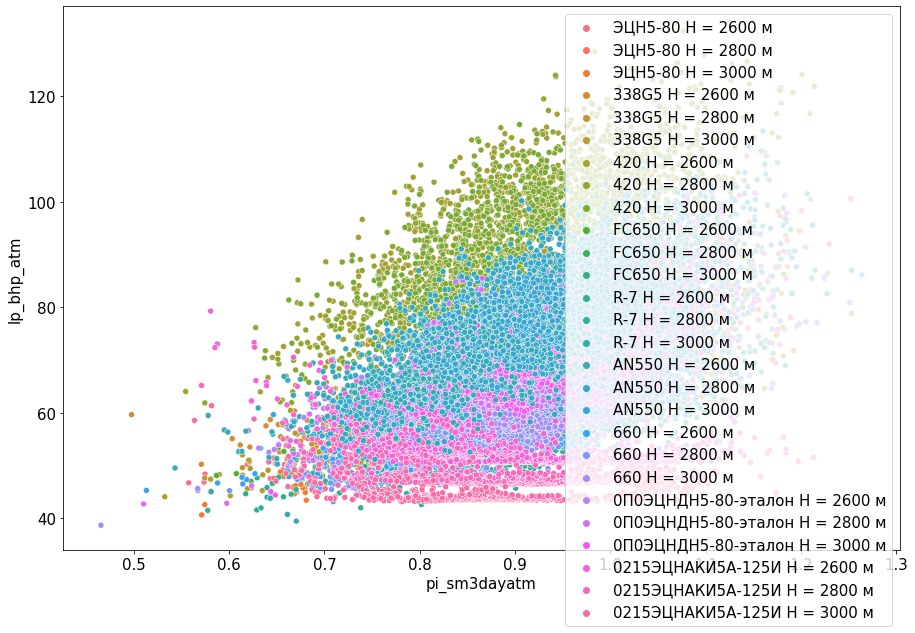

In [85]:
this_frac_from_big_df = big_df[abs(big_df['lp_esp_dis']-big_df['lp_esp_dis_by_tube']) > 0]
print(f"len = {this_frac_from_big_df.shape[0]}")
fig,ax = plt.subplots()
sns.scatterplot(data=this_frac_from_big_df,
                            
                            hue='super_id', x='pi_sm3dayatm', y='lp_bhp_atm')
plt.legend(loc=1)
plt.show()

len = 23948


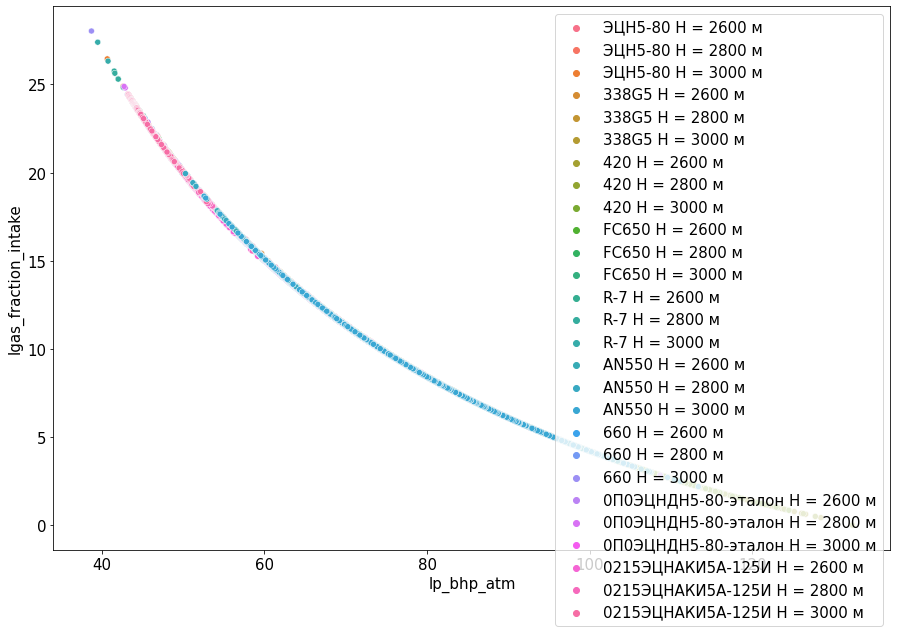

In [86]:
this_frac_from_big_df = big_df[abs(big_df['lp_esp_dis']-big_df['lp_esp_dis_by_tube']) > 0]
print(f"len = {this_frac_from_big_df.shape[0]}")
fig,ax = plt.subplots()
sns.scatterplot(data=this_frac_from_big_df,
                            
                            hue='super_id', x='lp_bhp_atm', y='lgas_fraction_intake')
plt.legend(loc=1)
plt.show()

len = 23948


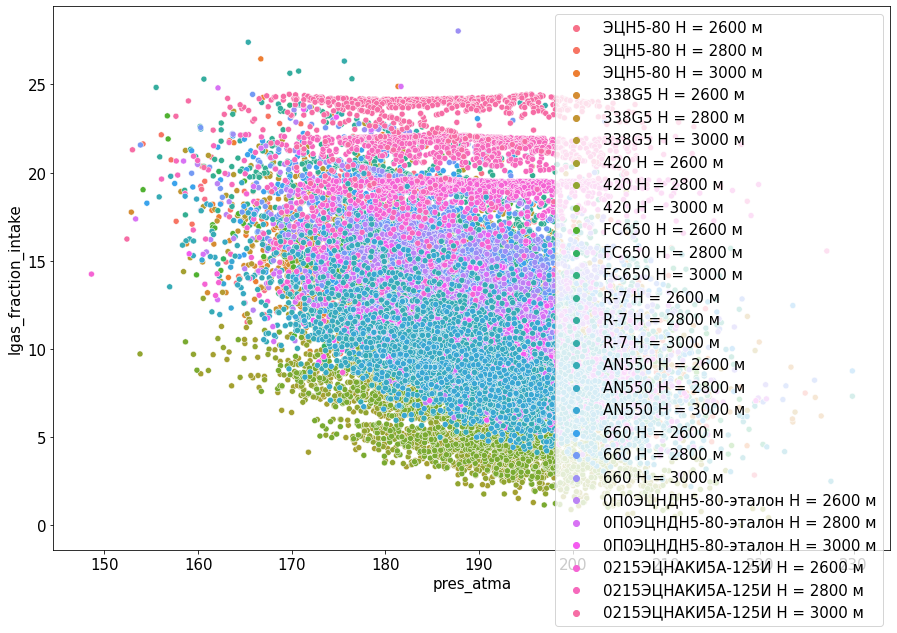

In [87]:
this_frac_from_big_df = big_df[abs(big_df['lp_esp_dis']-big_df['lp_esp_dis_by_tube']) > 0]
print(f"len = {this_frac_from_big_df.shape[0]}")
fig,ax = plt.subplots()
sns.scatterplot(data=this_frac_from_big_df,
                            
                            hue='super_id', x='pres_atma', y='lgas_fraction_intake')
plt.legend(loc=1)
plt.show()

len = 23948


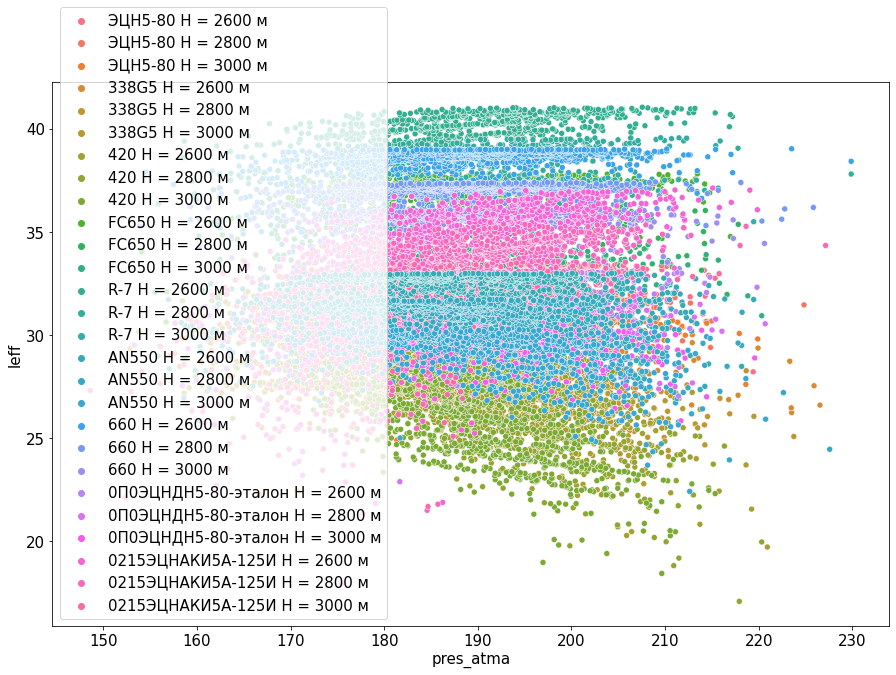

In [88]:
this_frac_from_big_df = big_df[abs(big_df['lp_esp_dis']-big_df['lp_esp_dis_by_tube']) > 0]
print(f"len = {this_frac_from_big_df.shape[0]}")
fig,ax = plt.subplots()
sns.scatterplot(data=this_frac_from_big_df,
                            
                            hue='super_id', x='pres_atma', y='leff')
plt.legend(loc=3)
plt.show()

len = 23948


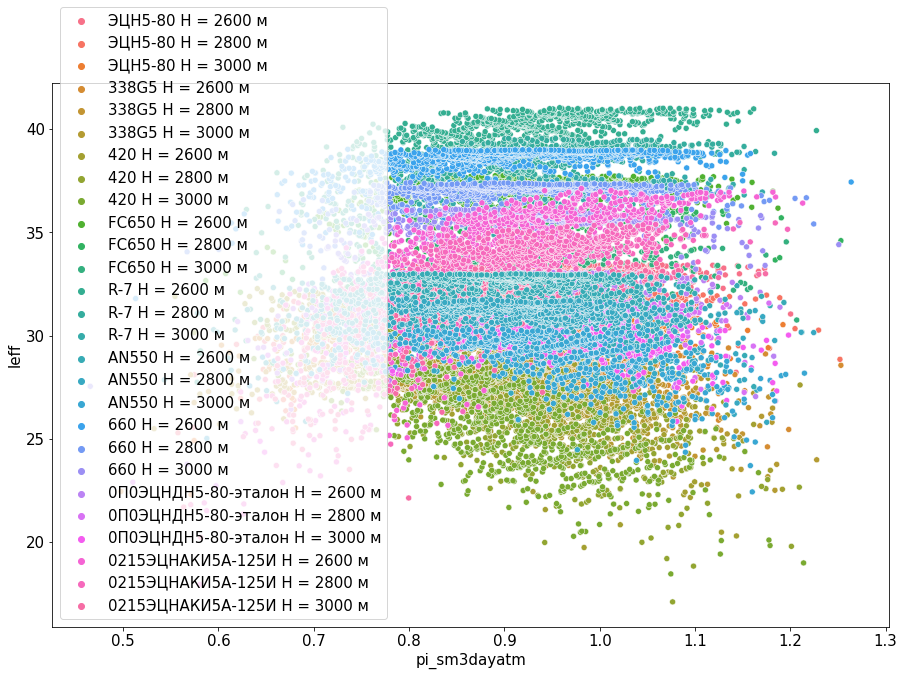

In [89]:
this_frac_from_big_df = big_df[abs(big_df['lp_esp_dis']-big_df['lp_esp_dis_by_tube']) > 0]
print(f"len = {this_frac_from_big_df.shape[0]}")
fig,ax = plt.subplots()
sns.scatterplot(data=this_frac_from_big_df,
                            
                            hue='super_id', x='pi_sm3dayatm', y='leff')
plt.legend(loc=3)
plt.show()

In [90]:
this_frac_from_big_df['super_id'].unique()

array(['ЭЦН5-80 H = 2600 м', 'ЭЦН5-80 H = 2800 м', 'ЭЦН5-80 H = 3000 м',
       '338G5 H = 2600 м', '338G5 H = 2800 м', '338G5 H = 3000 м',
       '420 H = 2600 м', '420 H = 2800 м', '420 H = 3000 м',
       'FC650 H = 2600 м', 'FC650 H = 2800 м', 'FC650 H = 3000 м',
       'R-7 H = 2600 м', 'R-7 H = 2800 м', 'R-7 H = 3000 м',
       'AN550 H = 2600 м', 'AN550 H = 2800 м', 'AN550 H = 3000 м',
       '660 H = 2600 м', '660 H = 2800 м', '660 H = 3000 м',
       '0П0ЭЦНДН5-80-эталон H = 2600 м', '0П0ЭЦНДН5-80-эталон H = 2800 м',
       '0П0ЭЦНДН5-80-эталон H = 3000 м', '0215ЭЦНАКИ5А-125И H = 2600 м',
       '0215ЭЦНАКИ5А-125И H = 2800 м', '0215ЭЦНАКИ5А-125И H = 3000 м'],
      dtype=object)

In [91]:
this_super_id = this_frac_from_big_df['super_id'].unique()

len = 1000


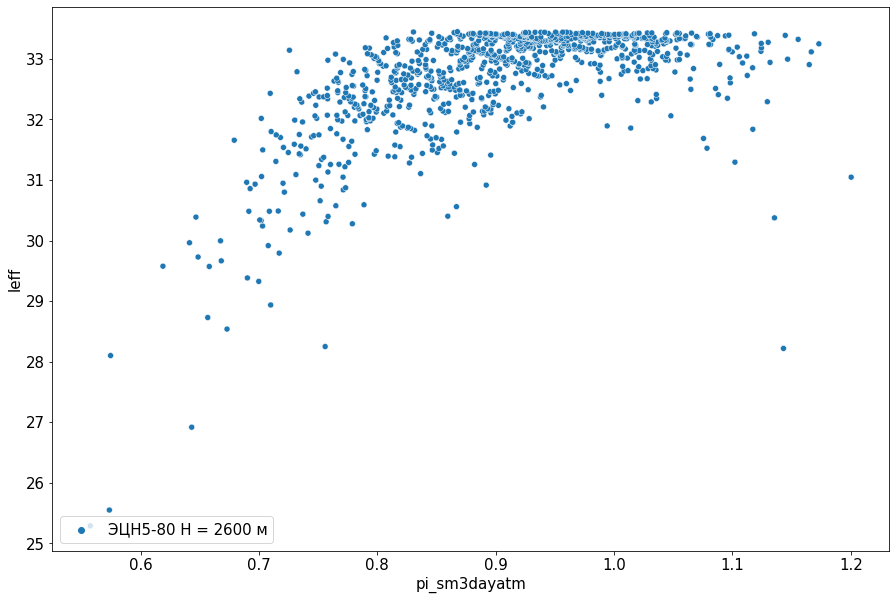

In [92]:
this_frac_from_big_df = big_df[abs(big_df['lp_esp_dis']-big_df['lp_esp_dis_by_tube']) > 0]
this_frac_from_big_df  = this_frac_from_big_df[this_frac_from_big_df['super_id'] ==this_frac_from_big_df['super_id'].unique()[0] ]
print(f"len = {this_frac_from_big_df.shape[0]}")
fig,ax = plt.subplots()
sns.scatterplot(data=this_frac_from_big_df,
                            
                            hue='super_id', x='pi_sm3dayatm', y='leff')
plt.legend(loc=3)
plt.show()

len = 23948


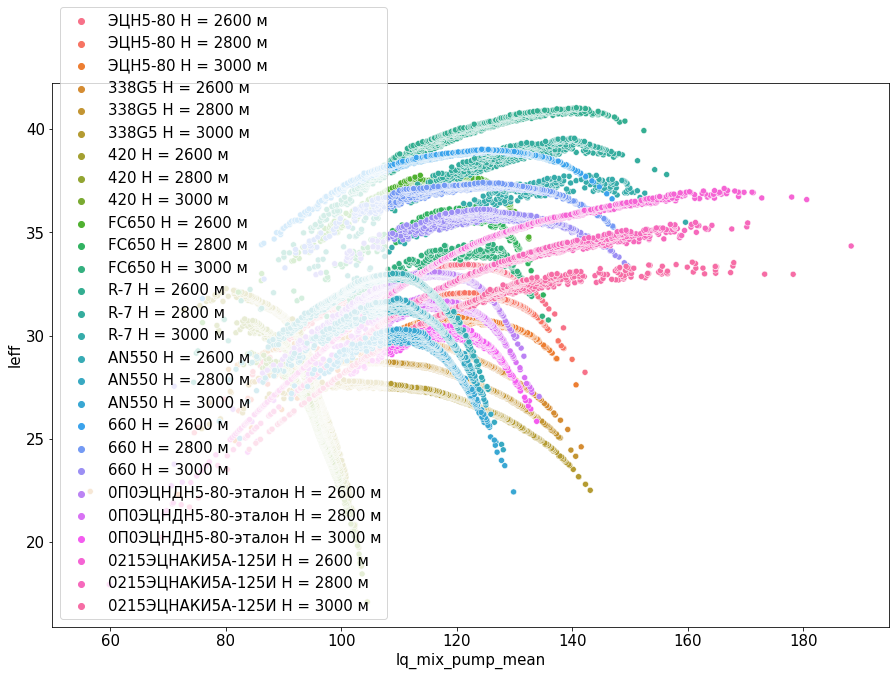

In [93]:
this_frac_from_big_df = big_df[abs(big_df['lp_esp_dis']-big_df['lp_esp_dis_by_tube']) > 0]
this_frac_from_big_df['error'] = abs(big_df['lp_esp_dis']-big_df['lp_esp_dis_by_tube'])
print(f"len = {this_frac_from_big_df.shape[0]}")
fig,ax = plt.subplots()
sns.scatterplot(data=this_frac_from_big_df,
                            
                            hue='super_id', x='lq_mix_pump_mean', y='leff')
plt.legend(loc=3)
plt.show()

len = 23948


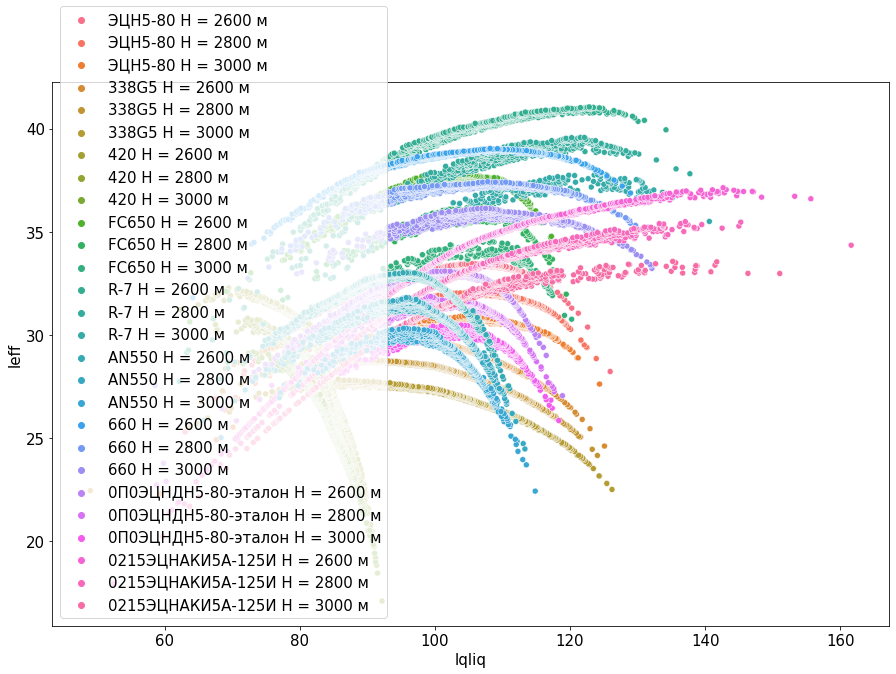

In [94]:
this_frac_from_big_df = big_df[abs(big_df['lp_esp_dis']-big_df['lp_esp_dis_by_tube']) > 0]
this_frac_from_big_df['error'] = abs(big_df['lp_esp_dis']-big_df['lp_esp_dis_by_tube'])
print(f"len = {this_frac_from_big_df.shape[0]}")
fig,ax = plt.subplots()
sns.scatterplot(data=this_frac_from_big_df,
                            
                            hue='super_id', x='lqliq', y='leff')
plt.legend(loc=3)
plt.show()

len = 23948


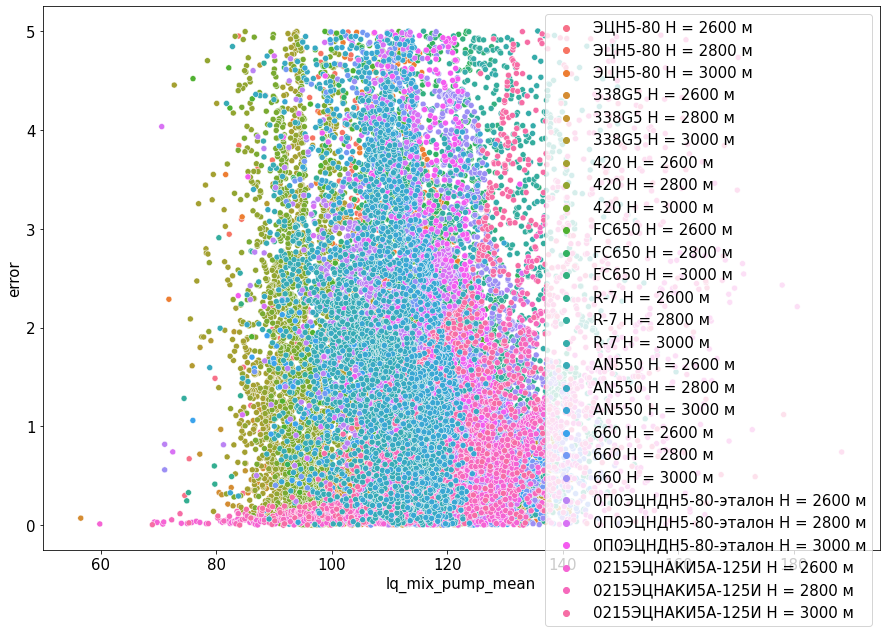

In [95]:
this_frac_from_big_df = big_df[abs(big_df['lp_esp_dis']-big_df['lp_esp_dis_by_tube']) > 0]
this_frac_from_big_df['error'] = abs(big_df['lp_esp_dis']-big_df['lp_esp_dis_by_tube'])
print(f"len = {this_frac_from_big_df.shape[0]}")
fig,ax = plt.subplots()
sns.scatterplot(data=this_frac_from_big_df,
                            
                            hue='super_id', x='lq_mix_pump_mean', y='error')
plt.legend(loc=1)
plt.show()

In [96]:
this_frac_from_big_df.columns

Index(['lh_mes', 'lhead_esp', 'leff', 'lpower_esp', 'lqliq', 'lstatus',
       'lgas_fraction_intake', 'lp_bhp_atm', 'lp_esp_dis', 'lparams',
       'simnumber', 'lp_esp_dis_by_tube', 'lq_mix_pump_mean', 'lesp_df',
       'lcasing_pipe', 'ltube_pipe', 'this_id', 'this_head', 'this_name',
       'super_id', 'nodal_error_p_dis', 'pi_sm3dayatm', 'p_bhp_atm',
       'pres_atma', 'this_max_eff', 'k_degr_eff', 'eff_div_max_eff', 'error'],
      dtype='object')

In [97]:
list(big_df['super_id'].unique())

['ЭЦН5-80 H = 2600 м',
 'ЭЦН5-80 H = 2800 м',
 'ЭЦН5-80 H = 3000 м',
 '338G5 H = 2600 м',
 '338G5 H = 2800 м',
 '338G5 H = 3000 м',
 '420 H = 2600 м',
 '420 H = 2800 м',
 '420 H = 3000 м',
 'FC650 H = 2600 м',
 'FC650 H = 2800 м',
 'FC650 H = 3000 м',
 'R-7 H = 2600 м',
 'R-7 H = 2800 м',
 'R-7 H = 3000 м',
 'AN550 H = 2600 м',
 'AN550 H = 2800 м',
 'AN550 H = 3000 м',
 '660 H = 2600 м',
 '660 H = 2800 м',
 '660 H = 3000 м',
 '0П0ЭЦНДН5-80-эталон H = 2600 м',
 '0П0ЭЦНДН5-80-эталон H = 2800 м',
 '0П0ЭЦНДН5-80-эталон H = 3000 м',
 '0215ЭЦНАКИ5А-125И H = 2600 м',
 '0215ЭЦНАКИ5А-125И H = 2800 м',
 '0215ЭЦНАКИ5А-125И H = 3000 м']

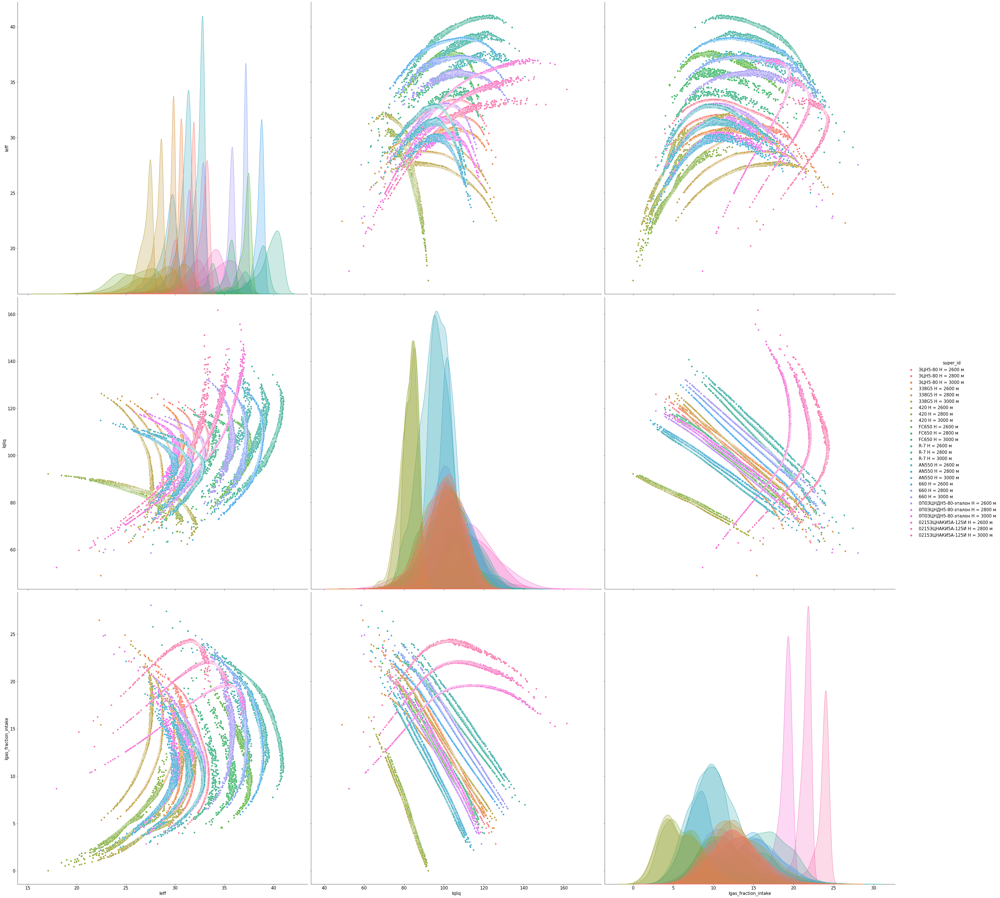

In [98]:
#sns.set_theme(style="ticks")
sns.pairplot(big_df[['leff', 'lqliq', 'lgas_fraction_intake', 'super_id']].copy(), hue="super_id", height=15)

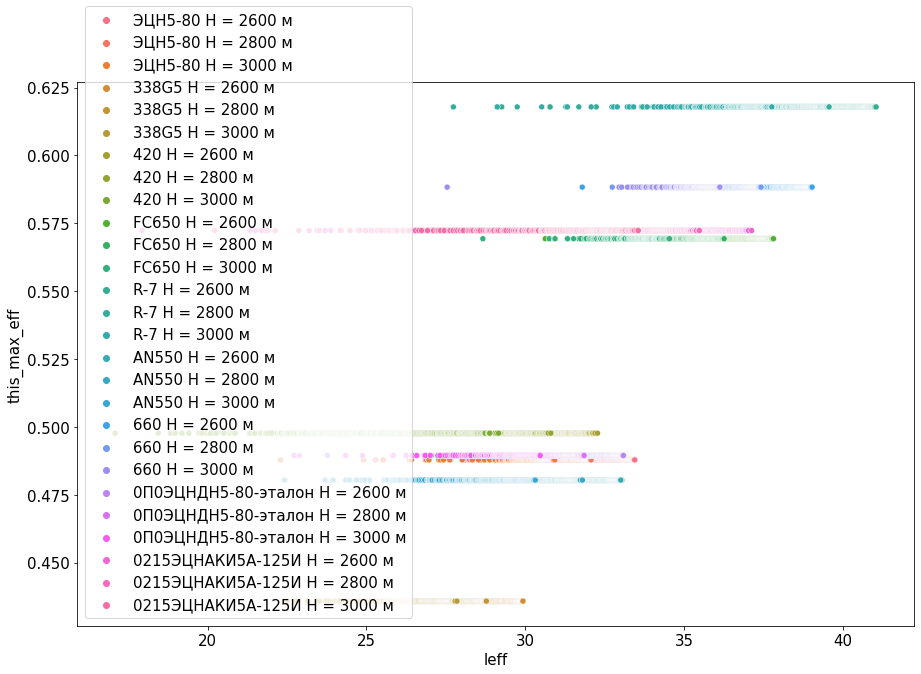

In [99]:
fig,ax = plt.subplots()
sns.scatterplot(data=this_frac_from_big_df,
                            
                            hue='super_id', x='leff', y='this_max_eff')
plt.legend(loc=3)
plt.show()

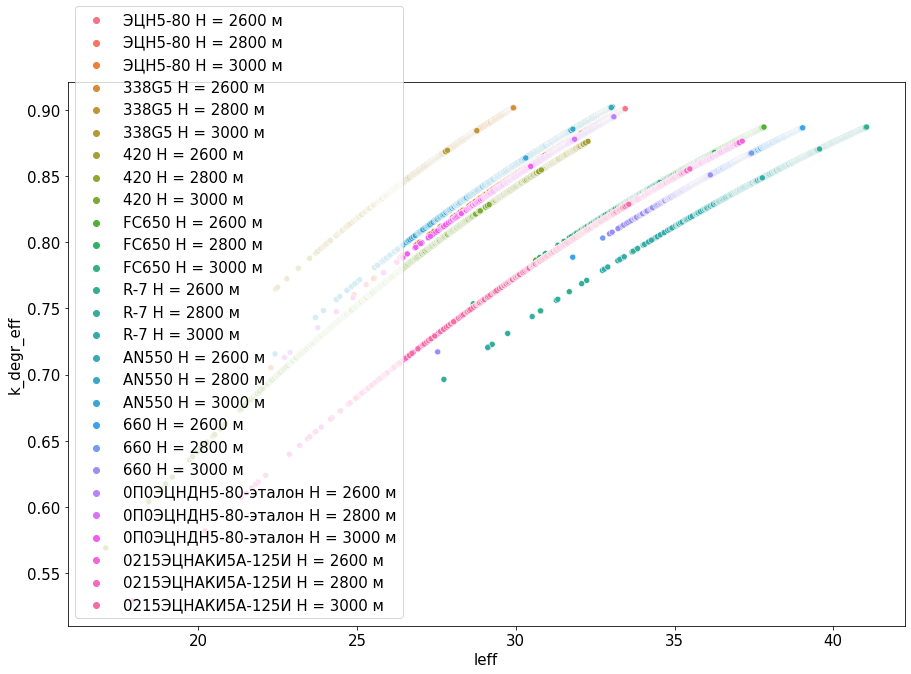

In [100]:
fig,ax = plt.subplots()
sns.scatterplot(data=this_frac_from_big_df,
                            
                            hue='super_id', x='leff', y='k_degr_eff')
plt.legend(loc=3)
plt.show()

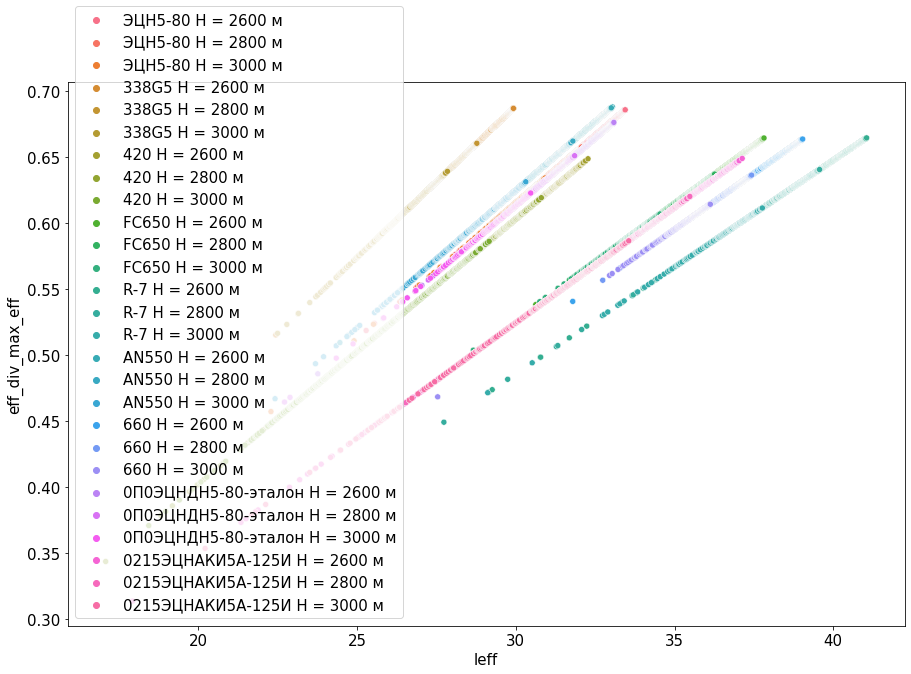

In [101]:
fig,ax = plt.subplots()
sns.scatterplot(data=this_frac_from_big_df,
                            
                            hue='super_id', x='leff', y='eff_div_max_eff')
plt.legend(loc=3)
plt.show()

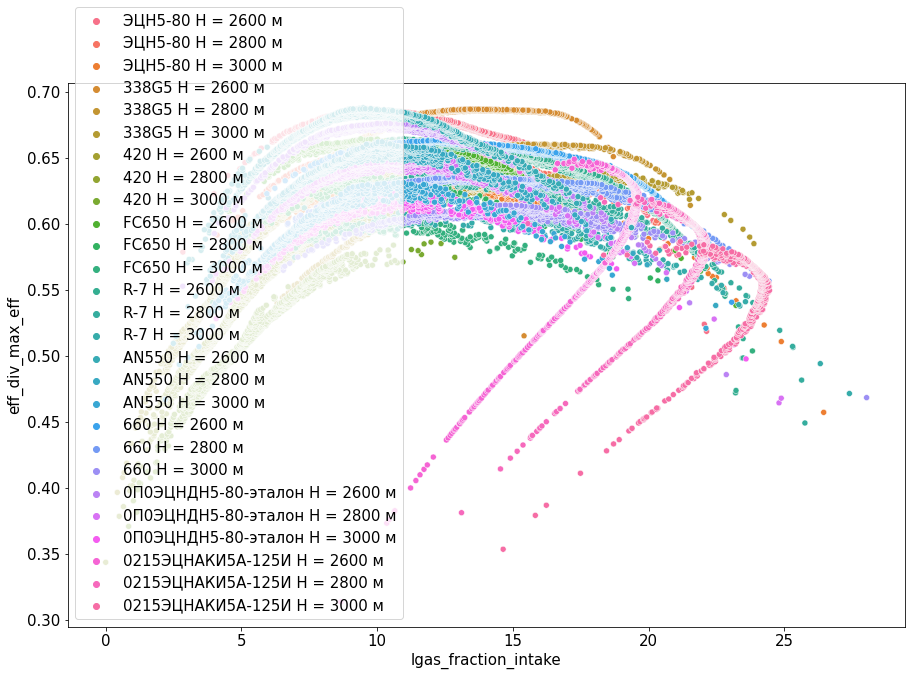

In [102]:
fig,ax = plt.subplots()
sns.scatterplot(data=this_frac_from_big_df,
                            
                            hue='super_id', x='lgas_fraction_intake', y='eff_div_max_eff')
plt.legend(loc=3)
plt.show()

# Проверка расчета

In [103]:
big_df['super_id'].unique()

array(['ЭЦН5-80 H = 2600 м', 'ЭЦН5-80 H = 2800 м', 'ЭЦН5-80 H = 3000 м',
       '338G5 H = 2600 м', '338G5 H = 2800 м', '338G5 H = 3000 м',
       '420 H = 2600 м', '420 H = 2800 м', '420 H = 3000 м',
       'FC650 H = 2600 м', 'FC650 H = 2800 м', 'FC650 H = 3000 м',
       'R-7 H = 2600 м', 'R-7 H = 2800 м', 'R-7 H = 3000 м',
       'AN550 H = 2600 м', 'AN550 H = 2800 м', 'AN550 H = 3000 м',
       '660 H = 2600 м', '660 H = 2800 м', '660 H = 3000 м',
       '0П0ЭЦНДН5-80-эталон H = 2600 м', '0П0ЭЦНДН5-80-эталон H = 2800 м',
       '0П0ЭЦНДН5-80-эталон H = 3000 м', '0215ЭЦНАКИ5А-125И H = 2600 м',
       '0215ЭЦНАКИ5А-125И H = 2800 м', '0215ЭЦНАКИ5А-125И H = 3000 м'],
      dtype=object)

In [104]:
pump_super_id = '226ЭЦНАКИ5-125 H = 1600 м'
pump_super_id =  '10.1ЭЦНД5А-100 H = 1600 м'
pump_super_id = 'R-7 H = 2600 м'
pump_super_id = '0215ЭЦНАКИ5А-125И H = 3000 м'
pump_super_id = 'ЭЦН5-80 H = 2800 м'

one_pump_df_for_check_all = big_df[big_df['super_id'] == pump_super_id].copy()
#one_pump_df_for_check_all = big_df.copy()

one_pump_df_for_check = one_pump_df_for_check_all
#one_pump_df_for_check   = one_pump_df_for_check_all[one_pump_df_for_check_all['leff'] == one_pump_df_for_check_all['leff'].max()]
#one_pump_df_for_check   = one_pump_df_for_check_all[abs(one_pump_df_for_check_all['lp_esp_dis'] - one_pump_df_for_check_all['lp_esp_dis_by_tube']) >10]

one_pump_df_for_check

,lh_mes,lhead_esp,leff,lpower_esp,lqliq,lstatus,lgas_fraction_intake,lp_bhp_atm,lp_esp_dis,lparams,...,this_head,this_name,super_id,nodal_error_p_dis,pi_sm3dayatm,p_bhp_atm,pres_atma,this_max_eff,k_degr_eff,eff_div_max_eff
830,2661,2543.178897,26.351345,68.300414,68.944452,1,23.197037,45.036397,228.568068,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,2.943868,0.670694,45.036397,167.486173,0.487819,0.788572,0.540187
756,2661,2542.284588,26.859853,68.474305,70.460874,1,22.783529,45.640444,229.376233,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,3.841735,0.679191,45.640444,168.710635,0.487819,0.798049,0.550611
527,2661,2532.276260,26.895842,68.460427,70.819057,1,22.767718,45.659438,228.615534,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,3.095349,0.668144,45.659438,170.970829,0.487819,0.798712,0.551348
551,2661,2553.371871,26.958133,68.537677,70.472478,1,22.683668,45.793557,230.470265,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,4.948797,0.623266,45.793557,178.108757,0.487819,0.799856,0.552625
198,2661,2520.028868,27.647909,68.684958,73.364241,1,22.142655,46.596484,228.991915,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,3.619381,0.809304,46.596484,156.065309,0.487819,0.812308,0.566765
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
903,2661,2037.983122,32.065957,70.346821,106.590906,1,10.773512,71.706708,222.115293,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,1.300809,0.914656,71.706708,196.333034,0.487819,0.882579,0.657333
132,2661,2038.468511,32.066032,70.347747,106.568480,1,10.781989,71.679827,222.122811,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,1.302304,0.915291,71.679827,196.209671,0.487819,0.882580,0.657334
442,2661,2038.922522,32.066169,70.348622,106.547726,1,10.789803,71.655068,222.130290,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,1.304231,0.909842,71.655068,196.867533,0.487819,0.882582,0.657337
809,2661,2021.323044,32.068434,70.314796,107.381252,1,10.470039,72.680843,221.915103,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,1.328616,0.898979,72.680843,199.900463,0.487819,0.882614,0.657383


In [105]:
one_pump_df_for_check

,lh_mes,lhead_esp,leff,lpower_esp,lqliq,lstatus,lgas_fraction_intake,lp_bhp_atm,lp_esp_dis,lparams,...,this_head,this_name,super_id,nodal_error_p_dis,pi_sm3dayatm,p_bhp_atm,pres_atma,this_max_eff,k_degr_eff,eff_div_max_eff
830,2661,2543.178897,26.351345,68.300414,68.944452,1,23.197037,45.036397,228.568068,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,2.943868,0.670694,45.036397,167.486173,0.487819,0.788572,0.540187
756,2661,2542.284588,26.859853,68.474305,70.460874,1,22.783529,45.640444,229.376233,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,3.841735,0.679191,45.640444,168.710635,0.487819,0.798049,0.550611
527,2661,2532.276260,26.895842,68.460427,70.819057,1,22.767718,45.659438,228.615534,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,3.095349,0.668144,45.659438,170.970829,0.487819,0.798712,0.551348
551,2661,2553.371871,26.958133,68.537677,70.472478,1,22.683668,45.793557,230.470265,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,4.948797,0.623266,45.793557,178.108757,0.487819,0.799856,0.552625
198,2661,2520.028868,27.647909,68.684958,73.364241,1,22.142655,46.596484,228.991915,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,3.619381,0.809304,46.596484,156.065309,0.487819,0.812308,0.566765
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
903,2661,2037.983122,32.065957,70.346821,106.590906,1,10.773512,71.706708,222.115293,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,1.300809,0.914656,71.706708,196.333034,0.487819,0.882579,0.657333
132,2661,2038.468511,32.066032,70.347747,106.568480,1,10.781989,71.679827,222.122811,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,1.302304,0.915291,71.679827,196.209671,0.487819,0.882580,0.657334
442,2661,2038.922522,32.066169,70.348622,106.547726,1,10.789803,71.655068,222.130290,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,1.304231,0.909842,71.655068,196.867533,0.487819,0.882582,0.657337
809,2661,2021.323044,32.068434,70.314796,107.381252,1,10.470039,72.680843,221.915103,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,1.328616,0.898979,72.680843,199.900463,0.487819,0.882614,0.657383


In [106]:
one_case = one_pump_df_for_check.iloc[0]
one_case

lh_mes                                                               2661
lhead_esp                                                         2543.18
leff                                                              26.3513
lpower_esp                                                        68.3004
lqliq                                                             68.9445
lstatus                                                                 1
lgas_fraction_intake                                               23.197
lp_bhp_atm                                                        45.0364
lp_esp_dis                                                        228.568
lparams                 {"gamma_gas": 0.7, "gamma_oil": 0.844, "gamma_...
simnumber                                                             830
lp_esp_dis_by_tube                                                225.624
lq_mix_pump_mean                                                  82.2176
lesp_df                 {"0":{"0":228.

In [107]:
json.loads(one_case['lesp_df'])

{'0': {'0': 228.5680681589,
  '1': 'p_dis_atma',
  '2': 'n_stage',
  '3': 0.0,
  '4': 31.7894736842,
  '5': 63.5789473684,
  '6': 95.3684210526,
  '7': 127.1578947368,
  '8': 158.9473684211,
  '9': 190.7368421053,
  '10': 222.5263157895,
  '11': 254.3157894737,
  '12': 286.1052631579,
  '13': 317.8947368421,
  '14': 349.6842105263,
  '15': 381.4736842105,
  '16': 413.2631578947,
  '17': 445.0526315789,
  '18': 476.8421052632,
  '19': 508.6315789474,
  '20': 540.4210526316,
  '21': 572.2105263158,
  '22': 604.0},
 '1': {'0': 37.1686737801,
  '1': 'p_int_atma',
  '2': 'length_m',
  '3': 1021.14,
  '4': 1020.0273684211,
  '5': 1018.9147368421,
  '6': 1017.8021052632,
  '7': 1016.6894736842,
  '8': 1015.5768421053,
  '9': 1014.4642105263,
  '10': 1013.3515789474,
  '11': 1012.2389473684,
  '12': 1011.1263157895,
  '13': 1010.0136842105,
  '14': 1008.9010526316,
  '15': 1007.7884210526,
  '16': 1006.6757894737,
  '17': 1005.5631578947,
  '18': 1004.4505263158,
  '19': 1003.3378947368,
  '20

In [108]:
params = json.loads(one_case['lparams'])
params['n_dots_for_nodal'] = 20
params

{'gamma_gas': 0.7,
 'gamma_oil': 0.844,
 'gamma_wat': 1.014,
 'rsb_m3m3': 85.54,
 'rp_m3m3': 85.54,
 'pb_atma': 123,
 't_res_C': 86,
 'bob_m3m3': 1.166,
 'muob_cP': 1.01,
 'PVTcorr': 0,
 'ksep_fr': 0.8,
 'p_bhp_atm': 45.03639735331633,
 'p_wh_atm': 15,
 't_wh_c': 20,
 'h_list_m': 2776,
 'h_pump_m': 2661,
 'diam_list_mm_casing': 159,
 'diam_list_mm_tube': 67.8,
 'gas_fraction_intake_d': 0.2,
 'qliq_sm3day': 68.9444517307281,
 'n_dots_for_nodal': 20,
 'fw_perc': 22,
 'hydr_corr': 1,
 'temp_method': 2,
 'freq_Hz': 60,
 'pump_id': 1185,
 'num_stages': 604,
 'pi_sm3dayatm': 0.670694180244894,
 'pres_atma': 167.48617264497614,
 'calc_esp_new': 1,
 'esp_head_m': 2800,
 'ESP_gas_correct': 5}



UniflocVBA 7.28


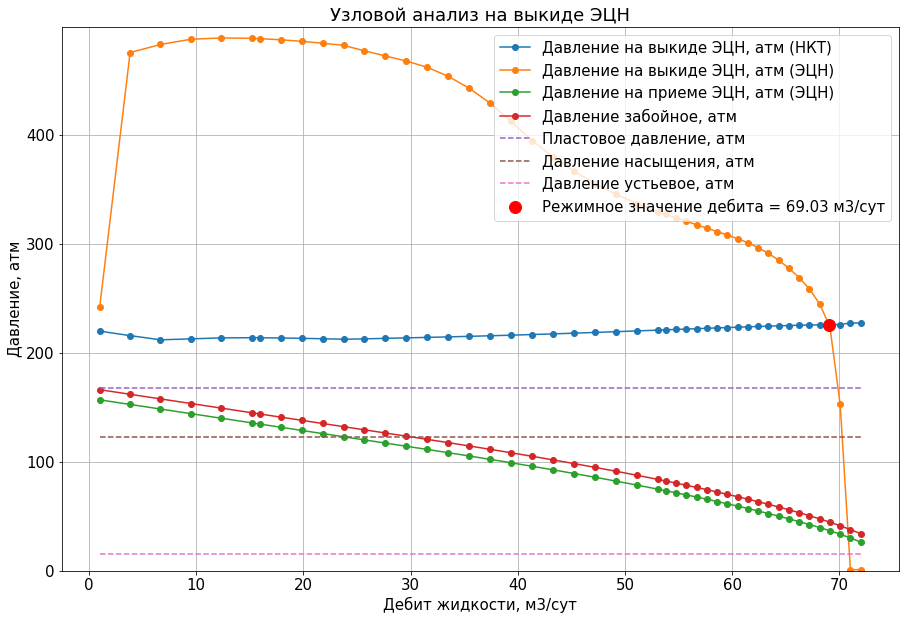

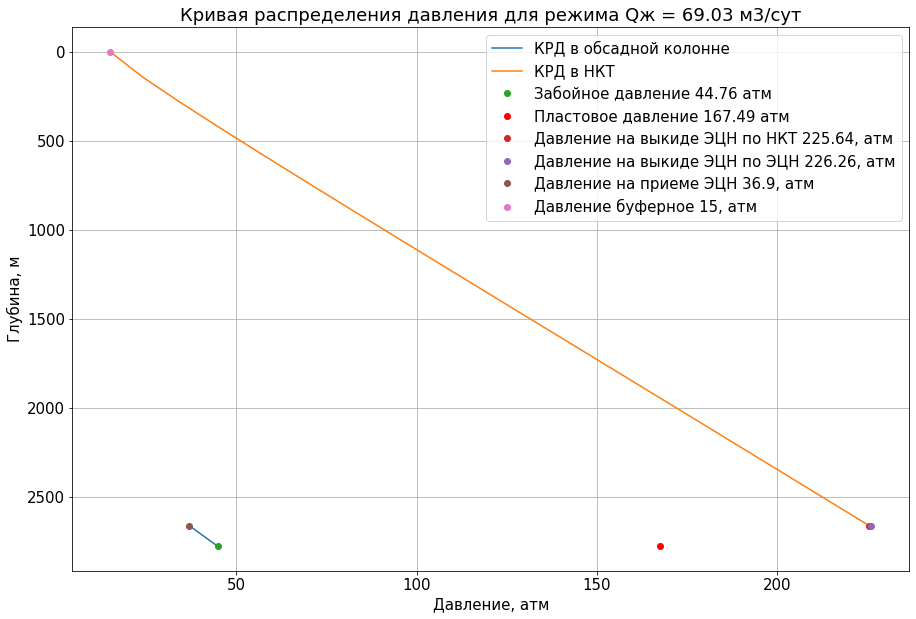

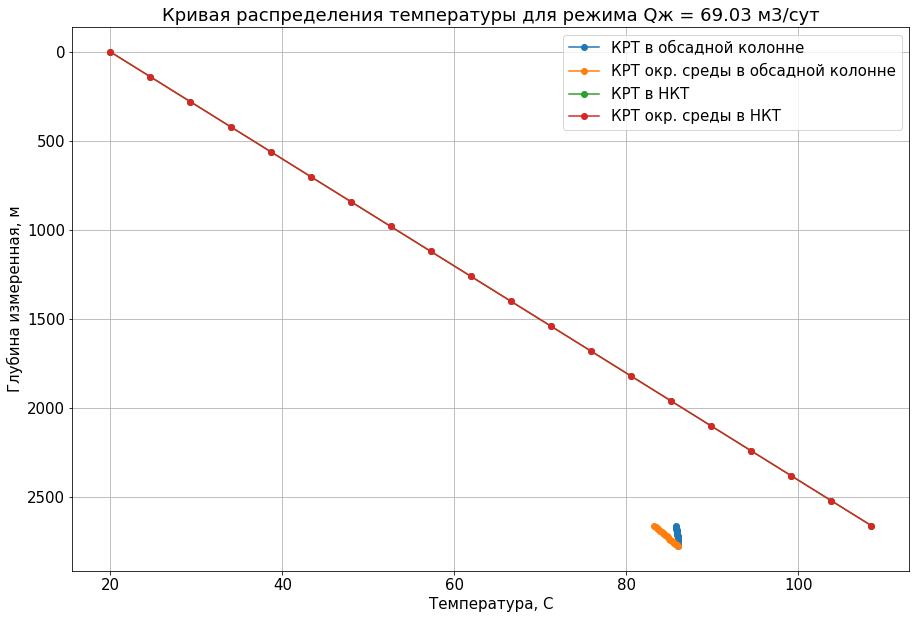

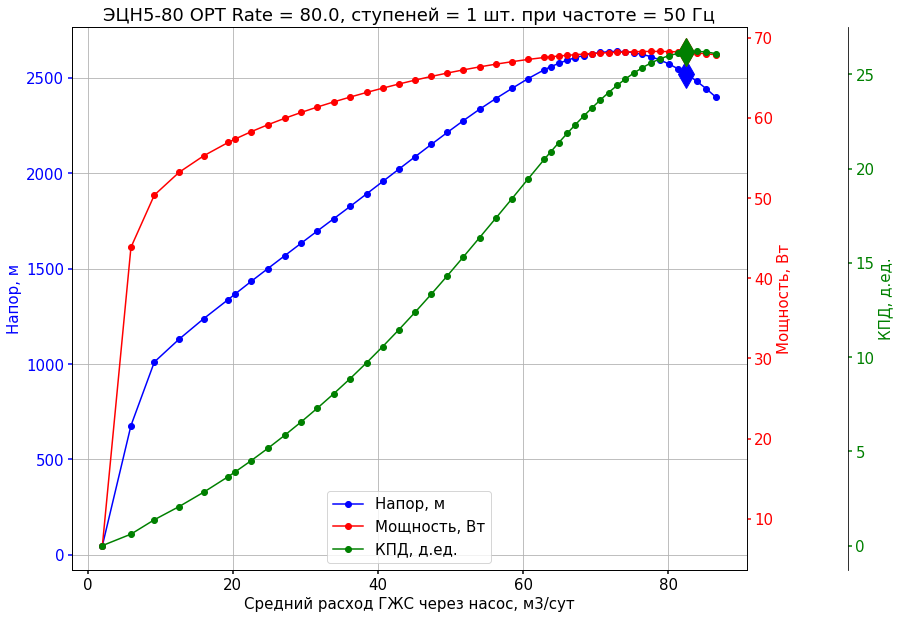

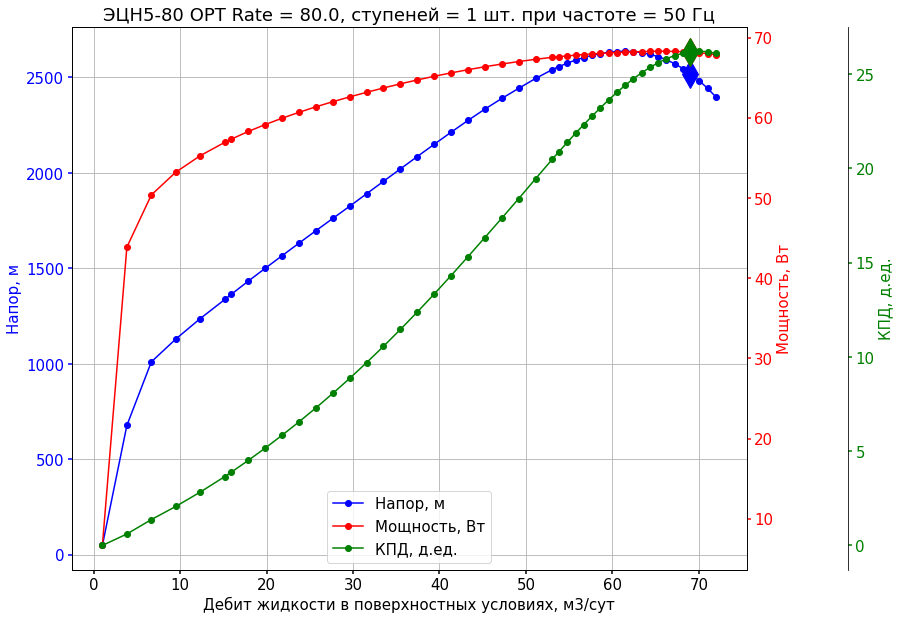

norm calculation sucessful


In [109]:
casing_pipe, tube_pipe, h_mes, head_esp, eff, power_esp, q_liq, status, gas_fraction_intake, p_bhp_atm, \
                            p_dis, p_esp_dis, json_params, q_mix_pump_mean, esp_df = well_model.calc_all(params, debug=1,
                                                                                              vba_version='7.28',
                                                                                             api=api, api_new=api_new)

In [110]:
p_dis, p_esp_dis

(225.63618668067346, 226.26332528433846)

In [111]:
esp_df

,0,1,2,3,4,5,6,7,8,9,10
0,226.263,36.9025,85.756,226.263,108.508,2519.07,26.18,17847.6,68172.7,0.729485,"[""set show_log=1 in param to show calc log""]"
1,p_dis_atma,p_int_atma,t_int_C,p_dis_atma,t_dis_C,head_m,"eff_ESP_d, %",power_fluid_W,power_ESP_W,gas_correction,log
2,n_stage,length_m,p_atma,t_C,"gas_fraction, %",qmix_rm3day,Power_fluid_W,Power_ESP_W,"eff fluid, %",mu_stage_cP,"gas correction, %"
3,0,1021.14,36.9025,85.756,23.3838,95.2598,0,0,0,1.22898,18.8956
4,31.7895,1020.03,39.9088,87.0299,22.2699,93.8724,333.011,3120.39,11.8835,1.24986,24.4469
5,63.5789,1018.91,44.067,88.2775,20.6259,91.8756,784.282,6305.11,15.378,1.28254,31.918
6,95.3684,1017.8,49.4659,89.5022,18.7852,89.7281,1356.77,9564.14,18.6495,1.32241,39.1867
7,127.158,1016.69,56.046,90.7111,16.8993,87.6249,2038.1,12900.5,21.1872,1.36821,45.1376
8,158.947,1015.58,63.6372,91.9126,15.1159,85.7244,2806.68,16310.8,23.1882,1.41822,50.0603
9,190.737,1014.46,72.1026,93.1106,13.4978,84.0717,3646.62,19788.1,24.6131,1.47206,53.7601


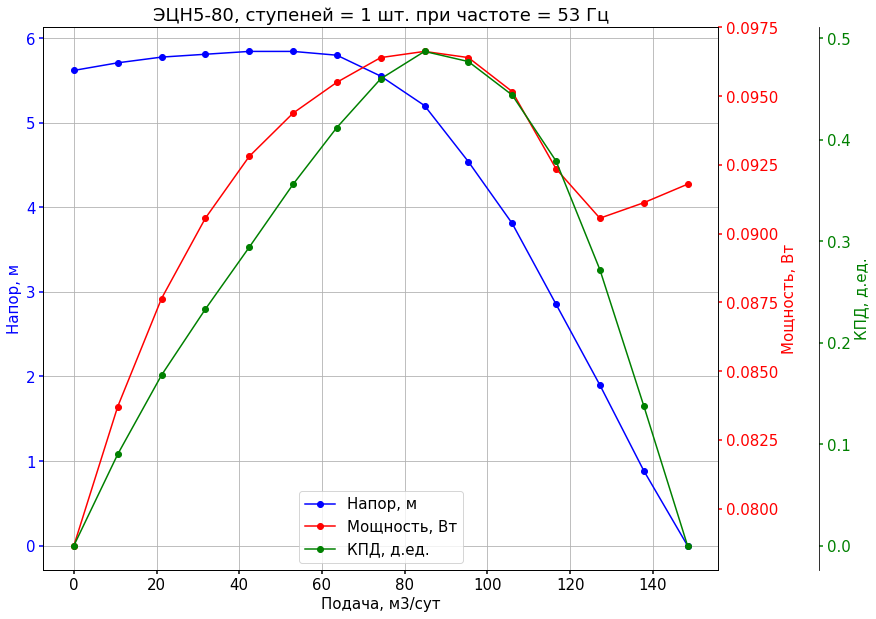

In [112]:
this_pump = db_df[db_df['ID'] == params['pump_id']].iloc[0]

q_arr = np.array(this_pump['rate_points'])
h_esp_arr = np.array(this_pump['head_points'])
power_esp_arr = np.array(this_pump['power_points']) 
efficiency_esp_arr = np.array(this_pump['eff_points'])
h_esp_arr_div_power_esp_arr = h_esp_arr/power_esp_arr
well_model.plot_pump_curve(q_arr,
    h_esp_arr,
    power_esp_arr,
    efficiency_esp_arr,
    z=1,
    esp_name= api.ESP_name(params['pump_id']),
    f=53,
    fnom=50,
    q_work=None,
    show=True,
    xlabel=None)

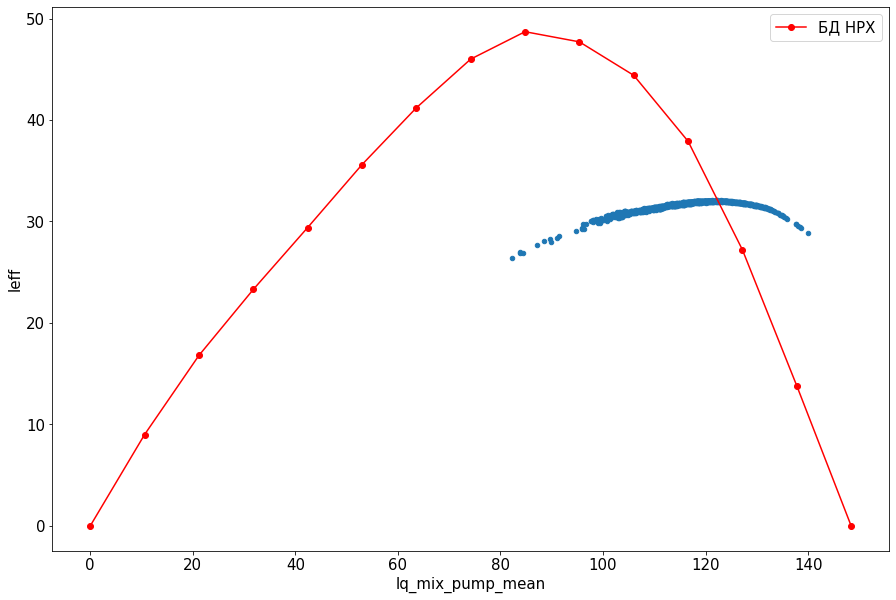

In [113]:
fig, ax = plt.subplots()

ax.plot(q_arr * 53/50,efficiency_esp_arr*100, 'ro-', label ='БД НРХ' )
one_pump_df_for_check_all.plot.scatter(x = 'lq_mix_pump_mean', y = 'leff', ax =ax
                                      )

ax.legend()


Text(0.5, 0, 'Доля газа на приеме')

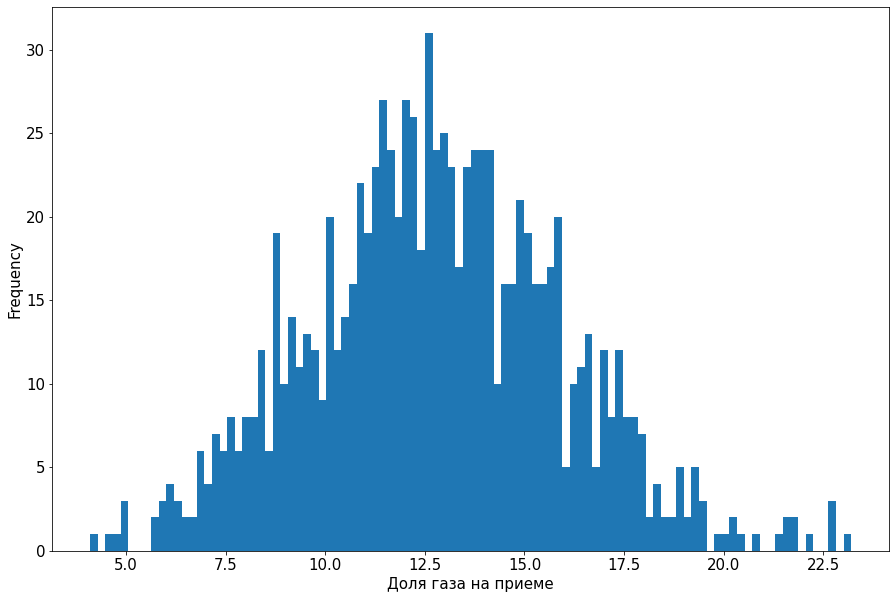

In [114]:
one_pump_df_for_check_all['lgas_fraction_intake'].plot.hist(bins=100)
plt.xlabel('Доля газа на приеме')

Text(0.5, 0, 'eff_div_max_eff')

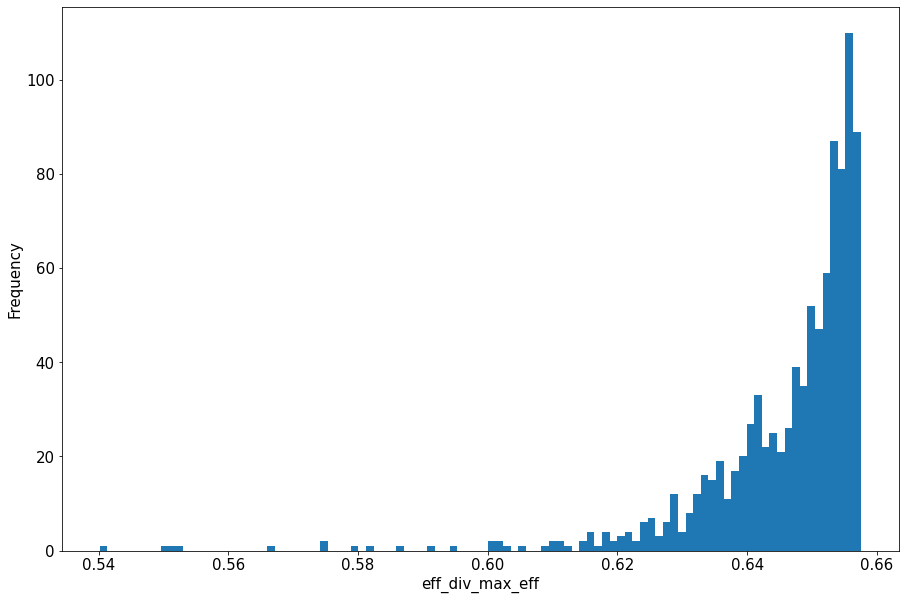

In [115]:
one_pump_df_for_check_all['eff_div_max_eff'].plot.hist(bins=100)
plt.xlabel('eff_div_max_eff')

In [116]:
one_pump_df_for_check_all

,lh_mes,lhead_esp,leff,lpower_esp,lqliq,lstatus,lgas_fraction_intake,lp_bhp_atm,lp_esp_dis,lparams,...,this_head,this_name,super_id,nodal_error_p_dis,pi_sm3dayatm,p_bhp_atm,pres_atma,this_max_eff,k_degr_eff,eff_div_max_eff
830,2661,2543.178897,26.351345,68.300414,68.944452,1,23.197037,45.036397,228.568068,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,2.943868,0.670694,45.036397,167.486173,0.487819,0.788572,0.540187
756,2661,2542.284588,26.859853,68.474305,70.460874,1,22.783529,45.640444,229.376233,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,3.841735,0.679191,45.640444,168.710635,0.487819,0.798049,0.550611
527,2661,2532.276260,26.895842,68.460427,70.819057,1,22.767718,45.659438,228.615534,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,3.095349,0.668144,45.659438,170.970829,0.487819,0.798712,0.551348
551,2661,2553.371871,26.958133,68.537677,70.472478,1,22.683668,45.793557,230.470265,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,4.948797,0.623266,45.793557,178.108757,0.487819,0.799856,0.552625
198,2661,2520.028868,27.647909,68.684958,73.364241,1,22.142655,46.596484,228.991915,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,3.619381,0.809304,46.596484,156.065309,0.487819,0.812308,0.566765
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
903,2661,2037.983122,32.065957,70.346821,106.590906,1,10.773512,71.706708,222.115293,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,1.300809,0.914656,71.706708,196.333034,0.487819,0.882579,0.657333
132,2661,2038.468511,32.066032,70.347747,106.568480,1,10.781989,71.679827,222.122811,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,1.302304,0.915291,71.679827,196.209671,0.487819,0.882580,0.657334
442,2661,2038.922522,32.066169,70.348622,106.547726,1,10.789803,71.655068,222.130290,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,1.304231,0.909842,71.655068,196.867533,0.487819,0.882582,0.657337
809,2661,2021.323044,32.068434,70.314796,107.381252,1,10.470039,72.680843,221.915103,"{""gamma_gas"": 0.7, ""gamma_oil"": 0.844, ""gamma_...",...,2800,ЭЦН5-80,ЭЦН5-80 H = 2800 м,1.328616,0.898979,72.680843,199.900463,0.487819,0.882614,0.657383


In [117]:
api.ESP_name(params['pump_id'])

'ЭЦН5-80'

In [118]:
api_new.ESP_name(params['pump_id'])

'ЭЦН5-80'

In [119]:
one_case['this_name']

'ЭЦН5-80'

In [120]:
eff

26.179998836081246

In [121]:
one_case['leff']

26.351345290996235

In [122]:
one_case

lh_mes                                                               2661
lhead_esp                                                         2543.18
leff                                                              26.3513
lpower_esp                                                        68.3004
lqliq                                                             68.9445
lstatus                                                                 1
lgas_fraction_intake                                               23.197
lp_bhp_atm                                                        45.0364
lp_esp_dis                                                        228.568
lparams                 {"gamma_gas": 0.7, "gamma_oil": 0.844, "gamma_...
simnumber                                                             830
lp_esp_dis_by_tube                                                225.624
lq_mix_pump_mean                                                  82.2176
lesp_df                 {"0":{"0":228.